# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

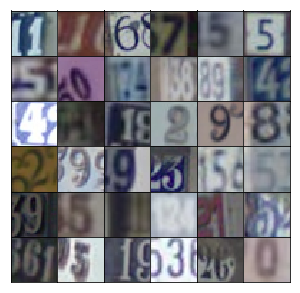

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        d1 = tf.layers.dense(z, 4*4*512)
        d1 = tf.reshape(d1, [-1, 4, 4, 512])
        d1 = tf.layers.batch_normalization(d1, training=training)
        d1 = tf.maximum(d1, tf.multiply(0.01, d1))

        # now 4 x 4 x 512
        
        c1 = tf.layers.conv2d_transpose(
            d1,
            filters=256,
            kernel_size=5,
            strides=2,
            padding='same',
            use_bias=False,
            activation=None)
        c1 = tf.layers.batch_normalization(c1, training=training)
        c1 = tf.maximum(c1, tf.multiply(alpha, c1))
        
        # now 8 x 8 x 256
        
        c2 = tf.layers.conv2d_transpose(
            c1,
            filters=128,
            kernel_size=5,
            strides=2,
            padding='same',
            use_bias=False,
            activation=None)
        c2 = tf.layers.batch_normalization(c2, training=training)
        c2 = tf.maximum(c2, tf.multiply(alpha, c2))

        # now 16 x 16 x 128
       
        logits = tf.layers.conv2d_transpose(
            c2,
            filters=output_dim,
            kernel_size=5,
            strides=2,
            padding='same',
            use_bias=False,
            activation=None)

        # Outputs 32 x 32 x output_dim
        
        out = tf.tanh(logits)

        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [20]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        
        training=True
        
        c1 = tf.layers.conv2d(x, 64, kernel_size=5, strides=2, padding='same')
        #works better without batch normalization in the first layer
        #c1 = tf.layers.batch_normalization(c1, training=training)
        c1 = tf.maximum(c1, c1 * alpha)
        # output 16x16x16
        
        c2 = tf.layers.conv2d(c1, 128, kernel_size=5, strides=2, padding='same')
        c2 = tf.layers.batch_normalization(c2, training=training)
        c2 = tf.maximum(c2, c2 * alpha)
        # output  8x8x32
        
        c3 = tf.layers.conv2d(c2, 256, kernel_size=5, strides=2, padding='same')
        c3 = tf.layers.batch_normalization(c3, training=training)
        c3 = tf.maximum(c3, c3 * alpha)
        # output is 4x4x64
        
        fc = tf.reshape(c3, [-1, 4*4*256])
        logits = tf.layers.dense(fc, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [21]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [22]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [23]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [24]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [25]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            b = 0
            for x, y in dataset.batches(batch_size):
                b += 1
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Batch {}   ".format(b),
                          "Epoch {}/{}   ".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [26]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Batch 10    Epoch 1/25    Discriminator Loss: 1.1123... Generator Loss: 0.9990
Batch 20    Epoch 1/25    Discriminator Loss: 1.5174... Generator Loss: 0.3538
Batch 30    Epoch 1/25    Discriminator Loss: 0.3347... Generator Loss: 1.5696
Batch 40    Epoch 1/25    Discriminator Loss: 0.1500... Generator Loss: 2.6334
Batch 50    Epoch 1/25    Discriminator Loss: 0.1768... Generator Loss: 2.6777
Batch 60    Epoch 1/25    Discriminator Loss: 0.1221... Generator Loss: 2.9356
Batch 70    Epoch 1/25    Discriminator Loss: 0.1448... Generator Loss: 2.4250
Batch 80    Epoch 1/25    Discriminator Loss: 0.2914... Generator Loss: 2.3768
Batch 90    Epoch 1/25    Discriminator Loss: 0.1186... Generator Loss: 3.0577
Batch 100    Epoch 1/25    Discriminator Loss: 0.1948... Generator Loss: 2.6131


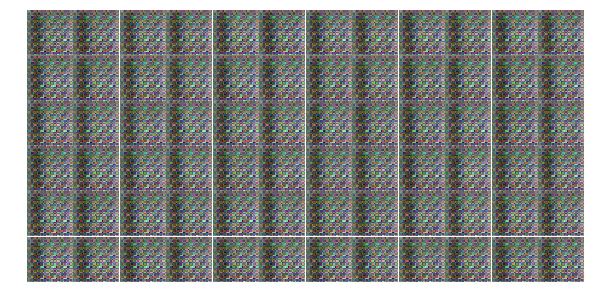

Batch 110    Epoch 1/25    Discriminator Loss: 0.1351... Generator Loss: 2.7559
Batch 120    Epoch 1/25    Discriminator Loss: 0.2280... Generator Loss: 2.8289
Batch 130    Epoch 1/25    Discriminator Loss: 0.1215... Generator Loss: 3.2246
Batch 140    Epoch 1/25    Discriminator Loss: 0.1593... Generator Loss: 2.9020
Batch 150    Epoch 1/25    Discriminator Loss: 0.2081... Generator Loss: 2.9123
Batch 160    Epoch 1/25    Discriminator Loss: 1.7584... Generator Loss: 1.0386
Batch 170    Epoch 1/25    Discriminator Loss: 0.6712... Generator Loss: 1.4655
Batch 180    Epoch 1/25    Discriminator Loss: 0.6139... Generator Loss: 1.6748
Batch 190    Epoch 1/25    Discriminator Loss: 0.7599... Generator Loss: 0.9919
Batch 200    Epoch 1/25    Discriminator Loss: 0.6089... Generator Loss: 1.3563


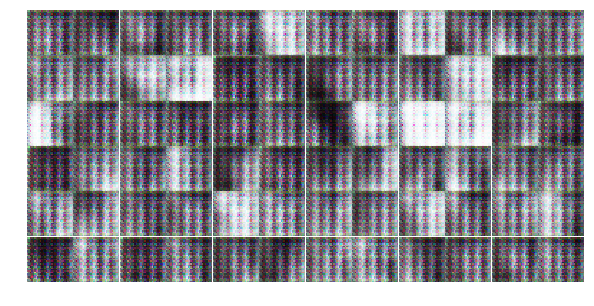

Batch 210    Epoch 1/25    Discriminator Loss: 0.4280... Generator Loss: 1.8636
Batch 220    Epoch 1/25    Discriminator Loss: 0.4640... Generator Loss: 2.5303
Batch 230    Epoch 1/25    Discriminator Loss: 0.4924... Generator Loss: 1.7262
Batch 240    Epoch 1/25    Discriminator Loss: 0.3728... Generator Loss: 3.0576
Batch 250    Epoch 1/25    Discriminator Loss: 0.3563... Generator Loss: 1.8048
Batch 260    Epoch 1/25    Discriminator Loss: 0.3401... Generator Loss: 2.0232
Batch 270    Epoch 1/25    Discriminator Loss: 1.9021... Generator Loss: 0.2558
Batch 280    Epoch 1/25    Discriminator Loss: 0.8056... Generator Loss: 1.4814
Batch 290    Epoch 1/25    Discriminator Loss: 0.4774... Generator Loss: 1.9467
Batch 300    Epoch 1/25    Discriminator Loss: 0.3125... Generator Loss: 3.1954


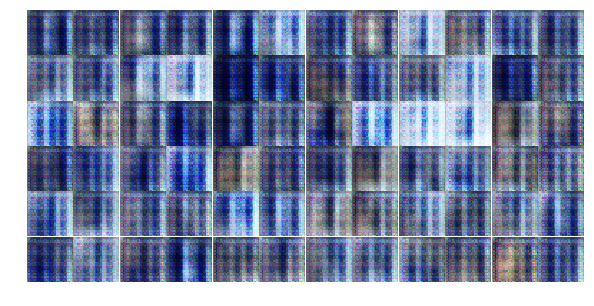

Batch 310    Epoch 1/25    Discriminator Loss: 0.2605... Generator Loss: 4.4966
Batch 320    Epoch 1/25    Discriminator Loss: 0.3860... Generator Loss: 1.8454
Batch 330    Epoch 1/25    Discriminator Loss: 0.2852... Generator Loss: 2.5147
Batch 340    Epoch 1/25    Discriminator Loss: 0.3849... Generator Loss: 3.2932
Batch 350    Epoch 1/25    Discriminator Loss: 0.7732... Generator Loss: 1.5428
Batch 360    Epoch 1/25    Discriminator Loss: 0.4007... Generator Loss: 1.7684
Batch 370    Epoch 1/25    Discriminator Loss: 0.9423... Generator Loss: 0.7266
Batch 380    Epoch 1/25    Discriminator Loss: 0.8662... Generator Loss: 1.5370
Batch 390    Epoch 1/25    Discriminator Loss: 0.5621... Generator Loss: 1.6954
Batch 400    Epoch 1/25    Discriminator Loss: 1.0867... Generator Loss: 1.7750


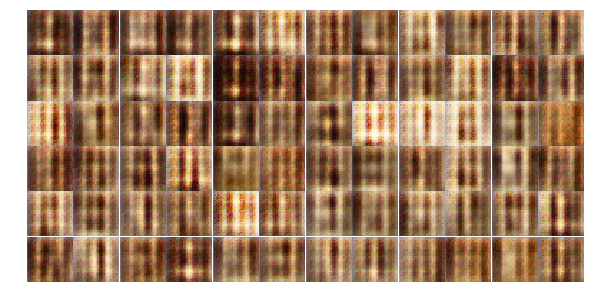

Batch 410    Epoch 1/25    Discriminator Loss: 0.9946... Generator Loss: 1.9223
Batch 420    Epoch 1/25    Discriminator Loss: 0.5115... Generator Loss: 1.5711
Batch 430    Epoch 1/25    Discriminator Loss: 0.4522... Generator Loss: 1.4994
Batch 440    Epoch 1/25    Discriminator Loss: 0.3360... Generator Loss: 3.3961
Batch 450    Epoch 1/25    Discriminator Loss: 1.2119... Generator Loss: 0.6217
Batch 460    Epoch 1/25    Discriminator Loss: 0.8493... Generator Loss: 1.0773
Batch 470    Epoch 1/25    Discriminator Loss: 0.2930... Generator Loss: 2.2678
Batch 480    Epoch 1/25    Discriminator Loss: 1.0518... Generator Loss: 1.3500
Batch 490    Epoch 1/25    Discriminator Loss: 0.8108... Generator Loss: 0.9485
Batch 500    Epoch 1/25    Discriminator Loss: 0.5783... Generator Loss: 1.9127


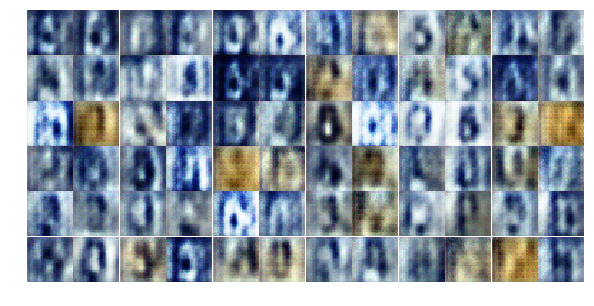

Batch 510    Epoch 1/25    Discriminator Loss: 0.8218... Generator Loss: 1.0633
Batch 520    Epoch 1/25    Discriminator Loss: 0.6742... Generator Loss: 1.3221
Batch 530    Epoch 1/25    Discriminator Loss: 0.6439... Generator Loss: 1.4375
Batch 540    Epoch 1/25    Discriminator Loss: 1.1879... Generator Loss: 0.5227
Batch 550    Epoch 1/25    Discriminator Loss: 0.7439... Generator Loss: 1.2032
Batch 560    Epoch 1/25    Discriminator Loss: 0.6948... Generator Loss: 1.3397
Batch 570    Epoch 1/25    Discriminator Loss: 0.7933... Generator Loss: 1.5027
Batch 7    Epoch 2/25    Discriminator Loss: 0.7999... Generator Loss: 1.3882
Batch 17    Epoch 2/25    Discriminator Loss: 0.8585... Generator Loss: 3.2950
Batch 27    Epoch 2/25    Discriminator Loss: 0.8046... Generator Loss: 1.3045


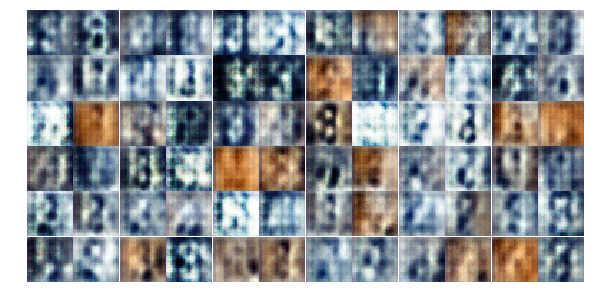

Batch 37    Epoch 2/25    Discriminator Loss: 0.8766... Generator Loss: 1.1044
Batch 47    Epoch 2/25    Discriminator Loss: 0.6164... Generator Loss: 1.4497
Batch 57    Epoch 2/25    Discriminator Loss: 0.6910... Generator Loss: 1.4750
Batch 67    Epoch 2/25    Discriminator Loss: 0.7330... Generator Loss: 1.2621
Batch 77    Epoch 2/25    Discriminator Loss: 1.2566... Generator Loss: 0.7652
Batch 87    Epoch 2/25    Discriminator Loss: 0.6296... Generator Loss: 1.5124
Batch 97    Epoch 2/25    Discriminator Loss: 0.7679... Generator Loss: 1.6680
Batch 107    Epoch 2/25    Discriminator Loss: 0.9007... Generator Loss: 0.9870
Batch 117    Epoch 2/25    Discriminator Loss: 1.1317... Generator Loss: 0.7297
Batch 127    Epoch 2/25    Discriminator Loss: 1.0948... Generator Loss: 0.9462


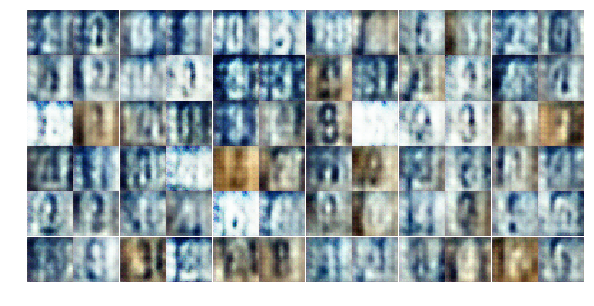

Batch 137    Epoch 2/25    Discriminator Loss: 0.5736... Generator Loss: 1.5726
Batch 147    Epoch 2/25    Discriminator Loss: 0.9675... Generator Loss: 1.1917
Batch 157    Epoch 2/25    Discriminator Loss: 1.4652... Generator Loss: 0.4316
Batch 167    Epoch 2/25    Discriminator Loss: 0.6902... Generator Loss: 1.4576
Batch 177    Epoch 2/25    Discriminator Loss: 0.7137... Generator Loss: 1.5683
Batch 187    Epoch 2/25    Discriminator Loss: 0.8448... Generator Loss: 1.3924
Batch 197    Epoch 2/25    Discriminator Loss: 1.4510... Generator Loss: 0.8175
Batch 207    Epoch 2/25    Discriminator Loss: 1.0219... Generator Loss: 0.9052
Batch 217    Epoch 2/25    Discriminator Loss: 0.8697... Generator Loss: 1.0999
Batch 227    Epoch 2/25    Discriminator Loss: 1.0572... Generator Loss: 0.9094


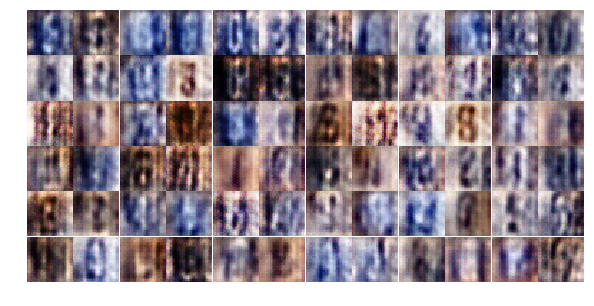

Batch 237    Epoch 2/25    Discriminator Loss: 0.9410... Generator Loss: 1.1569
Batch 247    Epoch 2/25    Discriminator Loss: 0.9674... Generator Loss: 1.2416
Batch 257    Epoch 2/25    Discriminator Loss: 0.8552... Generator Loss: 1.1965
Batch 267    Epoch 2/25    Discriminator Loss: 1.2781... Generator Loss: 1.0491
Batch 277    Epoch 2/25    Discriminator Loss: 1.1831... Generator Loss: 0.9631
Batch 287    Epoch 2/25    Discriminator Loss: 1.0452... Generator Loss: 1.1087
Batch 297    Epoch 2/25    Discriminator Loss: 1.2409... Generator Loss: 0.5858
Batch 307    Epoch 2/25    Discriminator Loss: 0.7771... Generator Loss: 1.2641
Batch 317    Epoch 2/25    Discriminator Loss: 1.2923... Generator Loss: 0.6626
Batch 327    Epoch 2/25    Discriminator Loss: 1.2504... Generator Loss: 0.8219


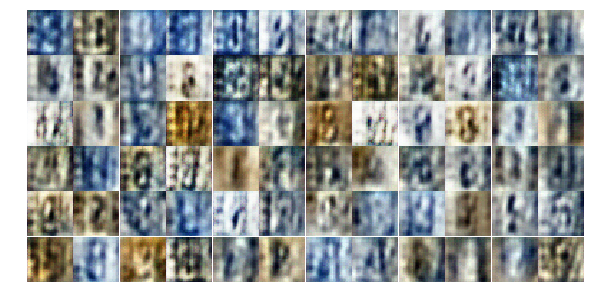

Batch 337    Epoch 2/25    Discriminator Loss: 1.0389... Generator Loss: 1.0467
Batch 347    Epoch 2/25    Discriminator Loss: 1.1119... Generator Loss: 0.9591
Batch 357    Epoch 2/25    Discriminator Loss: 1.3540... Generator Loss: 0.7588
Batch 367    Epoch 2/25    Discriminator Loss: 0.9081... Generator Loss: 1.0839
Batch 377    Epoch 2/25    Discriminator Loss: 0.8779... Generator Loss: 1.3863
Batch 387    Epoch 2/25    Discriminator Loss: 0.9309... Generator Loss: 1.0485
Batch 397    Epoch 2/25    Discriminator Loss: 1.0646... Generator Loss: 1.2873
Batch 407    Epoch 2/25    Discriminator Loss: 0.8141... Generator Loss: 1.2384
Batch 417    Epoch 2/25    Discriminator Loss: 1.0275... Generator Loss: 0.9449
Batch 427    Epoch 2/25    Discriminator Loss: 0.9903... Generator Loss: 0.9016


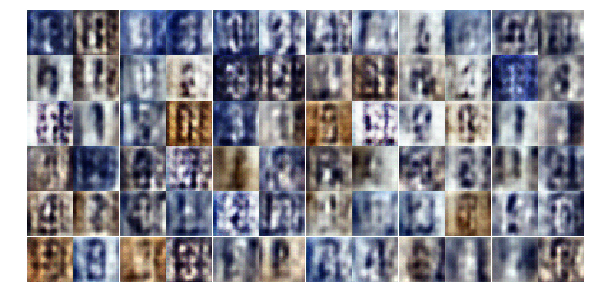

Batch 437    Epoch 2/25    Discriminator Loss: 1.0536... Generator Loss: 1.0652
Batch 447    Epoch 2/25    Discriminator Loss: 1.0827... Generator Loss: 0.9560
Batch 457    Epoch 2/25    Discriminator Loss: 0.9549... Generator Loss: 0.8471
Batch 467    Epoch 2/25    Discriminator Loss: 0.9579... Generator Loss: 1.0925
Batch 477    Epoch 2/25    Discriminator Loss: 1.2512... Generator Loss: 0.7409
Batch 487    Epoch 2/25    Discriminator Loss: 1.1143... Generator Loss: 0.9299
Batch 497    Epoch 2/25    Discriminator Loss: 1.1485... Generator Loss: 1.1605
Batch 507    Epoch 2/25    Discriminator Loss: 0.9035... Generator Loss: 1.1106
Batch 517    Epoch 2/25    Discriminator Loss: 1.0426... Generator Loss: 1.2449
Batch 527    Epoch 2/25    Discriminator Loss: 1.0955... Generator Loss: 1.2340


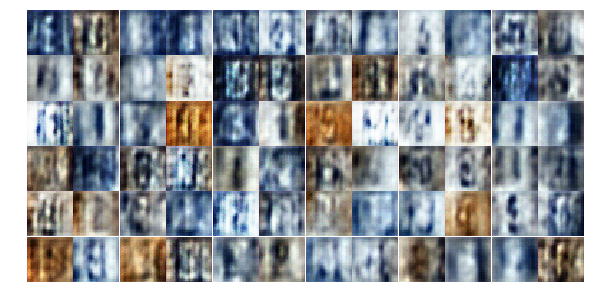

Batch 537    Epoch 2/25    Discriminator Loss: 0.8719... Generator Loss: 1.1272
Batch 547    Epoch 2/25    Discriminator Loss: 1.2539... Generator Loss: 0.6473
Batch 557    Epoch 2/25    Discriminator Loss: 1.2574... Generator Loss: 0.6995
Batch 567    Epoch 2/25    Discriminator Loss: 1.2481... Generator Loss: 0.7312
Batch 4    Epoch 3/25    Discriminator Loss: 0.9670... Generator Loss: 0.9252
Batch 14    Epoch 3/25    Discriminator Loss: 1.0052... Generator Loss: 0.9542
Batch 24    Epoch 3/25    Discriminator Loss: 1.0832... Generator Loss: 1.5014
Batch 34    Epoch 3/25    Discriminator Loss: 1.0372... Generator Loss: 1.0336
Batch 44    Epoch 3/25    Discriminator Loss: 0.9118... Generator Loss: 1.1290
Batch 54    Epoch 3/25    Discriminator Loss: 0.9378... Generator Loss: 0.8450


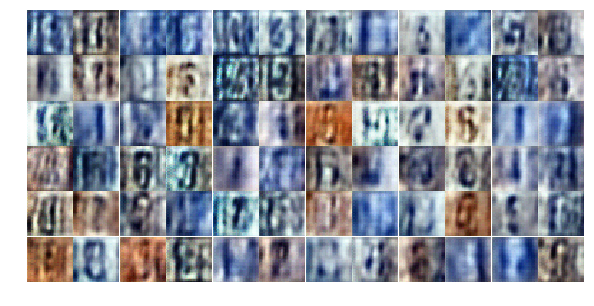

Batch 64    Epoch 3/25    Discriminator Loss: 0.7605... Generator Loss: 1.2816
Batch 74    Epoch 3/25    Discriminator Loss: 0.8844... Generator Loss: 1.0326
Batch 84    Epoch 3/25    Discriminator Loss: 0.8925... Generator Loss: 1.0644
Batch 94    Epoch 3/25    Discriminator Loss: 0.7484... Generator Loss: 1.4204
Batch 104    Epoch 3/25    Discriminator Loss: 0.8189... Generator Loss: 1.3457
Batch 114    Epoch 3/25    Discriminator Loss: 0.8023... Generator Loss: 1.0698
Batch 124    Epoch 3/25    Discriminator Loss: 0.8205... Generator Loss: 1.5597
Batch 134    Epoch 3/25    Discriminator Loss: 0.6623... Generator Loss: 1.2832
Batch 144    Epoch 3/25    Discriminator Loss: 1.0887... Generator Loss: 2.0294
Batch 154    Epoch 3/25    Discriminator Loss: 0.8588... Generator Loss: 1.3295


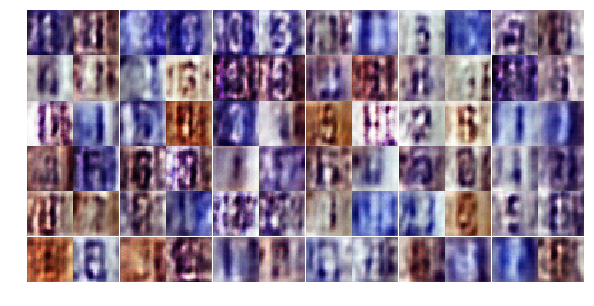

Batch 164    Epoch 3/25    Discriminator Loss: 0.8987... Generator Loss: 1.5472
Batch 174    Epoch 3/25    Discriminator Loss: 0.6953... Generator Loss: 1.2565
Batch 184    Epoch 3/25    Discriminator Loss: 0.6943... Generator Loss: 1.1788
Batch 194    Epoch 3/25    Discriminator Loss: 0.8897... Generator Loss: 1.2659
Batch 204    Epoch 3/25    Discriminator Loss: 0.5999... Generator Loss: 1.5063
Batch 214    Epoch 3/25    Discriminator Loss: 1.1660... Generator Loss: 4.3736
Batch 224    Epoch 3/25    Discriminator Loss: 0.9169... Generator Loss: 1.0492
Batch 234    Epoch 3/25    Discriminator Loss: 0.7736... Generator Loss: 1.3861
Batch 244    Epoch 3/25    Discriminator Loss: 0.8165... Generator Loss: 1.1176
Batch 254    Epoch 3/25    Discriminator Loss: 0.6135... Generator Loss: 1.3692


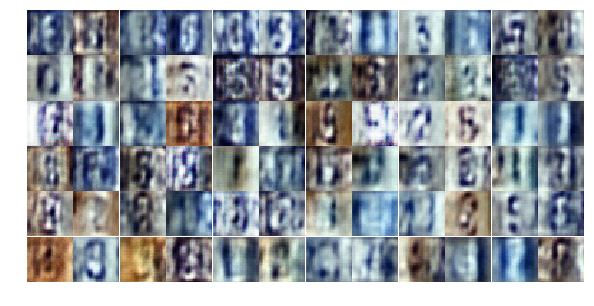

Batch 264    Epoch 3/25    Discriminator Loss: 0.4878... Generator Loss: 1.7600
Batch 274    Epoch 3/25    Discriminator Loss: 1.1033... Generator Loss: 1.0104
Batch 284    Epoch 3/25    Discriminator Loss: 0.6732... Generator Loss: 1.2961
Batch 294    Epoch 3/25    Discriminator Loss: 0.2913... Generator Loss: 2.5268
Batch 304    Epoch 3/25    Discriminator Loss: 0.9690... Generator Loss: 0.9077
Batch 314    Epoch 3/25    Discriminator Loss: 1.0413... Generator Loss: 0.9001
Batch 324    Epoch 3/25    Discriminator Loss: 1.3615... Generator Loss: 0.5047
Batch 334    Epoch 3/25    Discriminator Loss: 0.8815... Generator Loss: 1.2259
Batch 344    Epoch 3/25    Discriminator Loss: 0.5051... Generator Loss: 2.2806
Batch 354    Epoch 3/25    Discriminator Loss: 0.6675... Generator Loss: 1.1790


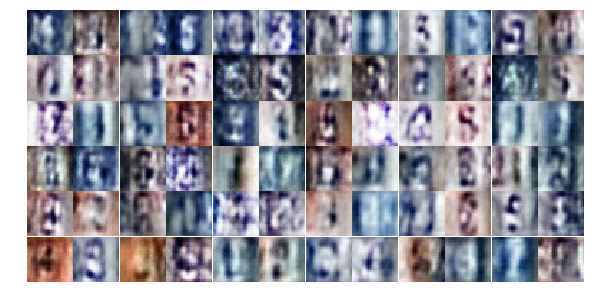

Batch 364    Epoch 3/25    Discriminator Loss: 0.5724... Generator Loss: 1.3451
Batch 374    Epoch 3/25    Discriminator Loss: 0.5881... Generator Loss: 1.5233
Batch 384    Epoch 3/25    Discriminator Loss: 0.4769... Generator Loss: 1.9427
Batch 394    Epoch 3/25    Discriminator Loss: 0.7300... Generator Loss: 0.9990
Batch 404    Epoch 3/25    Discriminator Loss: 0.5496... Generator Loss: 1.9571
Batch 414    Epoch 3/25    Discriminator Loss: 0.6235... Generator Loss: 1.6745
Batch 424    Epoch 3/25    Discriminator Loss: 0.8136... Generator Loss: 1.1666
Batch 434    Epoch 3/25    Discriminator Loss: 0.5321... Generator Loss: 1.3073
Batch 444    Epoch 3/25    Discriminator Loss: 0.6493... Generator Loss: 1.6742
Batch 454    Epoch 3/25    Discriminator Loss: 0.7998... Generator Loss: 0.9935


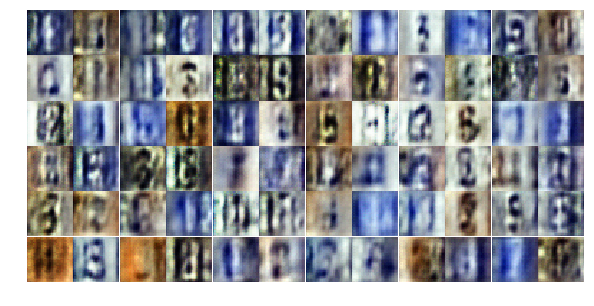

Batch 464    Epoch 3/25    Discriminator Loss: 0.8996... Generator Loss: 1.0738
Batch 474    Epoch 3/25    Discriminator Loss: 0.7430... Generator Loss: 1.0831
Batch 484    Epoch 3/25    Discriminator Loss: 0.7865... Generator Loss: 0.9739
Batch 494    Epoch 3/25    Discriminator Loss: 0.4745... Generator Loss: 1.6745
Batch 504    Epoch 3/25    Discriminator Loss: 1.0611... Generator Loss: 1.5139
Batch 514    Epoch 3/25    Discriminator Loss: 0.4939... Generator Loss: 1.5330
Batch 524    Epoch 3/25    Discriminator Loss: 0.6704... Generator Loss: 1.7714
Batch 534    Epoch 3/25    Discriminator Loss: 0.4851... Generator Loss: 1.6860
Batch 544    Epoch 3/25    Discriminator Loss: 0.6821... Generator Loss: 1.1325
Batch 554    Epoch 3/25    Discriminator Loss: 0.6942... Generator Loss: 1.2365


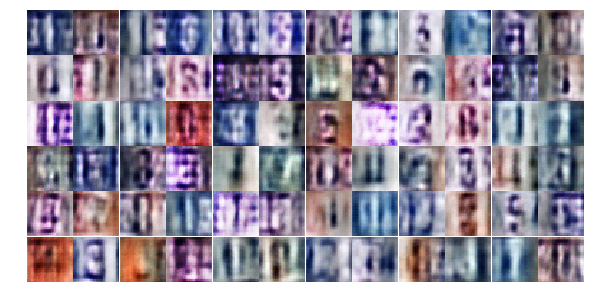

Batch 564    Epoch 3/25    Discriminator Loss: 1.0009... Generator Loss: 0.6966
Batch 1    Epoch 4/25    Discriminator Loss: 0.8741... Generator Loss: 0.7494
Batch 11    Epoch 4/25    Discriminator Loss: 1.0027... Generator Loss: 0.6608
Batch 21    Epoch 4/25    Discriminator Loss: 0.9013... Generator Loss: 0.8083
Batch 31    Epoch 4/25    Discriminator Loss: 0.7543... Generator Loss: 1.0295
Batch 41    Epoch 4/25    Discriminator Loss: 0.4405... Generator Loss: 1.6499
Batch 51    Epoch 4/25    Discriminator Loss: 0.6175... Generator Loss: 1.7614
Batch 61    Epoch 4/25    Discriminator Loss: 1.1240... Generator Loss: 0.6096
Batch 71    Epoch 4/25    Discriminator Loss: 0.9700... Generator Loss: 0.9232
Batch 81    Epoch 4/25    Discriminator Loss: 0.8951... Generator Loss: 0.9195


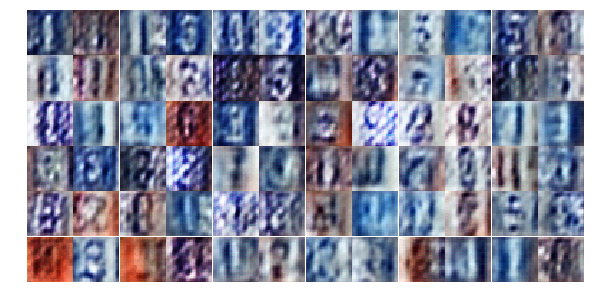

Batch 91    Epoch 4/25    Discriminator Loss: 0.5341... Generator Loss: 1.8517
Batch 101    Epoch 4/25    Discriminator Loss: 0.5967... Generator Loss: 1.0988
Batch 111    Epoch 4/25    Discriminator Loss: 0.8693... Generator Loss: 1.0236
Batch 121    Epoch 4/25    Discriminator Loss: 0.5761... Generator Loss: 1.3840
Batch 131    Epoch 4/25    Discriminator Loss: 0.6658... Generator Loss: 1.3172
Batch 141    Epoch 4/25    Discriminator Loss: 0.7112... Generator Loss: 1.4533
Batch 151    Epoch 4/25    Discriminator Loss: 1.1314... Generator Loss: 0.5510
Batch 161    Epoch 4/25    Discriminator Loss: 0.8187... Generator Loss: 1.0342
Batch 171    Epoch 4/25    Discriminator Loss: 0.7160... Generator Loss: 1.5283
Batch 181    Epoch 4/25    Discriminator Loss: 0.3651... Generator Loss: 1.9242


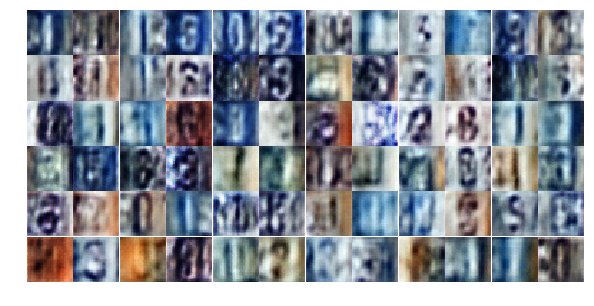

Batch 191    Epoch 4/25    Discriminator Loss: 0.7442... Generator Loss: 1.2446
Batch 201    Epoch 4/25    Discriminator Loss: 0.7579... Generator Loss: 1.0056
Batch 211    Epoch 4/25    Discriminator Loss: 1.4548... Generator Loss: 0.3805
Batch 221    Epoch 4/25    Discriminator Loss: 0.9415... Generator Loss: 0.7480
Batch 231    Epoch 4/25    Discriminator Loss: 0.6789... Generator Loss: 1.0980
Batch 241    Epoch 4/25    Discriminator Loss: 0.3613... Generator Loss: 1.8254
Batch 251    Epoch 4/25    Discriminator Loss: 0.8764... Generator Loss: 0.7349
Batch 261    Epoch 4/25    Discriminator Loss: 0.3204... Generator Loss: 2.0507
Batch 271    Epoch 4/25    Discriminator Loss: 0.6819... Generator Loss: 1.0076
Batch 281    Epoch 4/25    Discriminator Loss: 0.8687... Generator Loss: 2.4541


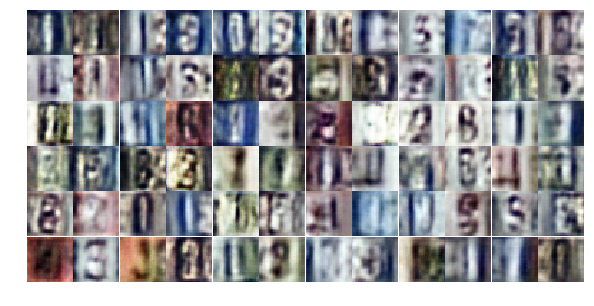

Batch 291    Epoch 4/25    Discriminator Loss: 0.4718... Generator Loss: 2.1031
Batch 301    Epoch 4/25    Discriminator Loss: 0.7207... Generator Loss: 1.0353
Batch 311    Epoch 4/25    Discriminator Loss: 0.5341... Generator Loss: 1.3886
Batch 321    Epoch 4/25    Discriminator Loss: 0.8191... Generator Loss: 1.8022
Batch 331    Epoch 4/25    Discriminator Loss: 0.5865... Generator Loss: 1.6087
Batch 341    Epoch 4/25    Discriminator Loss: 0.4901... Generator Loss: 1.5695
Batch 351    Epoch 4/25    Discriminator Loss: 0.6713... Generator Loss: 1.0485
Batch 361    Epoch 4/25    Discriminator Loss: 0.9553... Generator Loss: 0.6521
Batch 371    Epoch 4/25    Discriminator Loss: 0.3993... Generator Loss: 2.1588
Batch 381    Epoch 4/25    Discriminator Loss: 1.3220... Generator Loss: 0.4553


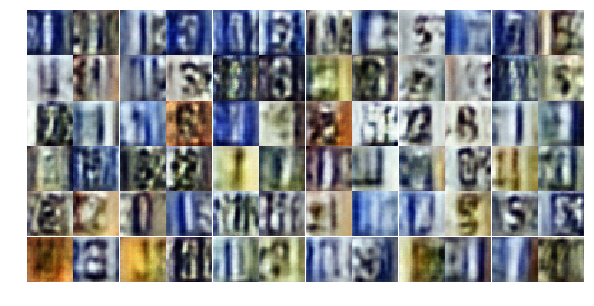

Batch 391    Epoch 4/25    Discriminator Loss: 0.7272... Generator Loss: 1.0034
Batch 401    Epoch 4/25    Discriminator Loss: 0.6675... Generator Loss: 0.9965
Batch 411    Epoch 4/25    Discriminator Loss: 0.6152... Generator Loss: 1.8585
Batch 421    Epoch 4/25    Discriminator Loss: 0.4364... Generator Loss: 1.7895
Batch 431    Epoch 4/25    Discriminator Loss: 0.4896... Generator Loss: 1.6432
Batch 441    Epoch 4/25    Discriminator Loss: 0.9116... Generator Loss: 0.9211
Batch 451    Epoch 4/25    Discriminator Loss: 0.6762... Generator Loss: 1.0370
Batch 461    Epoch 4/25    Discriminator Loss: 0.4908... Generator Loss: 1.8849
Batch 471    Epoch 4/25    Discriminator Loss: 0.5704... Generator Loss: 1.2563
Batch 481    Epoch 4/25    Discriminator Loss: 0.4160... Generator Loss: 1.8243


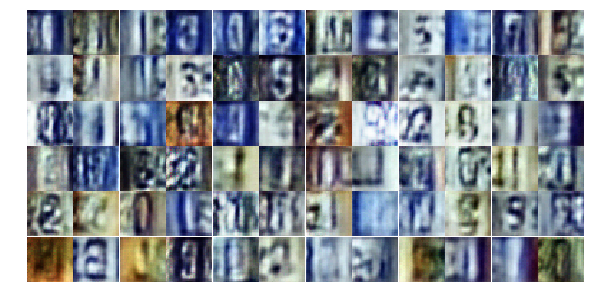

Batch 491    Epoch 4/25    Discriminator Loss: 0.4316... Generator Loss: 2.0341
Batch 501    Epoch 4/25    Discriminator Loss: 0.8307... Generator Loss: 2.8108
Batch 511    Epoch 4/25    Discriminator Loss: 0.5232... Generator Loss: 1.6782
Batch 521    Epoch 4/25    Discriminator Loss: 0.5458... Generator Loss: 1.6908
Batch 531    Epoch 4/25    Discriminator Loss: 0.3926... Generator Loss: 1.7541
Batch 541    Epoch 4/25    Discriminator Loss: 0.5463... Generator Loss: 1.1220
Batch 551    Epoch 4/25    Discriminator Loss: 0.3456... Generator Loss: 1.8170
Batch 561    Epoch 4/25    Discriminator Loss: 0.6453... Generator Loss: 1.0342
Batch 571    Epoch 4/25    Discriminator Loss: 0.6242... Generator Loss: 1.4867
Batch 8    Epoch 5/25    Discriminator Loss: 0.5886... Generator Loss: 1.3970


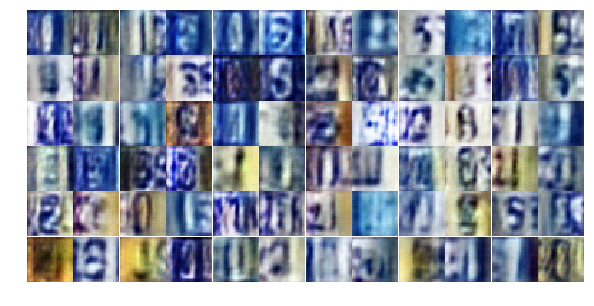

Batch 18    Epoch 5/25    Discriminator Loss: 0.4117... Generator Loss: 1.5102
Batch 28    Epoch 5/25    Discriminator Loss: 0.5762... Generator Loss: 1.1319
Batch 38    Epoch 5/25    Discriminator Loss: 0.6752... Generator Loss: 1.0615
Batch 48    Epoch 5/25    Discriminator Loss: 0.3825... Generator Loss: 1.8919
Batch 58    Epoch 5/25    Discriminator Loss: 0.2638... Generator Loss: 2.9729
Batch 68    Epoch 5/25    Discriminator Loss: 0.6240... Generator Loss: 1.1459
Batch 78    Epoch 5/25    Discriminator Loss: 0.4871... Generator Loss: 1.3609
Batch 88    Epoch 5/25    Discriminator Loss: 0.5322... Generator Loss: 1.1602
Batch 98    Epoch 5/25    Discriminator Loss: 1.4409... Generator Loss: 0.3659
Batch 108    Epoch 5/25    Discriminator Loss: 0.5922... Generator Loss: 1.5416


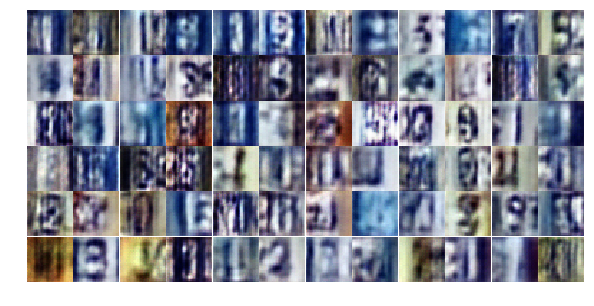

Batch 118    Epoch 5/25    Discriminator Loss: 0.5457... Generator Loss: 1.6639
Batch 128    Epoch 5/25    Discriminator Loss: 0.4300... Generator Loss: 2.1278
Batch 138    Epoch 5/25    Discriminator Loss: 0.3605... Generator Loss: 1.8214
Batch 148    Epoch 5/25    Discriminator Loss: 1.2072... Generator Loss: 2.0005
Batch 158    Epoch 5/25    Discriminator Loss: 0.6598... Generator Loss: 1.4458
Batch 168    Epoch 5/25    Discriminator Loss: 1.2131... Generator Loss: 0.5058
Batch 178    Epoch 5/25    Discriminator Loss: 1.2572... Generator Loss: 0.4541
Batch 188    Epoch 5/25    Discriminator Loss: 0.5705... Generator Loss: 1.3256
Batch 198    Epoch 5/25    Discriminator Loss: 0.3968... Generator Loss: 2.2134
Batch 208    Epoch 5/25    Discriminator Loss: 0.6584... Generator Loss: 1.1232


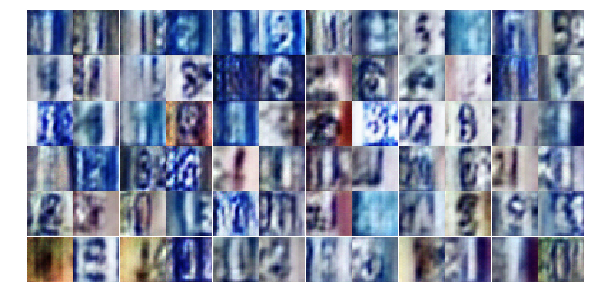

Batch 218    Epoch 5/25    Discriminator Loss: 0.4201... Generator Loss: 1.6085
Batch 228    Epoch 5/25    Discriminator Loss: 1.8106... Generator Loss: 0.2472
Batch 238    Epoch 5/25    Discriminator Loss: 0.7298... Generator Loss: 1.3955
Batch 248    Epoch 5/25    Discriminator Loss: 0.6436... Generator Loss: 1.1530
Batch 258    Epoch 5/25    Discriminator Loss: 0.9474... Generator Loss: 0.6492
Batch 268    Epoch 5/25    Discriminator Loss: 0.5711... Generator Loss: 1.1510
Batch 278    Epoch 5/25    Discriminator Loss: 1.0241... Generator Loss: 0.5989
Batch 288    Epoch 5/25    Discriminator Loss: 1.8059... Generator Loss: 0.2624
Batch 298    Epoch 5/25    Discriminator Loss: 1.7876... Generator Loss: 0.3769
Batch 308    Epoch 5/25    Discriminator Loss: 0.5412... Generator Loss: 1.2996


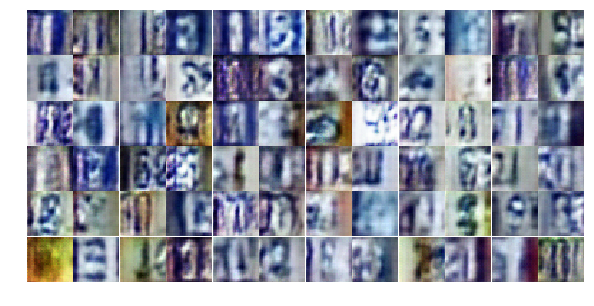

Batch 318    Epoch 5/25    Discriminator Loss: 0.6601... Generator Loss: 1.0646
Batch 328    Epoch 5/25    Discriminator Loss: 0.4827... Generator Loss: 1.4372
Batch 338    Epoch 5/25    Discriminator Loss: 0.4255... Generator Loss: 1.5281
Batch 348    Epoch 5/25    Discriminator Loss: 0.3740... Generator Loss: 1.7958
Batch 358    Epoch 5/25    Discriminator Loss: 1.9909... Generator Loss: 0.2405
Batch 368    Epoch 5/25    Discriminator Loss: 0.4568... Generator Loss: 2.4989
Batch 378    Epoch 5/25    Discriminator Loss: 0.5668... Generator Loss: 1.2724
Batch 388    Epoch 5/25    Discriminator Loss: 0.5342... Generator Loss: 1.2872
Batch 398    Epoch 5/25    Discriminator Loss: 1.1502... Generator Loss: 0.5224
Batch 408    Epoch 5/25    Discriminator Loss: 0.7118... Generator Loss: 1.0911


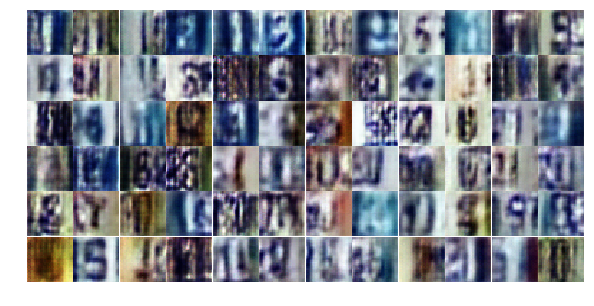

Batch 418    Epoch 5/25    Discriminator Loss: 0.4181... Generator Loss: 1.6556
Batch 428    Epoch 5/25    Discriminator Loss: 0.5936... Generator Loss: 1.0741
Batch 438    Epoch 5/25    Discriminator Loss: 0.6895... Generator Loss: 1.0562
Batch 448    Epoch 5/25    Discriminator Loss: 0.9296... Generator Loss: 3.8296
Batch 458    Epoch 5/25    Discriminator Loss: 0.6231... Generator Loss: 1.4991
Batch 468    Epoch 5/25    Discriminator Loss: 0.6924... Generator Loss: 1.1902
Batch 478    Epoch 5/25    Discriminator Loss: 0.7486... Generator Loss: 0.9132
Batch 488    Epoch 5/25    Discriminator Loss: 0.5055... Generator Loss: 1.3219
Batch 498    Epoch 5/25    Discriminator Loss: 0.5116... Generator Loss: 1.4050
Batch 508    Epoch 5/25    Discriminator Loss: 0.5714... Generator Loss: 1.2302


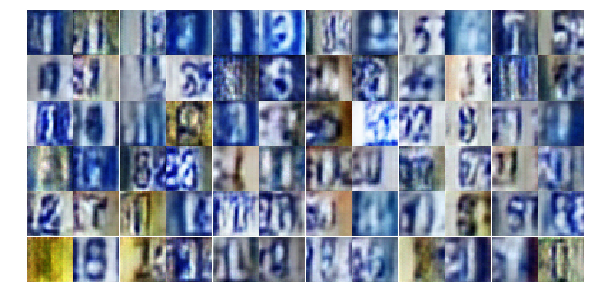

Batch 518    Epoch 5/25    Discriminator Loss: 0.8350... Generator Loss: 2.7961
Batch 528    Epoch 5/25    Discriminator Loss: 0.5837... Generator Loss: 1.1466
Batch 538    Epoch 5/25    Discriminator Loss: 0.9730... Generator Loss: 1.2471
Batch 548    Epoch 5/25    Discriminator Loss: 0.6775... Generator Loss: 0.9186
Batch 558    Epoch 5/25    Discriminator Loss: 0.7468... Generator Loss: 0.9166
Batch 568    Epoch 5/25    Discriminator Loss: 0.6462... Generator Loss: 1.8093
Batch 5    Epoch 6/25    Discriminator Loss: 0.6117... Generator Loss: 1.3569
Batch 15    Epoch 6/25    Discriminator Loss: 0.5960... Generator Loss: 1.0761
Batch 25    Epoch 6/25    Discriminator Loss: 0.7421... Generator Loss: 0.8599
Batch 35    Epoch 6/25    Discriminator Loss: 1.1660... Generator Loss: 1.5582


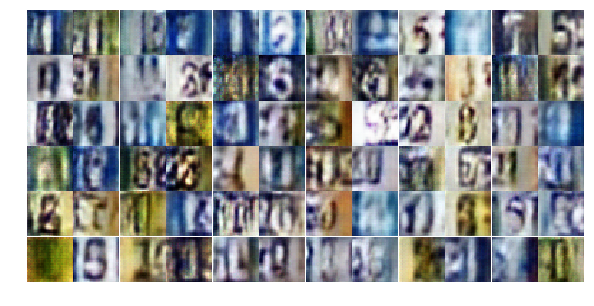

Batch 45    Epoch 6/25    Discriminator Loss: 0.5943... Generator Loss: 2.1893
Batch 55    Epoch 6/25    Discriminator Loss: 0.6386... Generator Loss: 1.7455
Batch 65    Epoch 6/25    Discriminator Loss: 0.7948... Generator Loss: 0.9136
Batch 75    Epoch 6/25    Discriminator Loss: 1.3067... Generator Loss: 0.5301
Batch 85    Epoch 6/25    Discriminator Loss: 0.9306... Generator Loss: 0.6652
Batch 95    Epoch 6/25    Discriminator Loss: 0.4033... Generator Loss: 1.4797
Batch 105    Epoch 6/25    Discriminator Loss: 0.5494... Generator Loss: 1.6651
Batch 115    Epoch 6/25    Discriminator Loss: 0.9681... Generator Loss: 0.7278
Batch 125    Epoch 6/25    Discriminator Loss: 0.5498... Generator Loss: 1.2128
Batch 135    Epoch 6/25    Discriminator Loss: 0.7619... Generator Loss: 2.0183


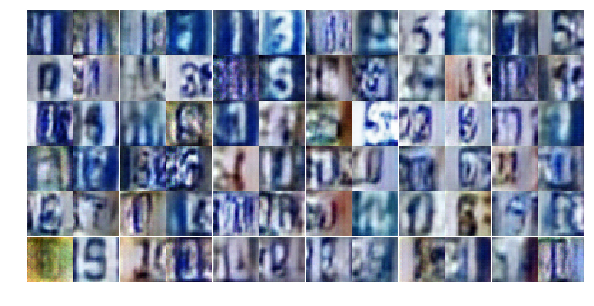

Batch 145    Epoch 6/25    Discriminator Loss: 1.3599... Generator Loss: 0.3875
Batch 155    Epoch 6/25    Discriminator Loss: 1.1773... Generator Loss: 0.5938
Batch 165    Epoch 6/25    Discriminator Loss: 1.0969... Generator Loss: 0.5409
Batch 175    Epoch 6/25    Discriminator Loss: 1.1744... Generator Loss: 0.5115
Batch 185    Epoch 6/25    Discriminator Loss: 0.6061... Generator Loss: 1.5038
Batch 195    Epoch 6/25    Discriminator Loss: 0.5632... Generator Loss: 1.5679
Batch 205    Epoch 6/25    Discriminator Loss: 0.7207... Generator Loss: 0.9436
Batch 215    Epoch 6/25    Discriminator Loss: 0.5965... Generator Loss: 1.1187
Batch 225    Epoch 6/25    Discriminator Loss: 0.8595... Generator Loss: 2.4020
Batch 235    Epoch 6/25    Discriminator Loss: 0.5961... Generator Loss: 1.4177


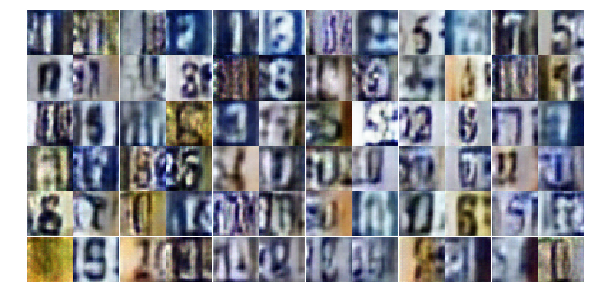

Batch 245    Epoch 6/25    Discriminator Loss: 1.0354... Generator Loss: 0.6800
Batch 255    Epoch 6/25    Discriminator Loss: 0.9154... Generator Loss: 1.0531
Batch 265    Epoch 6/25    Discriminator Loss: 1.6991... Generator Loss: 0.2857
Batch 275    Epoch 6/25    Discriminator Loss: 0.8610... Generator Loss: 1.6245
Batch 285    Epoch 6/25    Discriminator Loss: 0.7130... Generator Loss: 1.0679
Batch 295    Epoch 6/25    Discriminator Loss: 1.6402... Generator Loss: 0.3983
Batch 305    Epoch 6/25    Discriminator Loss: 0.6095... Generator Loss: 2.1461
Batch 315    Epoch 6/25    Discriminator Loss: 0.3700... Generator Loss: 2.4846
Batch 325    Epoch 6/25    Discriminator Loss: 0.7617... Generator Loss: 0.8560
Batch 335    Epoch 6/25    Discriminator Loss: 0.4865... Generator Loss: 1.4631


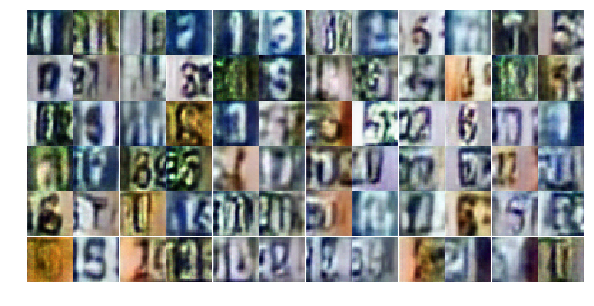

Batch 345    Epoch 6/25    Discriminator Loss: 0.6289... Generator Loss: 1.5890
Batch 355    Epoch 6/25    Discriminator Loss: 0.7682... Generator Loss: 1.1402
Batch 365    Epoch 6/25    Discriminator Loss: 0.8787... Generator Loss: 0.8498
Batch 375    Epoch 6/25    Discriminator Loss: 0.7961... Generator Loss: 0.9564
Batch 385    Epoch 6/25    Discriminator Loss: 0.8806... Generator Loss: 0.8599
Batch 395    Epoch 6/25    Discriminator Loss: 1.0120... Generator Loss: 0.6403
Batch 405    Epoch 6/25    Discriminator Loss: 1.0097... Generator Loss: 0.8112
Batch 415    Epoch 6/25    Discriminator Loss: 0.5001... Generator Loss: 1.5083
Batch 425    Epoch 6/25    Discriminator Loss: 1.1391... Generator Loss: 0.5712
Batch 435    Epoch 6/25    Discriminator Loss: 0.3028... Generator Loss: 1.8739


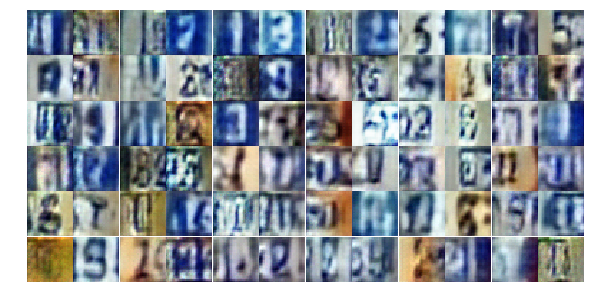

Batch 445    Epoch 6/25    Discriminator Loss: 1.6570... Generator Loss: 0.3625
Batch 455    Epoch 6/25    Discriminator Loss: 0.8389... Generator Loss: 1.4480
Batch 465    Epoch 6/25    Discriminator Loss: 0.8978... Generator Loss: 0.8542
Batch 475    Epoch 6/25    Discriminator Loss: 0.5879... Generator Loss: 1.3021
Batch 485    Epoch 6/25    Discriminator Loss: 0.5322... Generator Loss: 1.4883
Batch 495    Epoch 6/25    Discriminator Loss: 0.5649... Generator Loss: 1.1399
Batch 505    Epoch 6/25    Discriminator Loss: 1.0873... Generator Loss: 0.6286
Batch 515    Epoch 6/25    Discriminator Loss: 1.1309... Generator Loss: 0.5301
Batch 525    Epoch 6/25    Discriminator Loss: 0.6954... Generator Loss: 0.9820
Batch 535    Epoch 6/25    Discriminator Loss: 1.2196... Generator Loss: 0.4744


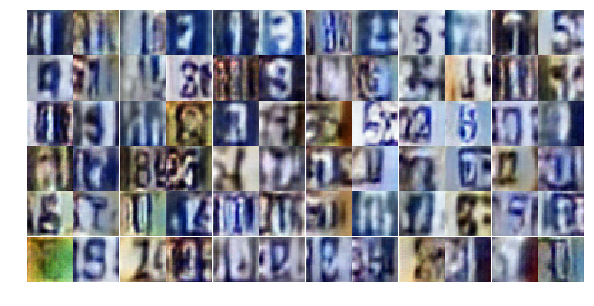

Batch 545    Epoch 6/25    Discriminator Loss: 0.5403... Generator Loss: 1.5937
Batch 555    Epoch 6/25    Discriminator Loss: 0.5595... Generator Loss: 2.0993
Batch 565    Epoch 6/25    Discriminator Loss: 0.6466... Generator Loss: 1.0247
Batch 2    Epoch 7/25    Discriminator Loss: 0.7087... Generator Loss: 1.5098
Batch 12    Epoch 7/25    Discriminator Loss: 0.8694... Generator Loss: 0.8112
Batch 22    Epoch 7/25    Discriminator Loss: 0.8427... Generator Loss: 0.8728
Batch 32    Epoch 7/25    Discriminator Loss: 0.6462... Generator Loss: 1.1353
Batch 42    Epoch 7/25    Discriminator Loss: 0.9266... Generator Loss: 0.7441
Batch 52    Epoch 7/25    Discriminator Loss: 0.5342... Generator Loss: 1.8282
Batch 62    Epoch 7/25    Discriminator Loss: 0.8519... Generator Loss: 0.9522


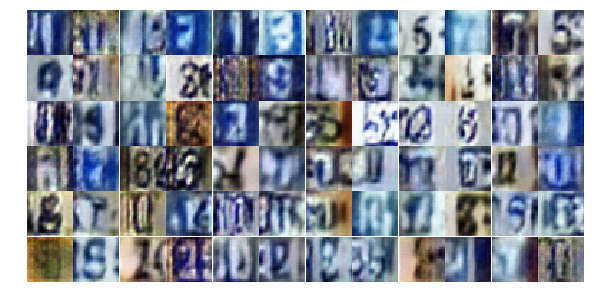

Batch 72    Epoch 7/25    Discriminator Loss: 0.6095... Generator Loss: 1.3049
Batch 82    Epoch 7/25    Discriminator Loss: 0.7033... Generator Loss: 0.9156
Batch 92    Epoch 7/25    Discriminator Loss: 0.7883... Generator Loss: 1.0362
Batch 102    Epoch 7/25    Discriminator Loss: 0.6763... Generator Loss: 1.3216
Batch 112    Epoch 7/25    Discriminator Loss: 0.6006... Generator Loss: 1.6898
Batch 122    Epoch 7/25    Discriminator Loss: 0.6158... Generator Loss: 1.0898
Batch 132    Epoch 7/25    Discriminator Loss: 0.7861... Generator Loss: 1.5488
Batch 142    Epoch 7/25    Discriminator Loss: 0.8768... Generator Loss: 2.2336
Batch 152    Epoch 7/25    Discriminator Loss: 1.5944... Generator Loss: 3.6710
Batch 162    Epoch 7/25    Discriminator Loss: 0.8534... Generator Loss: 0.7571


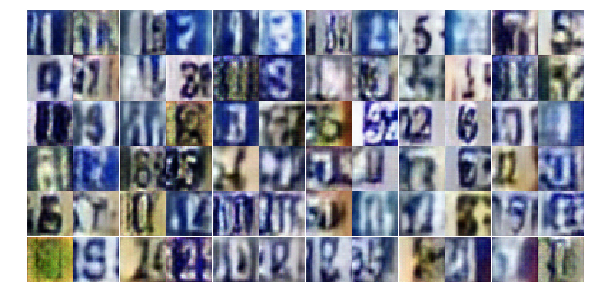

Batch 172    Epoch 7/25    Discriminator Loss: 0.8256... Generator Loss: 0.9594
Batch 182    Epoch 7/25    Discriminator Loss: 0.5487... Generator Loss: 1.3021
Batch 192    Epoch 7/25    Discriminator Loss: 0.9138... Generator Loss: 0.7572
Batch 202    Epoch 7/25    Discriminator Loss: 0.9377... Generator Loss: 1.5169
Batch 212    Epoch 7/25    Discriminator Loss: 0.7501... Generator Loss: 0.9542
Batch 222    Epoch 7/25    Discriminator Loss: 0.5014... Generator Loss: 1.6451
Batch 232    Epoch 7/25    Discriminator Loss: 0.5983... Generator Loss: 1.6093
Batch 242    Epoch 7/25    Discriminator Loss: 0.8093... Generator Loss: 1.0049
Batch 252    Epoch 7/25    Discriminator Loss: 0.3174... Generator Loss: 2.2159
Batch 262    Epoch 7/25    Discriminator Loss: 0.6018... Generator Loss: 2.0446


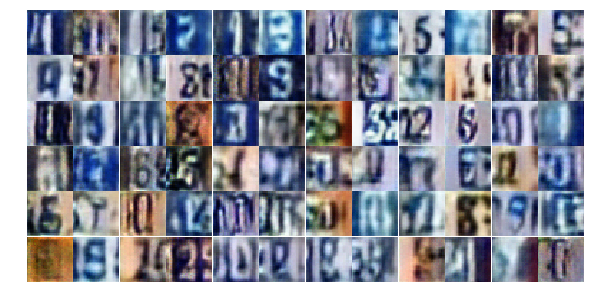

Batch 272    Epoch 7/25    Discriminator Loss: 0.9469... Generator Loss: 0.6561
Batch 282    Epoch 7/25    Discriminator Loss: 1.2001... Generator Loss: 0.4772
Batch 292    Epoch 7/25    Discriminator Loss: 0.7549... Generator Loss: 0.9014
Batch 302    Epoch 7/25    Discriminator Loss: 0.6970... Generator Loss: 1.0855
Batch 312    Epoch 7/25    Discriminator Loss: 0.8419... Generator Loss: 0.7318
Batch 322    Epoch 7/25    Discriminator Loss: 1.0530... Generator Loss: 0.5883
Batch 332    Epoch 7/25    Discriminator Loss: 1.4547... Generator Loss: 0.3699
Batch 342    Epoch 7/25    Discriminator Loss: 0.9625... Generator Loss: 0.7306
Batch 352    Epoch 7/25    Discriminator Loss: 1.0967... Generator Loss: 0.5346
Batch 362    Epoch 7/25    Discriminator Loss: 0.6842... Generator Loss: 2.0516


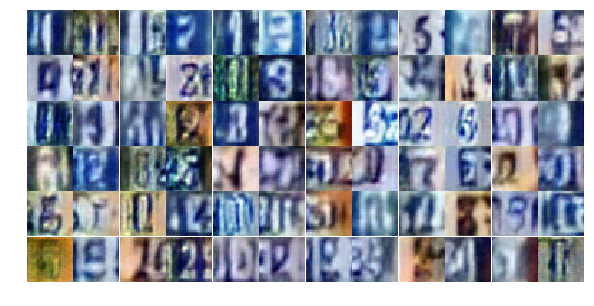

Batch 372    Epoch 7/25    Discriminator Loss: 1.2901... Generator Loss: 0.4529
Batch 382    Epoch 7/25    Discriminator Loss: 0.5538... Generator Loss: 1.1970
Batch 392    Epoch 7/25    Discriminator Loss: 0.6666... Generator Loss: 1.0711
Batch 402    Epoch 7/25    Discriminator Loss: 0.9856... Generator Loss: 0.6259
Batch 412    Epoch 7/25    Discriminator Loss: 0.9500... Generator Loss: 0.6877
Batch 422    Epoch 7/25    Discriminator Loss: 0.5730... Generator Loss: 1.2493
Batch 432    Epoch 7/25    Discriminator Loss: 0.5150... Generator Loss: 1.4181
Batch 442    Epoch 7/25    Discriminator Loss: 1.0885... Generator Loss: 1.4068
Batch 452    Epoch 7/25    Discriminator Loss: 0.4191... Generator Loss: 2.9723
Batch 462    Epoch 7/25    Discriminator Loss: 1.0063... Generator Loss: 0.7372


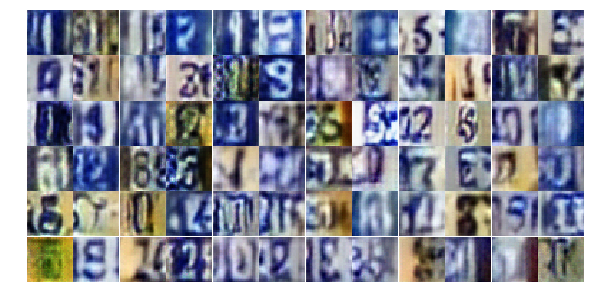

Batch 472    Epoch 7/25    Discriminator Loss: 0.4387... Generator Loss: 2.1321
Batch 482    Epoch 7/25    Discriminator Loss: 0.5069... Generator Loss: 1.5605
Batch 492    Epoch 7/25    Discriminator Loss: 0.6591... Generator Loss: 1.2862
Batch 502    Epoch 7/25    Discriminator Loss: 0.7121... Generator Loss: 0.9989
Batch 512    Epoch 7/25    Discriminator Loss: 0.6452... Generator Loss: 1.1621
Batch 522    Epoch 7/25    Discriminator Loss: 0.8194... Generator Loss: 0.9005
Batch 532    Epoch 7/25    Discriminator Loss: 1.4315... Generator Loss: 0.3750
Batch 542    Epoch 7/25    Discriminator Loss: 0.7209... Generator Loss: 1.5371
Batch 552    Epoch 7/25    Discriminator Loss: 0.9161... Generator Loss: 0.9789
Batch 562    Epoch 7/25    Discriminator Loss: 1.2622... Generator Loss: 0.4607


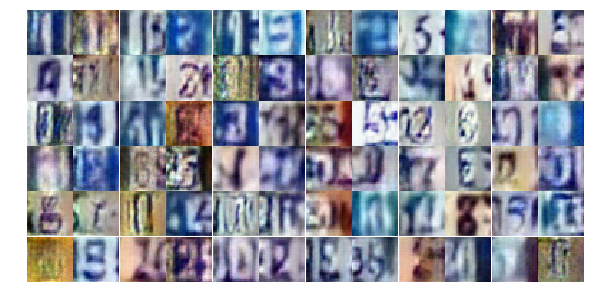

Batch 572    Epoch 7/25    Discriminator Loss: 0.5819... Generator Loss: 1.9509
Batch 9    Epoch 8/25    Discriminator Loss: 0.8435... Generator Loss: 0.7945
Batch 19    Epoch 8/25    Discriminator Loss: 0.9385... Generator Loss: 0.6613
Batch 29    Epoch 8/25    Discriminator Loss: 0.8284... Generator Loss: 0.9116
Batch 39    Epoch 8/25    Discriminator Loss: 0.8005... Generator Loss: 0.8494
Batch 49    Epoch 8/25    Discriminator Loss: 1.0683... Generator Loss: 0.5682
Batch 59    Epoch 8/25    Discriminator Loss: 1.5315... Generator Loss: 0.3372
Batch 69    Epoch 8/25    Discriminator Loss: 0.7113... Generator Loss: 1.1197
Batch 79    Epoch 8/25    Discriminator Loss: 1.0530... Generator Loss: 0.5718
Batch 89    Epoch 8/25    Discriminator Loss: 0.7519... Generator Loss: 0.9057


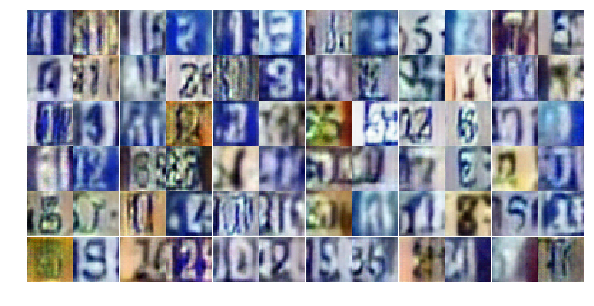

Batch 99    Epoch 8/25    Discriminator Loss: 0.5340... Generator Loss: 1.4591
Batch 109    Epoch 8/25    Discriminator Loss: 0.5003... Generator Loss: 1.2534
Batch 119    Epoch 8/25    Discriminator Loss: 0.9793... Generator Loss: 0.6415
Batch 129    Epoch 8/25    Discriminator Loss: 0.5522... Generator Loss: 1.1629
Batch 139    Epoch 8/25    Discriminator Loss: 0.8106... Generator Loss: 0.8789
Batch 149    Epoch 8/25    Discriminator Loss: 0.5491... Generator Loss: 1.8189
Batch 159    Epoch 8/25    Discriminator Loss: 0.4947... Generator Loss: 1.7268
Batch 169    Epoch 8/25    Discriminator Loss: 0.7265... Generator Loss: 1.8226
Batch 179    Epoch 8/25    Discriminator Loss: 0.8413... Generator Loss: 1.1540
Batch 189    Epoch 8/25    Discriminator Loss: 1.2110... Generator Loss: 0.5022


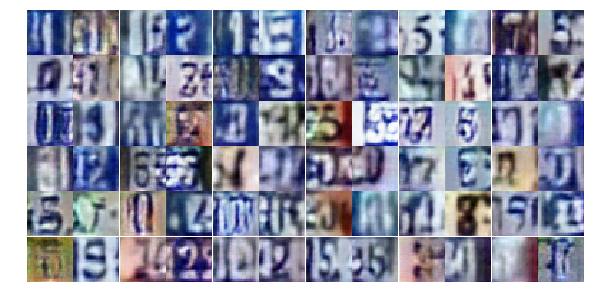

Batch 199    Epoch 8/25    Discriminator Loss: 0.5803... Generator Loss: 1.2259
Batch 209    Epoch 8/25    Discriminator Loss: 0.5835... Generator Loss: 1.1697
Batch 219    Epoch 8/25    Discriminator Loss: 0.7946... Generator Loss: 1.8385
Batch 229    Epoch 8/25    Discriminator Loss: 1.2474... Generator Loss: 0.5010
Batch 239    Epoch 8/25    Discriminator Loss: 0.5197... Generator Loss: 1.5279
Batch 249    Epoch 8/25    Discriminator Loss: 0.7516... Generator Loss: 0.9652
Batch 259    Epoch 8/25    Discriminator Loss: 0.6335... Generator Loss: 1.1450
Batch 269    Epoch 8/25    Discriminator Loss: 0.5258... Generator Loss: 1.4151
Batch 279    Epoch 8/25    Discriminator Loss: 0.5762... Generator Loss: 1.5616
Batch 289    Epoch 8/25    Discriminator Loss: 0.6747... Generator Loss: 1.2013


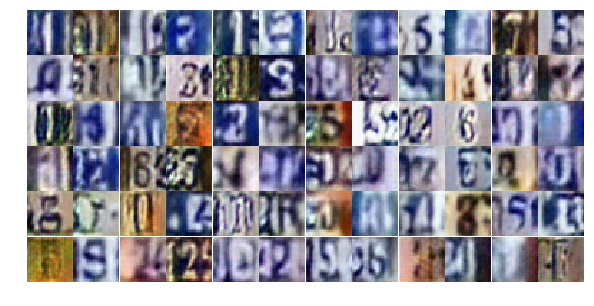

Batch 299    Epoch 8/25    Discriminator Loss: 0.6140... Generator Loss: 1.1976
Batch 309    Epoch 8/25    Discriminator Loss: 0.7879... Generator Loss: 0.9165
Batch 319    Epoch 8/25    Discriminator Loss: 0.6650... Generator Loss: 1.0275
Batch 329    Epoch 8/25    Discriminator Loss: 1.2142... Generator Loss: 0.4436
Batch 339    Epoch 8/25    Discriminator Loss: 1.4594... Generator Loss: 0.3739
Batch 349    Epoch 8/25    Discriminator Loss: 0.6139... Generator Loss: 1.8306
Batch 359    Epoch 8/25    Discriminator Loss: 0.8356... Generator Loss: 0.8867
Batch 369    Epoch 8/25    Discriminator Loss: 0.6180... Generator Loss: 1.4375
Batch 379    Epoch 8/25    Discriminator Loss: 0.8049... Generator Loss: 0.9981
Batch 389    Epoch 8/25    Discriminator Loss: 0.5953... Generator Loss: 1.4970


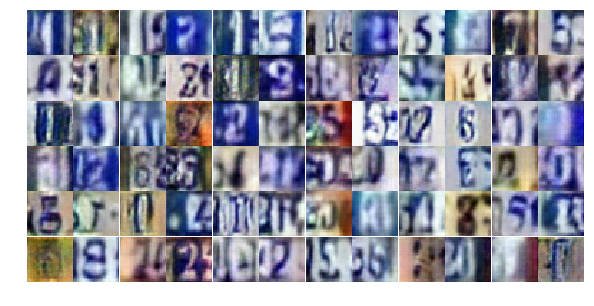

Batch 399    Epoch 8/25    Discriminator Loss: 0.5593... Generator Loss: 1.7145
Batch 409    Epoch 8/25    Discriminator Loss: 0.9827... Generator Loss: 0.6817
Batch 419    Epoch 8/25    Discriminator Loss: 1.1699... Generator Loss: 0.5095
Batch 429    Epoch 8/25    Discriminator Loss: 0.6444... Generator Loss: 1.3072
Batch 439    Epoch 8/25    Discriminator Loss: 2.3689... Generator Loss: 3.6845
Batch 449    Epoch 8/25    Discriminator Loss: 1.0222... Generator Loss: 0.6511
Batch 459    Epoch 8/25    Discriminator Loss: 0.5514... Generator Loss: 1.2547
Batch 469    Epoch 8/25    Discriminator Loss: 1.0059... Generator Loss: 2.8112
Batch 479    Epoch 8/25    Discriminator Loss: 1.5965... Generator Loss: 2.6759
Batch 489    Epoch 8/25    Discriminator Loss: 0.9494... Generator Loss: 0.7830


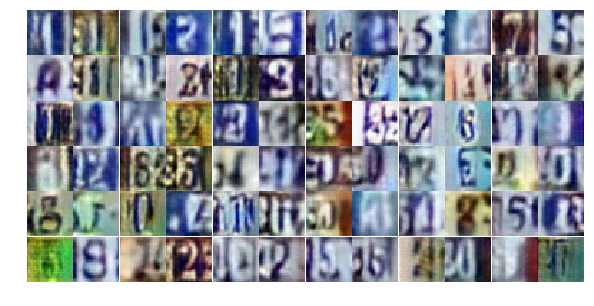

Batch 499    Epoch 8/25    Discriminator Loss: 0.7468... Generator Loss: 0.9042
Batch 509    Epoch 8/25    Discriminator Loss: 0.7085... Generator Loss: 1.0662
Batch 519    Epoch 8/25    Discriminator Loss: 0.5312... Generator Loss: 1.3842
Batch 529    Epoch 8/25    Discriminator Loss: 1.0223... Generator Loss: 0.6580
Batch 539    Epoch 8/25    Discriminator Loss: 0.4716... Generator Loss: 1.7935
Batch 549    Epoch 8/25    Discriminator Loss: 0.7540... Generator Loss: 0.9820
Batch 559    Epoch 8/25    Discriminator Loss: 0.8787... Generator Loss: 0.7392
Batch 569    Epoch 8/25    Discriminator Loss: 0.6208... Generator Loss: 2.1252
Batch 6    Epoch 9/25    Discriminator Loss: 0.8944... Generator Loss: 1.0583
Batch 16    Epoch 9/25    Discriminator Loss: 0.9856... Generator Loss: 0.6339


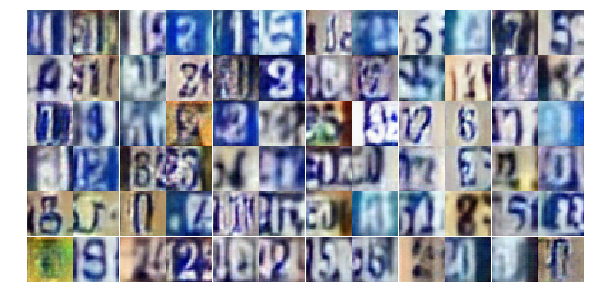

Batch 26    Epoch 9/25    Discriminator Loss: 0.8887... Generator Loss: 0.7758
Batch 36    Epoch 9/25    Discriminator Loss: 0.7484... Generator Loss: 1.8733
Batch 46    Epoch 9/25    Discriminator Loss: 1.5324... Generator Loss: 2.7185
Batch 56    Epoch 9/25    Discriminator Loss: 0.7383... Generator Loss: 0.9210
Batch 66    Epoch 9/25    Discriminator Loss: 0.8251... Generator Loss: 0.8882
Batch 76    Epoch 9/25    Discriminator Loss: 0.6508... Generator Loss: 1.6393
Batch 86    Epoch 9/25    Discriminator Loss: 0.6736... Generator Loss: 1.1020
Batch 96    Epoch 9/25    Discriminator Loss: 0.7012... Generator Loss: 0.9854
Batch 106    Epoch 9/25    Discriminator Loss: 0.8492... Generator Loss: 0.8386
Batch 116    Epoch 9/25    Discriminator Loss: 0.5731... Generator Loss: 1.3527


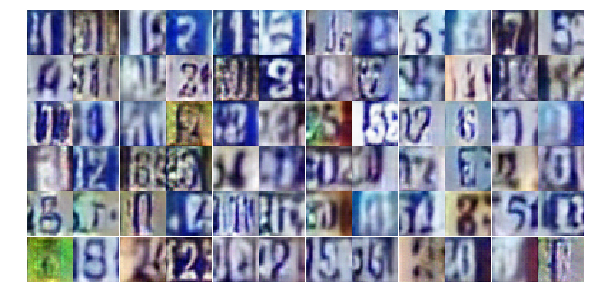

Batch 126    Epoch 9/25    Discriminator Loss: 1.2363... Generator Loss: 0.4623
Batch 136    Epoch 9/25    Discriminator Loss: 1.1297... Generator Loss: 1.8170
Batch 146    Epoch 9/25    Discriminator Loss: 0.7176... Generator Loss: 1.2009
Batch 156    Epoch 9/25    Discriminator Loss: 0.7976... Generator Loss: 0.9011
Batch 166    Epoch 9/25    Discriminator Loss: 0.5816... Generator Loss: 1.5384
Batch 176    Epoch 9/25    Discriminator Loss: 0.7721... Generator Loss: 1.5164
Batch 186    Epoch 9/25    Discriminator Loss: 0.8167... Generator Loss: 1.0543
Batch 196    Epoch 9/25    Discriminator Loss: 0.4640... Generator Loss: 1.5119
Batch 206    Epoch 9/25    Discriminator Loss: 1.2013... Generator Loss: 0.5194
Batch 216    Epoch 9/25    Discriminator Loss: 0.9496... Generator Loss: 0.8039


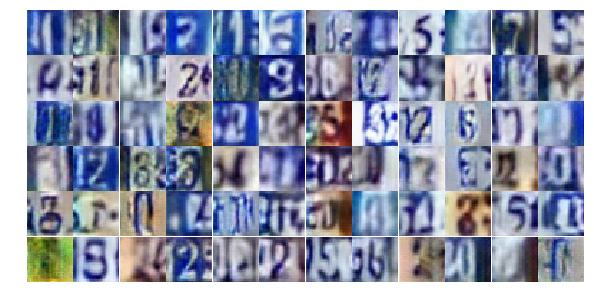

Batch 226    Epoch 9/25    Discriminator Loss: 0.9673... Generator Loss: 1.1674
Batch 236    Epoch 9/25    Discriminator Loss: 1.1682... Generator Loss: 0.5291
Batch 246    Epoch 9/25    Discriminator Loss: 0.7066... Generator Loss: 1.0115
Batch 256    Epoch 9/25    Discriminator Loss: 0.9984... Generator Loss: 2.3407
Batch 266    Epoch 9/25    Discriminator Loss: 0.5880... Generator Loss: 1.2614
Batch 276    Epoch 9/25    Discriminator Loss: 0.5927... Generator Loss: 1.3028
Batch 286    Epoch 9/25    Discriminator Loss: 1.6678... Generator Loss: 0.3111
Batch 296    Epoch 9/25    Discriminator Loss: 0.7901... Generator Loss: 2.1011
Batch 306    Epoch 9/25    Discriminator Loss: 0.7012... Generator Loss: 1.0552
Batch 316    Epoch 9/25    Discriminator Loss: 0.9516... Generator Loss: 0.6746


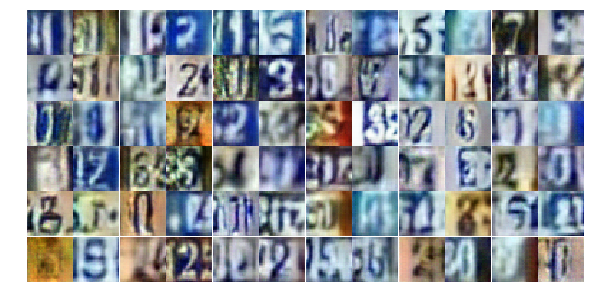

Batch 326    Epoch 9/25    Discriminator Loss: 0.7910... Generator Loss: 0.9452
Batch 336    Epoch 9/25    Discriminator Loss: 0.7051... Generator Loss: 1.2129
Batch 346    Epoch 9/25    Discriminator Loss: 0.8392... Generator Loss: 0.8036
Batch 356    Epoch 9/25    Discriminator Loss: 0.7102... Generator Loss: 1.9387
Batch 366    Epoch 9/25    Discriminator Loss: 0.7425... Generator Loss: 0.9960
Batch 376    Epoch 9/25    Discriminator Loss: 0.9607... Generator Loss: 0.7188
Batch 386    Epoch 9/25    Discriminator Loss: 0.6565... Generator Loss: 1.5748
Batch 396    Epoch 9/25    Discriminator Loss: 0.5069... Generator Loss: 1.4117
Batch 406    Epoch 9/25    Discriminator Loss: 1.2109... Generator Loss: 0.4894
Batch 416    Epoch 9/25    Discriminator Loss: 0.8380... Generator Loss: 0.7952


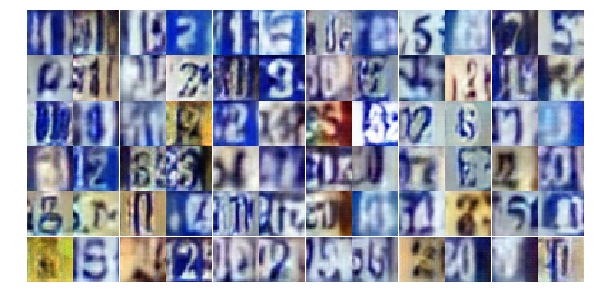

Batch 426    Epoch 9/25    Discriminator Loss: 0.5694... Generator Loss: 1.1192
Batch 436    Epoch 9/25    Discriminator Loss: 0.7860... Generator Loss: 0.9226
Batch 446    Epoch 9/25    Discriminator Loss: 0.7940... Generator Loss: 0.9709
Batch 456    Epoch 9/25    Discriminator Loss: 0.7523... Generator Loss: 1.8084
Batch 466    Epoch 9/25    Discriminator Loss: 0.5159... Generator Loss: 1.3649
Batch 476    Epoch 9/25    Discriminator Loss: 1.6232... Generator Loss: 0.3125
Batch 486    Epoch 9/25    Discriminator Loss: 0.9332... Generator Loss: 0.8179
Batch 496    Epoch 9/25    Discriminator Loss: 0.6740... Generator Loss: 1.0973
Batch 506    Epoch 9/25    Discriminator Loss: 0.7922... Generator Loss: 0.8618
Batch 516    Epoch 9/25    Discriminator Loss: 0.6583... Generator Loss: 1.9360


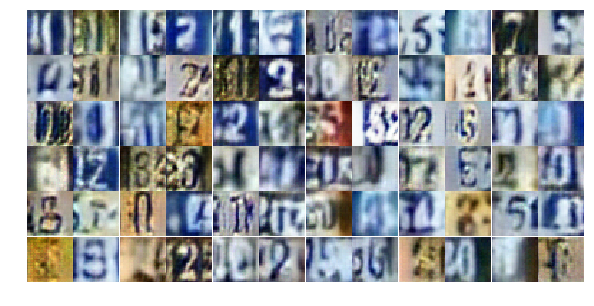

Batch 526    Epoch 9/25    Discriminator Loss: 1.0280... Generator Loss: 0.6409
Batch 536    Epoch 9/25    Discriminator Loss: 1.2856... Generator Loss: 3.3409
Batch 546    Epoch 9/25    Discriminator Loss: 0.8165... Generator Loss: 0.8996
Batch 556    Epoch 9/25    Discriminator Loss: 1.5320... Generator Loss: 0.3141
Batch 566    Epoch 9/25    Discriminator Loss: 0.7871... Generator Loss: 0.9416
Batch 3    Epoch 10/25    Discriminator Loss: 1.0198... Generator Loss: 0.6815
Batch 13    Epoch 10/25    Discriminator Loss: 0.6610... Generator Loss: 1.2162
Batch 23    Epoch 10/25    Discriminator Loss: 0.8866... Generator Loss: 0.7638
Batch 33    Epoch 10/25    Discriminator Loss: 1.1553... Generator Loss: 0.5448
Batch 43    Epoch 10/25    Discriminator Loss: 1.6112... Generator Loss: 0.2948


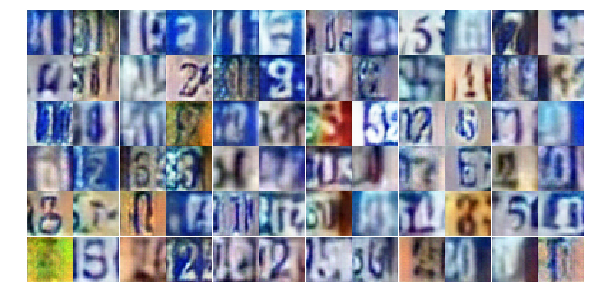

Batch 53    Epoch 10/25    Discriminator Loss: 1.1203... Generator Loss: 0.5481
Batch 63    Epoch 10/25    Discriminator Loss: 0.6951... Generator Loss: 1.2613
Batch 73    Epoch 10/25    Discriminator Loss: 0.8517... Generator Loss: 0.8340
Batch 83    Epoch 10/25    Discriminator Loss: 0.6443... Generator Loss: 1.4267
Batch 93    Epoch 10/25    Discriminator Loss: 0.7616... Generator Loss: 1.5605
Batch 103    Epoch 10/25    Discriminator Loss: 0.7293... Generator Loss: 1.3468
Batch 113    Epoch 10/25    Discriminator Loss: 0.6670... Generator Loss: 1.0161
Batch 123    Epoch 10/25    Discriminator Loss: 1.1964... Generator Loss: 0.4987
Batch 133    Epoch 10/25    Discriminator Loss: 1.1814... Generator Loss: 0.5799
Batch 143    Epoch 10/25    Discriminator Loss: 0.8044... Generator Loss: 0.9043


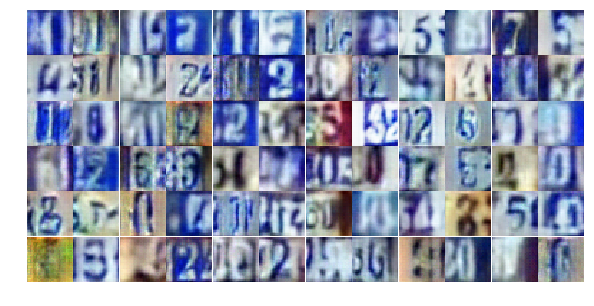

Batch 153    Epoch 10/25    Discriminator Loss: 0.6397... Generator Loss: 1.4677
Batch 163    Epoch 10/25    Discriminator Loss: 1.3151... Generator Loss: 0.4292
Batch 173    Epoch 10/25    Discriminator Loss: 0.7150... Generator Loss: 1.1258
Batch 183    Epoch 10/25    Discriminator Loss: 1.3035... Generator Loss: 0.4654
Batch 193    Epoch 10/25    Discriminator Loss: 0.6654... Generator Loss: 1.4016
Batch 203    Epoch 10/25    Discriminator Loss: 0.6983... Generator Loss: 1.0542
Batch 213    Epoch 10/25    Discriminator Loss: 0.9885... Generator Loss: 0.6447
Batch 223    Epoch 10/25    Discriminator Loss: 0.8019... Generator Loss: 1.8353
Batch 233    Epoch 10/25    Discriminator Loss: 0.9891... Generator Loss: 0.8668
Batch 243    Epoch 10/25    Discriminator Loss: 0.6354... Generator Loss: 2.4074


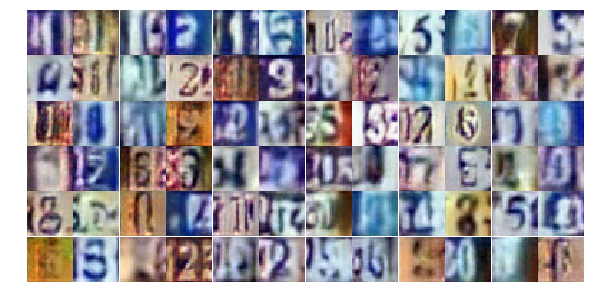

Batch 253    Epoch 10/25    Discriminator Loss: 1.3215... Generator Loss: 0.4615
Batch 263    Epoch 10/25    Discriminator Loss: 0.9592... Generator Loss: 0.7398
Batch 273    Epoch 10/25    Discriminator Loss: 0.5311... Generator Loss: 1.2469
Batch 283    Epoch 10/25    Discriminator Loss: 0.6140... Generator Loss: 1.9939
Batch 293    Epoch 10/25    Discriminator Loss: 1.5154... Generator Loss: 0.3341
Batch 303    Epoch 10/25    Discriminator Loss: 0.6736... Generator Loss: 1.1954
Batch 313    Epoch 10/25    Discriminator Loss: 0.4216... Generator Loss: 1.5010
Batch 323    Epoch 10/25    Discriminator Loss: 0.9591... Generator Loss: 1.7467
Batch 333    Epoch 10/25    Discriminator Loss: 0.8252... Generator Loss: 0.8175
Batch 343    Epoch 10/25    Discriminator Loss: 1.0309... Generator Loss: 0.6520


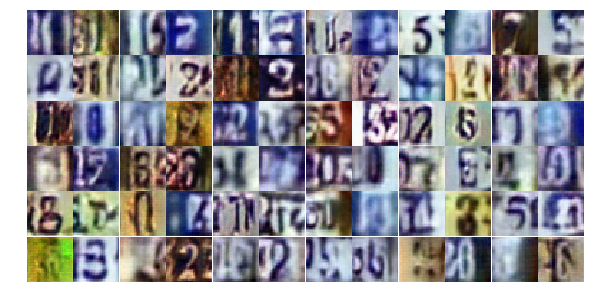

Batch 353    Epoch 10/25    Discriminator Loss: 0.6130... Generator Loss: 1.4895
Batch 363    Epoch 10/25    Discriminator Loss: 0.8358... Generator Loss: 0.8805
Batch 373    Epoch 10/25    Discriminator Loss: 0.9677... Generator Loss: 2.0535
Batch 383    Epoch 10/25    Discriminator Loss: 0.6045... Generator Loss: 1.6060
Batch 393    Epoch 10/25    Discriminator Loss: 0.8088... Generator Loss: 0.8840
Batch 403    Epoch 10/25    Discriminator Loss: 0.6447... Generator Loss: 1.0910
Batch 413    Epoch 10/25    Discriminator Loss: 0.9930... Generator Loss: 0.6217
Batch 423    Epoch 10/25    Discriminator Loss: 1.3565... Generator Loss: 0.4222
Batch 433    Epoch 10/25    Discriminator Loss: 0.8709... Generator Loss: 0.8808
Batch 443    Epoch 10/25    Discriminator Loss: 2.1295... Generator Loss: 1.8762


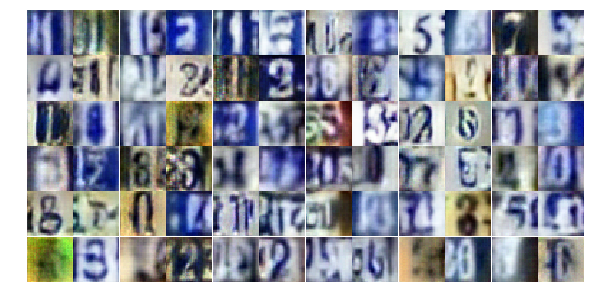

Batch 453    Epoch 10/25    Discriminator Loss: 0.6103... Generator Loss: 1.3083
Batch 463    Epoch 10/25    Discriminator Loss: 0.7343... Generator Loss: 1.0310
Batch 473    Epoch 10/25    Discriminator Loss: 1.0014... Generator Loss: 0.9011
Batch 483    Epoch 10/25    Discriminator Loss: 0.7585... Generator Loss: 1.3177
Batch 493    Epoch 10/25    Discriminator Loss: 0.5944... Generator Loss: 1.4995
Batch 503    Epoch 10/25    Discriminator Loss: 0.9692... Generator Loss: 0.6983
Batch 513    Epoch 10/25    Discriminator Loss: 0.6417... Generator Loss: 1.0686
Batch 523    Epoch 10/25    Discriminator Loss: 0.6377... Generator Loss: 1.3003
Batch 533    Epoch 10/25    Discriminator Loss: 0.8201... Generator Loss: 1.6256
Batch 543    Epoch 10/25    Discriminator Loss: 0.5418... Generator Loss: 1.3840


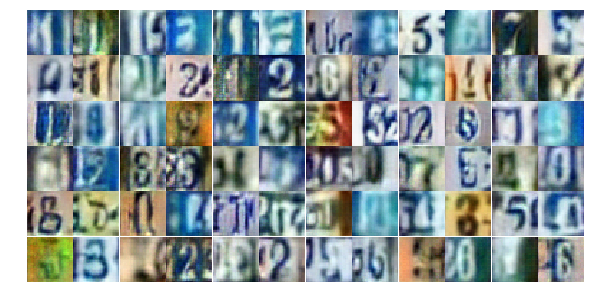

Batch 553    Epoch 10/25    Discriminator Loss: 1.1014... Generator Loss: 1.8898
Batch 563    Epoch 10/25    Discriminator Loss: 0.8054... Generator Loss: 0.8743
Batch 573    Epoch 10/25    Discriminator Loss: 0.5770... Generator Loss: 1.2456
Batch 10    Epoch 11/25    Discriminator Loss: 0.9547... Generator Loss: 0.6693
Batch 20    Epoch 11/25    Discriminator Loss: 0.9377... Generator Loss: 0.9003
Batch 30    Epoch 11/25    Discriminator Loss: 1.5723... Generator Loss: 0.3240
Batch 40    Epoch 11/25    Discriminator Loss: 1.1877... Generator Loss: 0.5214
Batch 50    Epoch 11/25    Discriminator Loss: 1.4046... Generator Loss: 0.3857
Batch 60    Epoch 11/25    Discriminator Loss: 1.8293... Generator Loss: 0.2421
Batch 70    Epoch 11/25    Discriminator Loss: 0.7313... Generator Loss: 1.0225


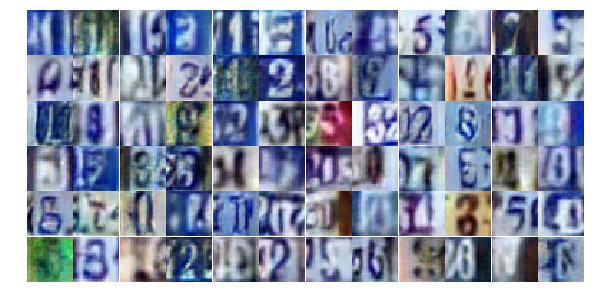

Batch 80    Epoch 11/25    Discriminator Loss: 0.7354... Generator Loss: 1.0276
Batch 90    Epoch 11/25    Discriminator Loss: 1.0174... Generator Loss: 0.6187
Batch 100    Epoch 11/25    Discriminator Loss: 0.7367... Generator Loss: 0.9682
Batch 110    Epoch 11/25    Discriminator Loss: 0.8278... Generator Loss: 0.8084
Batch 120    Epoch 11/25    Discriminator Loss: 1.0860... Generator Loss: 0.5946
Batch 130    Epoch 11/25    Discriminator Loss: 0.4827... Generator Loss: 1.5648
Batch 140    Epoch 11/25    Discriminator Loss: 0.9341... Generator Loss: 1.3524
Batch 150    Epoch 11/25    Discriminator Loss: 0.5308... Generator Loss: 1.4207
Batch 160    Epoch 11/25    Discriminator Loss: 0.7979... Generator Loss: 0.8998
Batch 170    Epoch 11/25    Discriminator Loss: 1.4364... Generator Loss: 0.3858


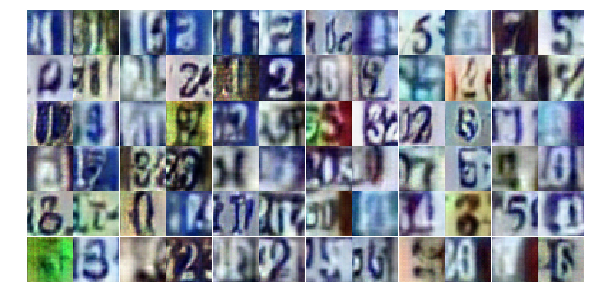

Batch 180    Epoch 11/25    Discriminator Loss: 0.7996... Generator Loss: 0.8908
Batch 190    Epoch 11/25    Discriminator Loss: 0.5024... Generator Loss: 1.7916
Batch 200    Epoch 11/25    Discriminator Loss: 0.9896... Generator Loss: 0.6985
Batch 210    Epoch 11/25    Discriminator Loss: 1.0194... Generator Loss: 0.6079
Batch 220    Epoch 11/25    Discriminator Loss: 0.5036... Generator Loss: 1.4497
Batch 230    Epoch 11/25    Discriminator Loss: 0.3640... Generator Loss: 1.8092
Batch 240    Epoch 11/25    Discriminator Loss: 0.5661... Generator Loss: 1.5390
Batch 250    Epoch 11/25    Discriminator Loss: 1.3789... Generator Loss: 0.4011
Batch 260    Epoch 11/25    Discriminator Loss: 0.5417... Generator Loss: 1.3518
Batch 270    Epoch 11/25    Discriminator Loss: 1.1665... Generator Loss: 0.4926


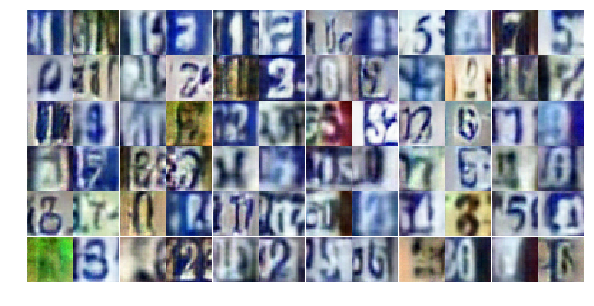

Batch 280    Epoch 11/25    Discriminator Loss: 0.9391... Generator Loss: 0.7495
Batch 290    Epoch 11/25    Discriminator Loss: 0.5965... Generator Loss: 1.2225
Batch 300    Epoch 11/25    Discriminator Loss: 1.0830... Generator Loss: 0.5745
Batch 310    Epoch 11/25    Discriminator Loss: 0.6283... Generator Loss: 1.2094
Batch 320    Epoch 11/25    Discriminator Loss: 0.9671... Generator Loss: 0.6308
Batch 330    Epoch 11/25    Discriminator Loss: 0.9812... Generator Loss: 0.6759
Batch 340    Epoch 11/25    Discriminator Loss: 1.3119... Generator Loss: 0.4276
Batch 350    Epoch 11/25    Discriminator Loss: 1.4146... Generator Loss: 0.3727
Batch 360    Epoch 11/25    Discriminator Loss: 0.4792... Generator Loss: 1.5632
Batch 370    Epoch 11/25    Discriminator Loss: 1.5280... Generator Loss: 0.3196


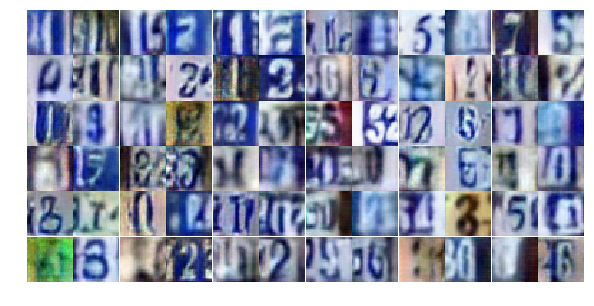

Batch 380    Epoch 11/25    Discriminator Loss: 0.6879... Generator Loss: 1.0905
Batch 390    Epoch 11/25    Discriminator Loss: 0.8808... Generator Loss: 0.7298
Batch 400    Epoch 11/25    Discriminator Loss: 0.8259... Generator Loss: 0.8911
Batch 410    Epoch 11/25    Discriminator Loss: 0.7002... Generator Loss: 1.3543
Batch 420    Epoch 11/25    Discriminator Loss: 1.3116... Generator Loss: 0.4785
Batch 430    Epoch 11/25    Discriminator Loss: 0.8067... Generator Loss: 0.8647
Batch 440    Epoch 11/25    Discriminator Loss: 0.7045... Generator Loss: 1.1820
Batch 450    Epoch 11/25    Discriminator Loss: 0.9826... Generator Loss: 0.6511
Batch 460    Epoch 11/25    Discriminator Loss: 1.0826... Generator Loss: 0.6243
Batch 470    Epoch 11/25    Discriminator Loss: 0.8204... Generator Loss: 0.8053


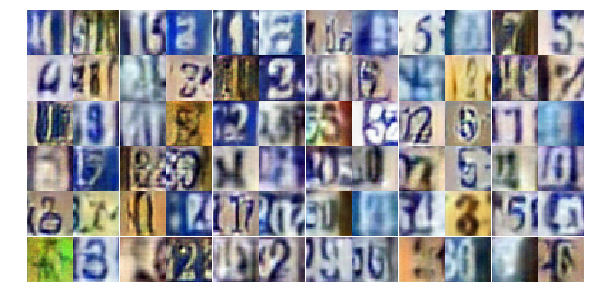

Batch 480    Epoch 11/25    Discriminator Loss: 0.8312... Generator Loss: 0.9471
Batch 490    Epoch 11/25    Discriminator Loss: 0.6284... Generator Loss: 1.3176
Batch 500    Epoch 11/25    Discriminator Loss: 0.7926... Generator Loss: 0.9661
Batch 510    Epoch 11/25    Discriminator Loss: 0.7595... Generator Loss: 0.8867
Batch 520    Epoch 11/25    Discriminator Loss: 1.6003... Generator Loss: 2.6487
Batch 530    Epoch 11/25    Discriminator Loss: 0.8431... Generator Loss: 1.1470
Batch 540    Epoch 11/25    Discriminator Loss: 0.6547... Generator Loss: 1.3525
Batch 550    Epoch 11/25    Discriminator Loss: 0.5923... Generator Loss: 1.3093
Batch 560    Epoch 11/25    Discriminator Loss: 0.9186... Generator Loss: 0.7012
Batch 570    Epoch 11/25    Discriminator Loss: 0.8653... Generator Loss: 0.7742


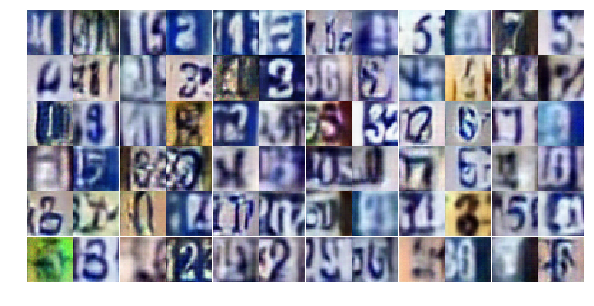

Batch 7    Epoch 12/25    Discriminator Loss: 0.6712... Generator Loss: 1.3495
Batch 17    Epoch 12/25    Discriminator Loss: 0.7222... Generator Loss: 1.2278
Batch 27    Epoch 12/25    Discriminator Loss: 0.9194... Generator Loss: 0.8885
Batch 37    Epoch 12/25    Discriminator Loss: 0.7088... Generator Loss: 1.3322
Batch 47    Epoch 12/25    Discriminator Loss: 0.5289... Generator Loss: 1.2413
Batch 57    Epoch 12/25    Discriminator Loss: 1.6160... Generator Loss: 0.2984
Batch 67    Epoch 12/25    Discriminator Loss: 0.7682... Generator Loss: 1.0803
Batch 77    Epoch 12/25    Discriminator Loss: 0.6971... Generator Loss: 1.0724
Batch 87    Epoch 12/25    Discriminator Loss: 1.1142... Generator Loss: 0.5592
Batch 97    Epoch 12/25    Discriminator Loss: 1.4840... Generator Loss: 0.3683


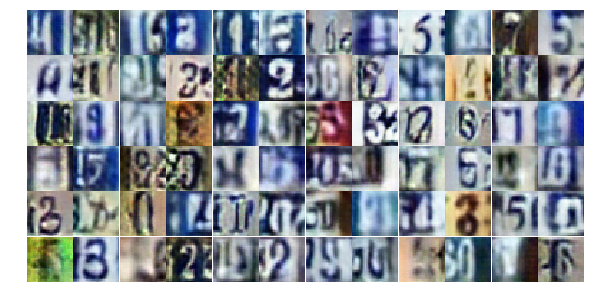

Batch 107    Epoch 12/25    Discriminator Loss: 0.5980... Generator Loss: 1.1939
Batch 117    Epoch 12/25    Discriminator Loss: 0.9922... Generator Loss: 0.6692
Batch 127    Epoch 12/25    Discriminator Loss: 0.7485... Generator Loss: 1.1038
Batch 137    Epoch 12/25    Discriminator Loss: 0.7844... Generator Loss: 0.8945
Batch 147    Epoch 12/25    Discriminator Loss: 0.6644... Generator Loss: 1.1662
Batch 157    Epoch 12/25    Discriminator Loss: 0.9634... Generator Loss: 0.8112
Batch 167    Epoch 12/25    Discriminator Loss: 1.5407... Generator Loss: 0.3648
Batch 177    Epoch 12/25    Discriminator Loss: 0.5064... Generator Loss: 1.9907
Batch 187    Epoch 12/25    Discriminator Loss: 0.6276... Generator Loss: 1.1129
Batch 197    Epoch 12/25    Discriminator Loss: 0.7900... Generator Loss: 0.8454


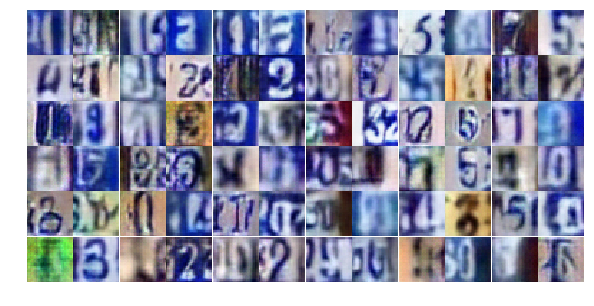

Batch 207    Epoch 12/25    Discriminator Loss: 0.4840... Generator Loss: 1.8212
Batch 217    Epoch 12/25    Discriminator Loss: 0.4622... Generator Loss: 1.9337
Batch 227    Epoch 12/25    Discriminator Loss: 1.2309... Generator Loss: 0.4653
Batch 237    Epoch 12/25    Discriminator Loss: 0.7156... Generator Loss: 2.1261
Batch 247    Epoch 12/25    Discriminator Loss: 0.5612... Generator Loss: 1.7868
Batch 257    Epoch 12/25    Discriminator Loss: 0.6306... Generator Loss: 0.9708
Batch 267    Epoch 12/25    Discriminator Loss: 0.9366... Generator Loss: 0.7130
Batch 277    Epoch 12/25    Discriminator Loss: 0.5468... Generator Loss: 1.2674
Batch 287    Epoch 12/25    Discriminator Loss: 0.6701... Generator Loss: 1.0320
Batch 297    Epoch 12/25    Discriminator Loss: 0.7210... Generator Loss: 0.9837


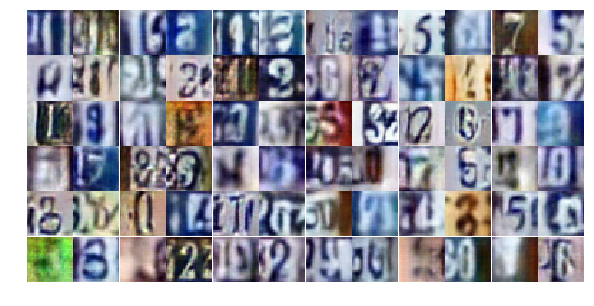

Batch 307    Epoch 12/25    Discriminator Loss: 0.7850... Generator Loss: 0.8667
Batch 317    Epoch 12/25    Discriminator Loss: 0.9818... Generator Loss: 0.7278
Batch 327    Epoch 12/25    Discriminator Loss: 0.8731... Generator Loss: 0.7777
Batch 337    Epoch 12/25    Discriminator Loss: 1.7816... Generator Loss: 0.2730
Batch 347    Epoch 12/25    Discriminator Loss: 0.6272... Generator Loss: 1.6425
Batch 357    Epoch 12/25    Discriminator Loss: 0.7745... Generator Loss: 1.0321
Batch 367    Epoch 12/25    Discriminator Loss: 1.3497... Generator Loss: 0.4000
Batch 377    Epoch 12/25    Discriminator Loss: 0.8765... Generator Loss: 0.7925
Batch 387    Epoch 12/25    Discriminator Loss: 0.8665... Generator Loss: 0.8303
Batch 397    Epoch 12/25    Discriminator Loss: 0.4060... Generator Loss: 1.7907


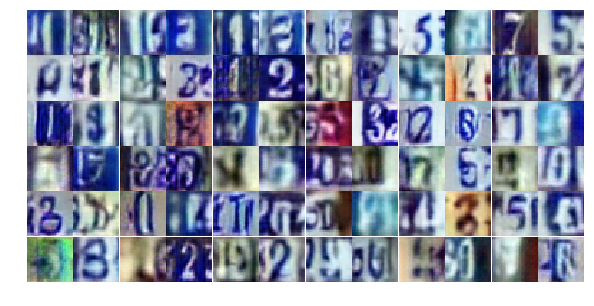

Batch 407    Epoch 12/25    Discriminator Loss: 0.9423... Generator Loss: 0.6898
Batch 417    Epoch 12/25    Discriminator Loss: 0.4195... Generator Loss: 1.6400
Batch 427    Epoch 12/25    Discriminator Loss: 0.3843... Generator Loss: 2.1484
Batch 437    Epoch 12/25    Discriminator Loss: 1.1032... Generator Loss: 0.5499
Batch 447    Epoch 12/25    Discriminator Loss: 0.7376... Generator Loss: 0.9863
Batch 457    Epoch 12/25    Discriminator Loss: 0.7965... Generator Loss: 0.8685
Batch 467    Epoch 12/25    Discriminator Loss: 0.5528... Generator Loss: 1.3396
Batch 477    Epoch 12/25    Discriminator Loss: 0.8452... Generator Loss: 0.9995
Batch 487    Epoch 12/25    Discriminator Loss: 0.6130... Generator Loss: 1.1826
Batch 497    Epoch 12/25    Discriminator Loss: 0.5708... Generator Loss: 1.8820


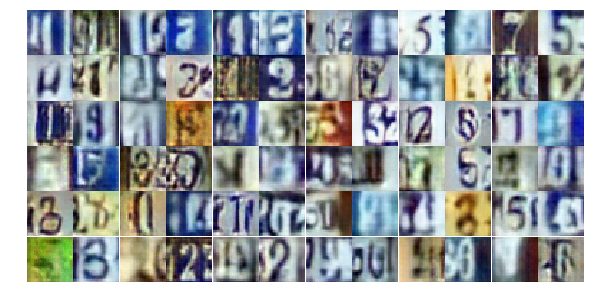

Batch 507    Epoch 12/25    Discriminator Loss: 1.2779... Generator Loss: 0.4399
Batch 517    Epoch 12/25    Discriminator Loss: 0.9328... Generator Loss: 0.7571
Batch 527    Epoch 12/25    Discriminator Loss: 0.9270... Generator Loss: 2.2202
Batch 537    Epoch 12/25    Discriminator Loss: 1.4370... Generator Loss: 0.4057
Batch 547    Epoch 12/25    Discriminator Loss: 0.6481... Generator Loss: 1.0793
Batch 557    Epoch 12/25    Discriminator Loss: 0.7392... Generator Loss: 1.1762
Batch 567    Epoch 12/25    Discriminator Loss: 0.9369... Generator Loss: 0.8069
Batch 4    Epoch 13/25    Discriminator Loss: 0.8975... Generator Loss: 2.5822
Batch 14    Epoch 13/25    Discriminator Loss: 0.7350... Generator Loss: 1.3718
Batch 24    Epoch 13/25    Discriminator Loss: 0.8097... Generator Loss: 0.8698


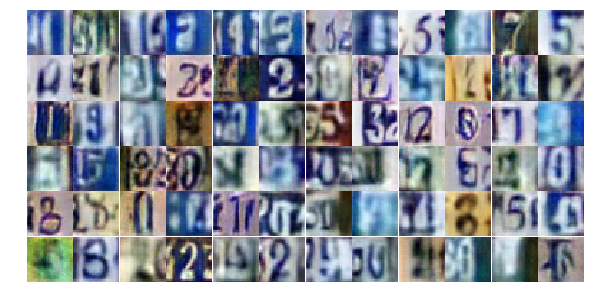

Batch 34    Epoch 13/25    Discriminator Loss: 0.7681... Generator Loss: 1.0099
Batch 44    Epoch 13/25    Discriminator Loss: 0.6420... Generator Loss: 1.6526
Batch 54    Epoch 13/25    Discriminator Loss: 1.1830... Generator Loss: 0.6811
Batch 64    Epoch 13/25    Discriminator Loss: 0.9975... Generator Loss: 0.8749
Batch 74    Epoch 13/25    Discriminator Loss: 0.6705... Generator Loss: 1.0317
Batch 84    Epoch 13/25    Discriminator Loss: 0.7998... Generator Loss: 0.8458
Batch 94    Epoch 13/25    Discriminator Loss: 0.5298... Generator Loss: 1.6817
Batch 104    Epoch 13/25    Discriminator Loss: 0.8519... Generator Loss: 0.7567
Batch 114    Epoch 13/25    Discriminator Loss: 0.8576... Generator Loss: 0.7306
Batch 124    Epoch 13/25    Discriminator Loss: 0.5402... Generator Loss: 1.5706


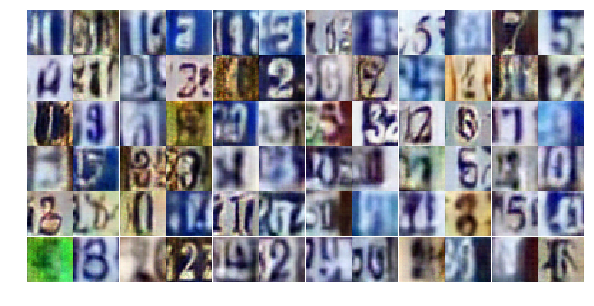

Batch 134    Epoch 13/25    Discriminator Loss: 0.7937... Generator Loss: 0.9490
Batch 144    Epoch 13/25    Discriminator Loss: 0.7024... Generator Loss: 1.1830
Batch 154    Epoch 13/25    Discriminator Loss: 1.5601... Generator Loss: 0.3616
Batch 164    Epoch 13/25    Discriminator Loss: 0.9684... Generator Loss: 0.7636
Batch 174    Epoch 13/25    Discriminator Loss: 0.8278... Generator Loss: 0.9712
Batch 184    Epoch 13/25    Discriminator Loss: 1.2816... Generator Loss: 0.4503
Batch 194    Epoch 13/25    Discriminator Loss: 1.0140... Generator Loss: 0.6789
Batch 204    Epoch 13/25    Discriminator Loss: 1.2170... Generator Loss: 0.5440
Batch 214    Epoch 13/25    Discriminator Loss: 0.5639... Generator Loss: 1.4096
Batch 224    Epoch 13/25    Discriminator Loss: 1.5872... Generator Loss: 0.3144


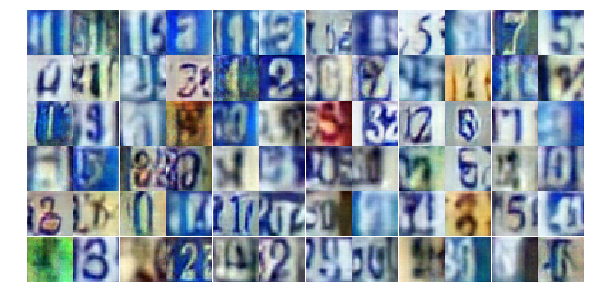

Batch 234    Epoch 13/25    Discriminator Loss: 1.0601... Generator Loss: 0.6663
Batch 244    Epoch 13/25    Discriminator Loss: 0.6866... Generator Loss: 1.3206
Batch 254    Epoch 13/25    Discriminator Loss: 0.7562... Generator Loss: 1.3555
Batch 264    Epoch 13/25    Discriminator Loss: 0.9427... Generator Loss: 0.7713
Batch 274    Epoch 13/25    Discriminator Loss: 0.8126... Generator Loss: 0.8741
Batch 284    Epoch 13/25    Discriminator Loss: 0.9938... Generator Loss: 0.7277
Batch 294    Epoch 13/25    Discriminator Loss: 0.8277... Generator Loss: 1.0210
Batch 304    Epoch 13/25    Discriminator Loss: 0.5710... Generator Loss: 1.4831
Batch 314    Epoch 13/25    Discriminator Loss: 0.7436... Generator Loss: 0.9743
Batch 324    Epoch 13/25    Discriminator Loss: 0.6195... Generator Loss: 1.1302


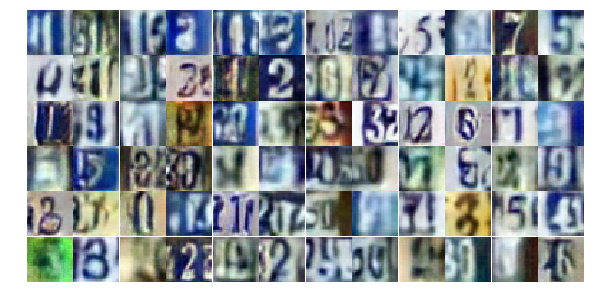

Batch 334    Epoch 13/25    Discriminator Loss: 1.2255... Generator Loss: 0.5814
Batch 344    Epoch 13/25    Discriminator Loss: 1.1449... Generator Loss: 0.6646
Batch 354    Epoch 13/25    Discriminator Loss: 1.7918... Generator Loss: 0.3128
Batch 364    Epoch 13/25    Discriminator Loss: 1.5539... Generator Loss: 0.3256
Batch 374    Epoch 13/25    Discriminator Loss: 0.7139... Generator Loss: 1.2012
Batch 384    Epoch 13/25    Discriminator Loss: 0.5724... Generator Loss: 1.5286
Batch 394    Epoch 13/25    Discriminator Loss: 0.6885... Generator Loss: 1.1612
Batch 404    Epoch 13/25    Discriminator Loss: 1.1274... Generator Loss: 0.8895
Batch 414    Epoch 13/25    Discriminator Loss: 0.7113... Generator Loss: 1.1627
Batch 424    Epoch 13/25    Discriminator Loss: 0.8701... Generator Loss: 0.8789


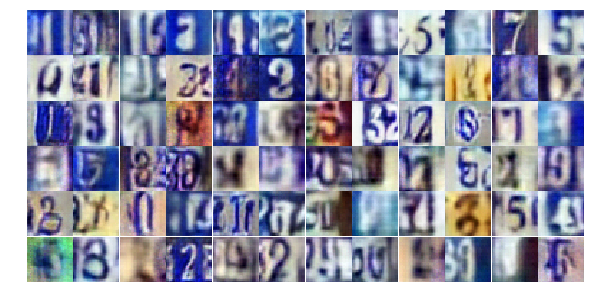

Batch 434    Epoch 13/25    Discriminator Loss: 0.8720... Generator Loss: 0.8998
Batch 444    Epoch 13/25    Discriminator Loss: 1.3040... Generator Loss: 0.4777
Batch 454    Epoch 13/25    Discriminator Loss: 1.0016... Generator Loss: 0.6505
Batch 464    Epoch 13/25    Discriminator Loss: 0.6985... Generator Loss: 1.0179
Batch 474    Epoch 13/25    Discriminator Loss: 1.0945... Generator Loss: 0.6338
Batch 484    Epoch 13/25    Discriminator Loss: 0.8966... Generator Loss: 0.7576
Batch 494    Epoch 13/25    Discriminator Loss: 1.3973... Generator Loss: 0.4046
Batch 504    Epoch 13/25    Discriminator Loss: 0.9670... Generator Loss: 0.7398
Batch 514    Epoch 13/25    Discriminator Loss: 0.9540... Generator Loss: 0.6932
Batch 524    Epoch 13/25    Discriminator Loss: 1.2406... Generator Loss: 0.5118


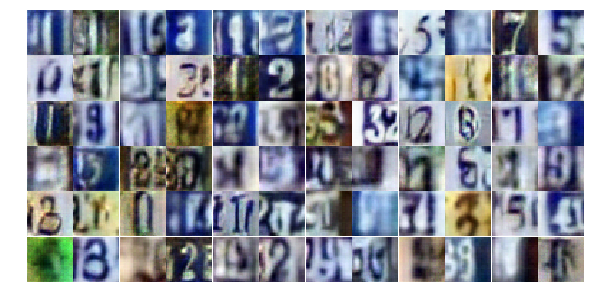

Batch 534    Epoch 13/25    Discriminator Loss: 0.4523... Generator Loss: 1.6796
Batch 544    Epoch 13/25    Discriminator Loss: 1.0748... Generator Loss: 0.6003
Batch 554    Epoch 13/25    Discriminator Loss: 0.9375... Generator Loss: 0.7490
Batch 564    Epoch 13/25    Discriminator Loss: 1.1728... Generator Loss: 0.5136
Batch 1    Epoch 14/25    Discriminator Loss: 0.9024... Generator Loss: 0.8077
Batch 11    Epoch 14/25    Discriminator Loss: 1.0382... Generator Loss: 0.6586
Batch 21    Epoch 14/25    Discriminator Loss: 1.0820... Generator Loss: 0.8125
Batch 31    Epoch 14/25    Discriminator Loss: 0.6540... Generator Loss: 1.2255
Batch 41    Epoch 14/25    Discriminator Loss: 0.7520... Generator Loss: 1.2060
Batch 51    Epoch 14/25    Discriminator Loss: 0.9339... Generator Loss: 0.7298


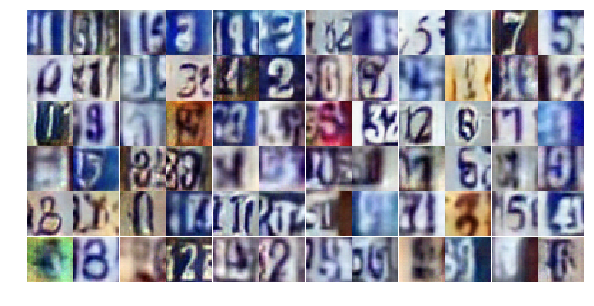

Batch 61    Epoch 14/25    Discriminator Loss: 0.9112... Generator Loss: 0.9688
Batch 71    Epoch 14/25    Discriminator Loss: 1.1435... Generator Loss: 0.5396
Batch 81    Epoch 14/25    Discriminator Loss: 0.6466... Generator Loss: 1.1070
Batch 91    Epoch 14/25    Discriminator Loss: 0.7419... Generator Loss: 0.9512
Batch 101    Epoch 14/25    Discriminator Loss: 1.6833... Generator Loss: 0.2733
Batch 111    Epoch 14/25    Discriminator Loss: 0.5068... Generator Loss: 1.4026
Batch 121    Epoch 14/25    Discriminator Loss: 0.5566... Generator Loss: 1.3885
Batch 131    Epoch 14/25    Discriminator Loss: 1.6019... Generator Loss: 0.3381
Batch 141    Epoch 14/25    Discriminator Loss: 0.9148... Generator Loss: 0.7947
Batch 151    Epoch 14/25    Discriminator Loss: 1.1877... Generator Loss: 0.5160


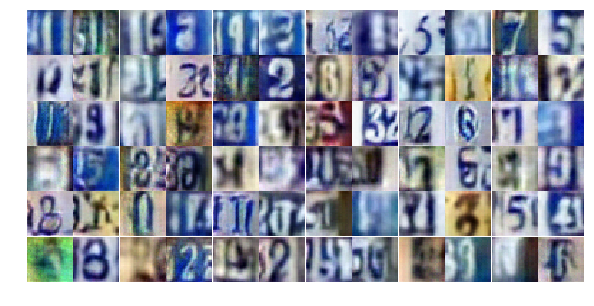

Batch 161    Epoch 14/25    Discriminator Loss: 0.7161... Generator Loss: 0.9133
Batch 171    Epoch 14/25    Discriminator Loss: 0.6096... Generator Loss: 1.8690
Batch 181    Epoch 14/25    Discriminator Loss: 0.9291... Generator Loss: 0.8115
Batch 191    Epoch 14/25    Discriminator Loss: 0.6933... Generator Loss: 1.0667
Batch 201    Epoch 14/25    Discriminator Loss: 0.8209... Generator Loss: 0.9301
Batch 211    Epoch 14/25    Discriminator Loss: 0.8096... Generator Loss: 0.9950
Batch 221    Epoch 14/25    Discriminator Loss: 0.9058... Generator Loss: 0.7536
Batch 231    Epoch 14/25    Discriminator Loss: 0.9195... Generator Loss: 0.7040
Batch 241    Epoch 14/25    Discriminator Loss: 0.6348... Generator Loss: 1.1299
Batch 251    Epoch 14/25    Discriminator Loss: 0.5861... Generator Loss: 1.3939


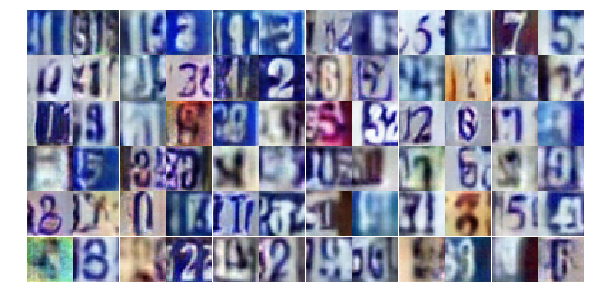

Batch 261    Epoch 14/25    Discriminator Loss: 1.2831... Generator Loss: 0.4843
Batch 271    Epoch 14/25    Discriminator Loss: 0.5174... Generator Loss: 1.3461
Batch 281    Epoch 14/25    Discriminator Loss: 0.5979... Generator Loss: 1.1562
Batch 291    Epoch 14/25    Discriminator Loss: 0.4991... Generator Loss: 1.5532
Batch 301    Epoch 14/25    Discriminator Loss: 0.8555... Generator Loss: 0.8805
Batch 311    Epoch 14/25    Discriminator Loss: 0.7118... Generator Loss: 1.1905
Batch 321    Epoch 14/25    Discriminator Loss: 0.9326... Generator Loss: 0.7414
Batch 331    Epoch 14/25    Discriminator Loss: 0.5397... Generator Loss: 1.4271
Batch 341    Epoch 14/25    Discriminator Loss: 0.5124... Generator Loss: 2.3628
Batch 351    Epoch 14/25    Discriminator Loss: 0.9619... Generator Loss: 1.6573


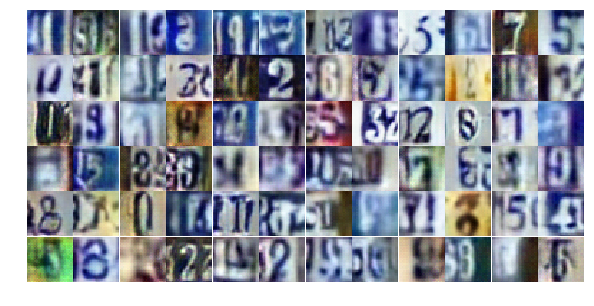

Batch 361    Epoch 14/25    Discriminator Loss: 1.4142... Generator Loss: 0.4343
Batch 371    Epoch 14/25    Discriminator Loss: 1.0707... Generator Loss: 0.5750
Batch 381    Epoch 14/25    Discriminator Loss: 1.0893... Generator Loss: 0.6010
Batch 391    Epoch 14/25    Discriminator Loss: 1.4475... Generator Loss: 0.3889
Batch 401    Epoch 14/25    Discriminator Loss: 1.5263... Generator Loss: 0.3658
Batch 411    Epoch 14/25    Discriminator Loss: 0.6745... Generator Loss: 1.1643
Batch 421    Epoch 14/25    Discriminator Loss: 0.7578... Generator Loss: 1.9188
Batch 431    Epoch 14/25    Discriminator Loss: 0.6091... Generator Loss: 1.3248
Batch 441    Epoch 14/25    Discriminator Loss: 1.1682... Generator Loss: 0.5263
Batch 451    Epoch 14/25    Discriminator Loss: 1.1698... Generator Loss: 0.4855


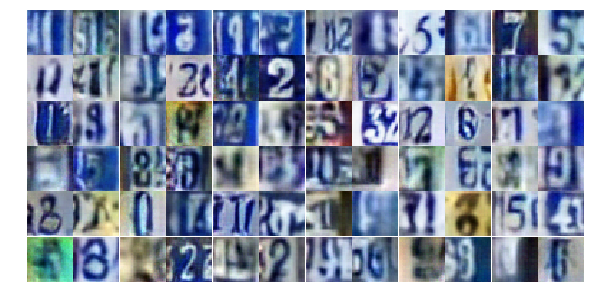

Batch 461    Epoch 14/25    Discriminator Loss: 1.0163... Generator Loss: 1.6371
Batch 471    Epoch 14/25    Discriminator Loss: 1.6289... Generator Loss: 0.3062
Batch 481    Epoch 14/25    Discriminator Loss: 0.7383... Generator Loss: 1.1515
Batch 491    Epoch 14/25    Discriminator Loss: 1.2213... Generator Loss: 0.5385
Batch 501    Epoch 14/25    Discriminator Loss: 0.8648... Generator Loss: 0.8634
Batch 511    Epoch 14/25    Discriminator Loss: 0.8820... Generator Loss: 0.7657
Batch 521    Epoch 14/25    Discriminator Loss: 0.9255... Generator Loss: 0.8117
Batch 531    Epoch 14/25    Discriminator Loss: 0.8839... Generator Loss: 0.7841
Batch 541    Epoch 14/25    Discriminator Loss: 0.9513... Generator Loss: 0.8305
Batch 551    Epoch 14/25    Discriminator Loss: 1.2765... Generator Loss: 0.4243


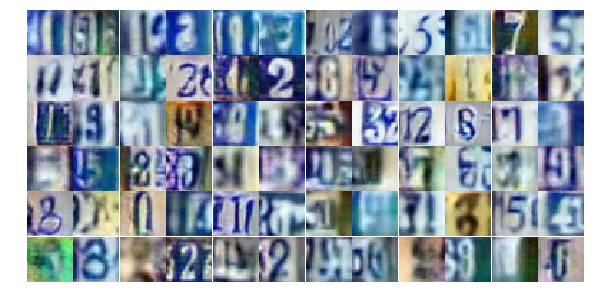

Batch 561    Epoch 14/25    Discriminator Loss: 1.1148... Generator Loss: 0.8388
Batch 571    Epoch 14/25    Discriminator Loss: 1.0276... Generator Loss: 1.8867
Batch 8    Epoch 15/25    Discriminator Loss: 0.8011... Generator Loss: 0.9454
Batch 18    Epoch 15/25    Discriminator Loss: 0.6567... Generator Loss: 1.3517
Batch 28    Epoch 15/25    Discriminator Loss: 0.8298... Generator Loss: 1.0250
Batch 38    Epoch 15/25    Discriminator Loss: 0.9768... Generator Loss: 0.6447
Batch 48    Epoch 15/25    Discriminator Loss: 0.9532... Generator Loss: 0.6563
Batch 58    Epoch 15/25    Discriminator Loss: 0.8305... Generator Loss: 0.8359
Batch 68    Epoch 15/25    Discriminator Loss: 1.1934... Generator Loss: 0.6122
Batch 78    Epoch 15/25    Discriminator Loss: 0.7245... Generator Loss: 0.8933


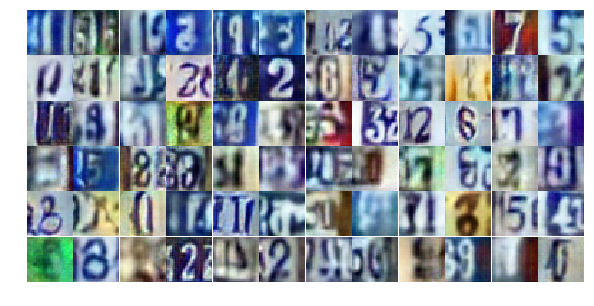

Batch 88    Epoch 15/25    Discriminator Loss: 0.9356... Generator Loss: 0.6800
Batch 98    Epoch 15/25    Discriminator Loss: 0.7836... Generator Loss: 1.5901
Batch 108    Epoch 15/25    Discriminator Loss: 0.8170... Generator Loss: 1.1771
Batch 118    Epoch 15/25    Discriminator Loss: 0.8228... Generator Loss: 0.8753
Batch 128    Epoch 15/25    Discriminator Loss: 1.0990... Generator Loss: 0.6071
Batch 138    Epoch 15/25    Discriminator Loss: 0.6196... Generator Loss: 1.8535
Batch 148    Epoch 15/25    Discriminator Loss: 1.3693... Generator Loss: 0.4427
Batch 158    Epoch 15/25    Discriminator Loss: 1.1042... Generator Loss: 1.7834
Batch 168    Epoch 15/25    Discriminator Loss: 0.8992... Generator Loss: 2.1581
Batch 178    Epoch 15/25    Discriminator Loss: 1.1924... Generator Loss: 0.5022


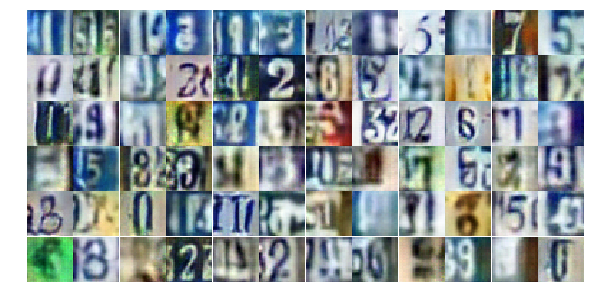

Batch 188    Epoch 15/25    Discriminator Loss: 1.1345... Generator Loss: 0.5578
Batch 198    Epoch 15/25    Discriminator Loss: 0.6517... Generator Loss: 1.2969
Batch 208    Epoch 15/25    Discriminator Loss: 0.8676... Generator Loss: 0.8503
Batch 218    Epoch 15/25    Discriminator Loss: 1.2476... Generator Loss: 0.4835
Batch 228    Epoch 15/25    Discriminator Loss: 1.1801... Generator Loss: 0.6882
Batch 238    Epoch 15/25    Discriminator Loss: 0.8027... Generator Loss: 0.9933
Batch 248    Epoch 15/25    Discriminator Loss: 1.0167... Generator Loss: 0.6436
Batch 258    Epoch 15/25    Discriminator Loss: 0.9677... Generator Loss: 0.6653
Batch 268    Epoch 15/25    Discriminator Loss: 0.6102... Generator Loss: 1.2783
Batch 278    Epoch 15/25    Discriminator Loss: 1.1206... Generator Loss: 0.6170


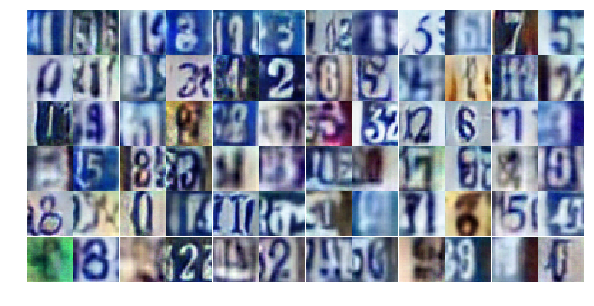

Batch 288    Epoch 15/25    Discriminator Loss: 0.7482... Generator Loss: 1.0271
Batch 298    Epoch 15/25    Discriminator Loss: 1.1532... Generator Loss: 0.5306
Batch 308    Epoch 15/25    Discriminator Loss: 0.5246... Generator Loss: 1.6233
Batch 318    Epoch 15/25    Discriminator Loss: 0.9465... Generator Loss: 0.7590
Batch 328    Epoch 15/25    Discriminator Loss: 0.7037... Generator Loss: 0.9453
Batch 338    Epoch 15/25    Discriminator Loss: 1.3423... Generator Loss: 2.6901
Batch 348    Epoch 15/25    Discriminator Loss: 0.5773... Generator Loss: 1.2693
Batch 358    Epoch 15/25    Discriminator Loss: 0.6962... Generator Loss: 1.2303
Batch 368    Epoch 15/25    Discriminator Loss: 0.7195... Generator Loss: 0.9454
Batch 378    Epoch 15/25    Discriminator Loss: 0.7780... Generator Loss: 0.9663


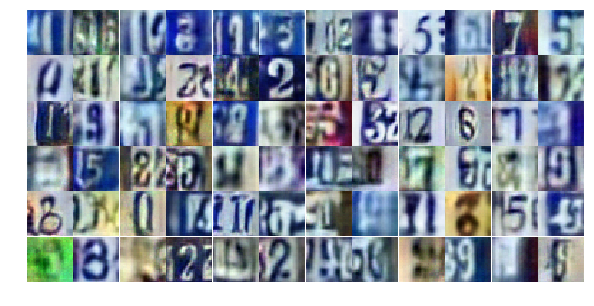

Batch 388    Epoch 15/25    Discriminator Loss: 0.7627... Generator Loss: 1.0419
Batch 398    Epoch 15/25    Discriminator Loss: 1.5617... Generator Loss: 0.3349
Batch 408    Epoch 15/25    Discriminator Loss: 0.7769... Generator Loss: 1.1368
Batch 418    Epoch 15/25    Discriminator Loss: 0.7023... Generator Loss: 0.9674
Batch 428    Epoch 15/25    Discriminator Loss: 0.6281... Generator Loss: 0.9705
Batch 438    Epoch 15/25    Discriminator Loss: 2.2022... Generator Loss: 0.1929
Batch 448    Epoch 15/25    Discriminator Loss: 0.7014... Generator Loss: 1.2919
Batch 458    Epoch 15/25    Discriminator Loss: 0.9081... Generator Loss: 0.7605
Batch 468    Epoch 15/25    Discriminator Loss: 0.7752... Generator Loss: 1.3248
Batch 478    Epoch 15/25    Discriminator Loss: 0.8436... Generator Loss: 0.9906


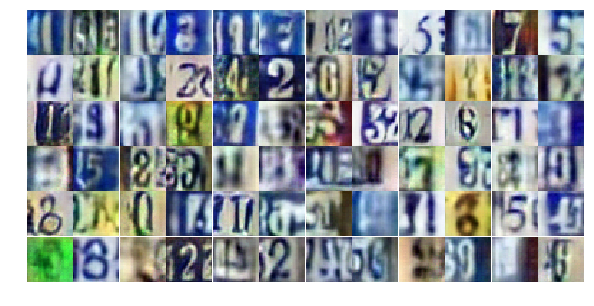

Batch 488    Epoch 15/25    Discriminator Loss: 1.2483... Generator Loss: 0.4770
Batch 498    Epoch 15/25    Discriminator Loss: 1.6128... Generator Loss: 0.2990
Batch 508    Epoch 15/25    Discriminator Loss: 0.6444... Generator Loss: 1.5307
Batch 518    Epoch 15/25    Discriminator Loss: 1.1060... Generator Loss: 1.0783
Batch 528    Epoch 15/25    Discriminator Loss: 0.9374... Generator Loss: 0.7578
Batch 538    Epoch 15/25    Discriminator Loss: 1.3099... Generator Loss: 1.3055
Batch 548    Epoch 15/25    Discriminator Loss: 1.2102... Generator Loss: 0.5500
Batch 558    Epoch 15/25    Discriminator Loss: 0.7100... Generator Loss: 1.0789
Batch 568    Epoch 15/25    Discriminator Loss: 1.5379... Generator Loss: 0.3409
Batch 5    Epoch 16/25    Discriminator Loss: 1.0697... Generator Loss: 0.6144


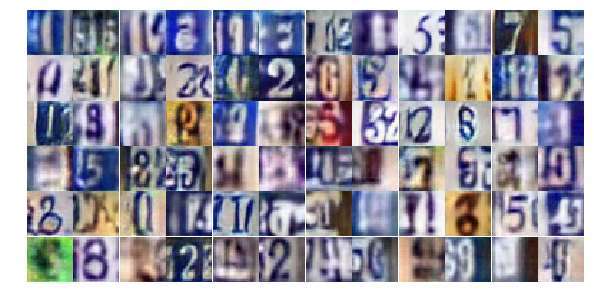

Batch 15    Epoch 16/25    Discriminator Loss: 0.6421... Generator Loss: 1.2278
Batch 25    Epoch 16/25    Discriminator Loss: 0.8748... Generator Loss: 0.8448
Batch 35    Epoch 16/25    Discriminator Loss: 1.5716... Generator Loss: 0.3067
Batch 45    Epoch 16/25    Discriminator Loss: 0.8304... Generator Loss: 1.0312
Batch 55    Epoch 16/25    Discriminator Loss: 0.9215... Generator Loss: 0.8163
Batch 65    Epoch 16/25    Discriminator Loss: 0.9659... Generator Loss: 0.6873
Batch 75    Epoch 16/25    Discriminator Loss: 2.0453... Generator Loss: 0.1960
Batch 85    Epoch 16/25    Discriminator Loss: 0.9933... Generator Loss: 0.6934
Batch 95    Epoch 16/25    Discriminator Loss: 0.8676... Generator Loss: 0.7643
Batch 105    Epoch 16/25    Discriminator Loss: 0.8788... Generator Loss: 0.7508


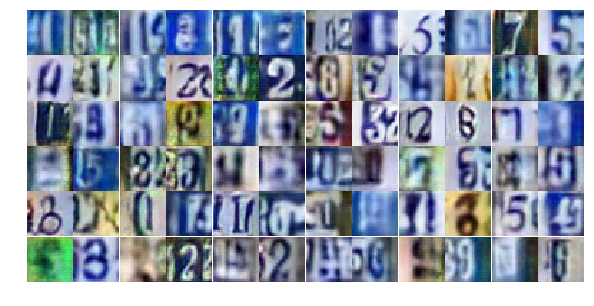

Batch 115    Epoch 16/25    Discriminator Loss: 1.4984... Generator Loss: 0.3275
Batch 125    Epoch 16/25    Discriminator Loss: 0.8522... Generator Loss: 0.7812
Batch 135    Epoch 16/25    Discriminator Loss: 2.2511... Generator Loss: 0.1749
Batch 145    Epoch 16/25    Discriminator Loss: 2.0022... Generator Loss: 0.7399
Batch 155    Epoch 16/25    Discriminator Loss: 0.8433... Generator Loss: 1.6265
Batch 165    Epoch 16/25    Discriminator Loss: 0.7871... Generator Loss: 1.0257
Batch 175    Epoch 16/25    Discriminator Loss: 1.5051... Generator Loss: 0.3689
Batch 185    Epoch 16/25    Discriminator Loss: 0.6722... Generator Loss: 1.1451
Batch 195    Epoch 16/25    Discriminator Loss: 0.6785... Generator Loss: 1.1219
Batch 205    Epoch 16/25    Discriminator Loss: 0.6556... Generator Loss: 1.1554


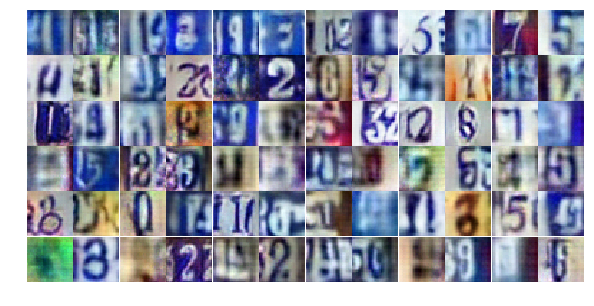

Batch 215    Epoch 16/25    Discriminator Loss: 0.8918... Generator Loss: 0.8111
Batch 225    Epoch 16/25    Discriminator Loss: 0.9246... Generator Loss: 0.7709
Batch 235    Epoch 16/25    Discriminator Loss: 0.9342... Generator Loss: 0.9024
Batch 245    Epoch 16/25    Discriminator Loss: 0.9764... Generator Loss: 0.6417
Batch 255    Epoch 16/25    Discriminator Loss: 0.9617... Generator Loss: 1.2157
Batch 265    Epoch 16/25    Discriminator Loss: 0.8713... Generator Loss: 0.8350
Batch 275    Epoch 16/25    Discriminator Loss: 0.8904... Generator Loss: 0.7912
Batch 285    Epoch 16/25    Discriminator Loss: 0.7886... Generator Loss: 0.9392
Batch 295    Epoch 16/25    Discriminator Loss: 0.9438... Generator Loss: 1.0337
Batch 305    Epoch 16/25    Discriminator Loss: 1.0231... Generator Loss: 0.6127


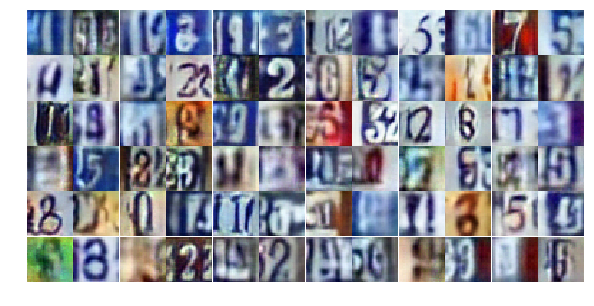

Batch 315    Epoch 16/25    Discriminator Loss: 0.7863... Generator Loss: 0.8595
Batch 325    Epoch 16/25    Discriminator Loss: 0.7024... Generator Loss: 0.9899
Batch 335    Epoch 16/25    Discriminator Loss: 0.6279... Generator Loss: 1.1160
Batch 345    Epoch 16/25    Discriminator Loss: 0.7179... Generator Loss: 1.1003
Batch 355    Epoch 16/25    Discriminator Loss: 1.1077... Generator Loss: 0.7888
Batch 365    Epoch 16/25    Discriminator Loss: 0.7898... Generator Loss: 1.7320
Batch 375    Epoch 16/25    Discriminator Loss: 1.0034... Generator Loss: 0.6433
Batch 385    Epoch 16/25    Discriminator Loss: 1.1429... Generator Loss: 0.5513
Batch 395    Epoch 16/25    Discriminator Loss: 0.8373... Generator Loss: 0.9434
Batch 405    Epoch 16/25    Discriminator Loss: 0.6096... Generator Loss: 1.5194


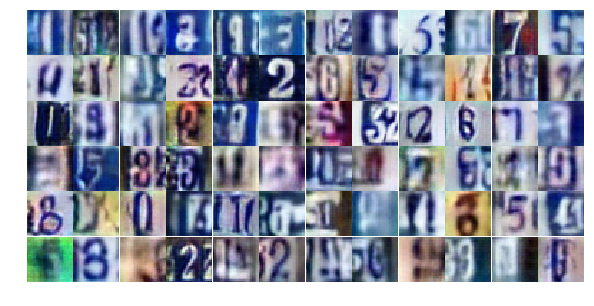

Batch 415    Epoch 16/25    Discriminator Loss: 0.7117... Generator Loss: 1.1183
Batch 425    Epoch 16/25    Discriminator Loss: 0.8037... Generator Loss: 1.1243
Batch 435    Epoch 16/25    Discriminator Loss: 1.3669... Generator Loss: 0.3885
Batch 445    Epoch 16/25    Discriminator Loss: 1.3555... Generator Loss: 0.3830
Batch 455    Epoch 16/25    Discriminator Loss: 0.8881... Generator Loss: 1.0128
Batch 465    Epoch 16/25    Discriminator Loss: 1.0176... Generator Loss: 0.6840
Batch 475    Epoch 16/25    Discriminator Loss: 0.6671... Generator Loss: 1.6394
Batch 485    Epoch 16/25    Discriminator Loss: 1.1620... Generator Loss: 0.5785
Batch 495    Epoch 16/25    Discriminator Loss: 0.7550... Generator Loss: 0.9033
Batch 505    Epoch 16/25    Discriminator Loss: 0.9946... Generator Loss: 0.6724


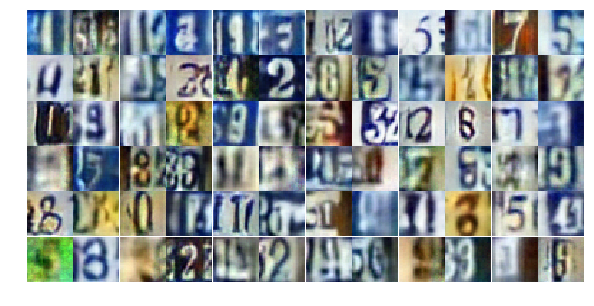

Batch 515    Epoch 16/25    Discriminator Loss: 1.0212... Generator Loss: 0.8483
Batch 525    Epoch 16/25    Discriminator Loss: 0.6753... Generator Loss: 1.2699
Batch 535    Epoch 16/25    Discriminator Loss: 1.5754... Generator Loss: 0.3443
Batch 545    Epoch 16/25    Discriminator Loss: 0.6360... Generator Loss: 1.3085
Batch 555    Epoch 16/25    Discriminator Loss: 0.4913... Generator Loss: 1.5134
Batch 565    Epoch 16/25    Discriminator Loss: 0.7565... Generator Loss: 1.1236
Batch 2    Epoch 17/25    Discriminator Loss: 0.7972... Generator Loss: 0.8364
Batch 12    Epoch 17/25    Discriminator Loss: 1.0604... Generator Loss: 0.6194
Batch 22    Epoch 17/25    Discriminator Loss: 0.8147... Generator Loss: 0.8830
Batch 32    Epoch 17/25    Discriminator Loss: 0.9528... Generator Loss: 0.6886


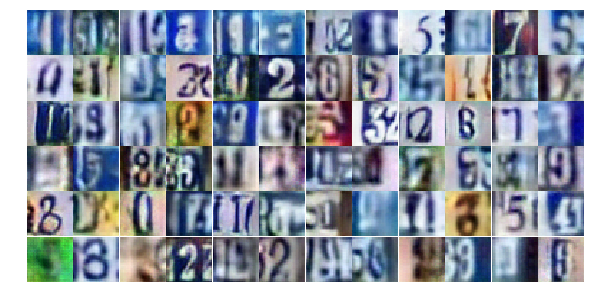

Batch 42    Epoch 17/25    Discriminator Loss: 0.5892... Generator Loss: 1.2787
Batch 52    Epoch 17/25    Discriminator Loss: 0.9011... Generator Loss: 0.7780
Batch 62    Epoch 17/25    Discriminator Loss: 1.0179... Generator Loss: 0.7537
Batch 72    Epoch 17/25    Discriminator Loss: 0.8301... Generator Loss: 0.9069
Batch 82    Epoch 17/25    Discriminator Loss: 1.0688... Generator Loss: 0.6915
Batch 92    Epoch 17/25    Discriminator Loss: 1.1680... Generator Loss: 0.5342
Batch 102    Epoch 17/25    Discriminator Loss: 0.8520... Generator Loss: 1.3773
Batch 112    Epoch 17/25    Discriminator Loss: 1.3046... Generator Loss: 0.4414
Batch 122    Epoch 17/25    Discriminator Loss: 0.6556... Generator Loss: 1.2029
Batch 132    Epoch 17/25    Discriminator Loss: 0.8586... Generator Loss: 1.0046


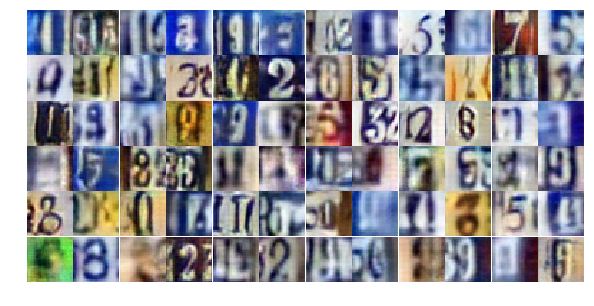

Batch 142    Epoch 17/25    Discriminator Loss: 1.0983... Generator Loss: 0.6155
Batch 152    Epoch 17/25    Discriminator Loss: 0.8906... Generator Loss: 1.2765
Batch 162    Epoch 17/25    Discriminator Loss: 0.7335... Generator Loss: 0.9905
Batch 172    Epoch 17/25    Discriminator Loss: 0.8907... Generator Loss: 0.8265
Batch 182    Epoch 17/25    Discriminator Loss: 0.7195... Generator Loss: 1.1908
Batch 192    Epoch 17/25    Discriminator Loss: 1.1276... Generator Loss: 0.5333
Batch 202    Epoch 17/25    Discriminator Loss: 0.8946... Generator Loss: 1.0838
Batch 212    Epoch 17/25    Discriminator Loss: 0.8771... Generator Loss: 0.7645
Batch 222    Epoch 17/25    Discriminator Loss: 0.7232... Generator Loss: 1.1196
Batch 232    Epoch 17/25    Discriminator Loss: 0.6466... Generator Loss: 1.3603


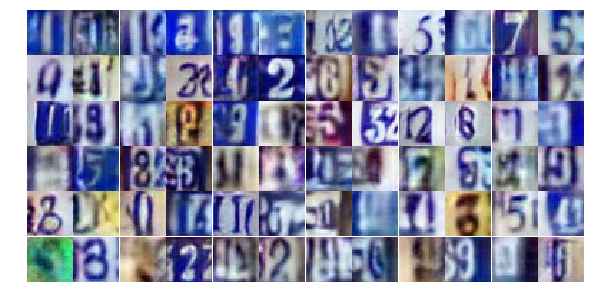

Batch 242    Epoch 17/25    Discriminator Loss: 1.4518... Generator Loss: 0.4136
Batch 252    Epoch 17/25    Discriminator Loss: 0.5728... Generator Loss: 1.4953
Batch 262    Epoch 17/25    Discriminator Loss: 0.6661... Generator Loss: 1.2911
Batch 272    Epoch 17/25    Discriminator Loss: 1.4486... Generator Loss: 0.3952
Batch 282    Epoch 17/25    Discriminator Loss: 1.6052... Generator Loss: 0.2990
Batch 292    Epoch 17/25    Discriminator Loss: 0.8518... Generator Loss: 0.8100
Batch 302    Epoch 17/25    Discriminator Loss: 0.8939... Generator Loss: 1.0001
Batch 312    Epoch 17/25    Discriminator Loss: 1.0176... Generator Loss: 0.6445
Batch 322    Epoch 17/25    Discriminator Loss: 0.8016... Generator Loss: 1.0682
Batch 332    Epoch 17/25    Discriminator Loss: 0.5309... Generator Loss: 1.6941


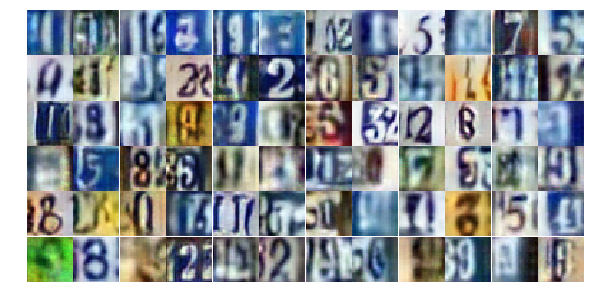

Batch 342    Epoch 17/25    Discriminator Loss: 0.9608... Generator Loss: 0.8770
Batch 352    Epoch 17/25    Discriminator Loss: 1.4104... Generator Loss: 0.4290
Batch 362    Epoch 17/25    Discriminator Loss: 0.9018... Generator Loss: 1.1957
Batch 372    Epoch 17/25    Discriminator Loss: 0.8168... Generator Loss: 1.1086
Batch 382    Epoch 17/25    Discriminator Loss: 0.6458... Generator Loss: 1.1931
Batch 392    Epoch 17/25    Discriminator Loss: 0.7121... Generator Loss: 1.3191
Batch 402    Epoch 17/25    Discriminator Loss: 0.8491... Generator Loss: 0.9279
Batch 412    Epoch 17/25    Discriminator Loss: 0.7023... Generator Loss: 1.1785
Batch 422    Epoch 17/25    Discriminator Loss: 0.3977... Generator Loss: 1.8750
Batch 432    Epoch 17/25    Discriminator Loss: 1.1353... Generator Loss: 0.5426


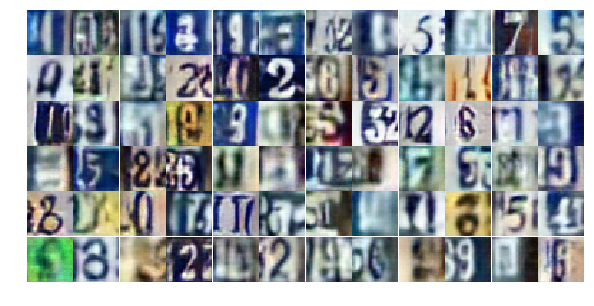

Batch 442    Epoch 17/25    Discriminator Loss: 1.1252... Generator Loss: 0.8257
Batch 452    Epoch 17/25    Discriminator Loss: 0.5520... Generator Loss: 1.3063
Batch 462    Epoch 17/25    Discriminator Loss: 1.2466... Generator Loss: 1.7622
Batch 472    Epoch 17/25    Discriminator Loss: 0.5221... Generator Loss: 1.4658
Batch 482    Epoch 17/25    Discriminator Loss: 0.8285... Generator Loss: 0.8948
Batch 492    Epoch 17/25    Discriminator Loss: 1.0868... Generator Loss: 0.6175
Batch 502    Epoch 17/25    Discriminator Loss: 1.1611... Generator Loss: 0.5280
Batch 512    Epoch 17/25    Discriminator Loss: 0.6753... Generator Loss: 1.1969
Batch 522    Epoch 17/25    Discriminator Loss: 1.0152... Generator Loss: 0.5976
Batch 532    Epoch 17/25    Discriminator Loss: 1.6451... Generator Loss: 0.2913


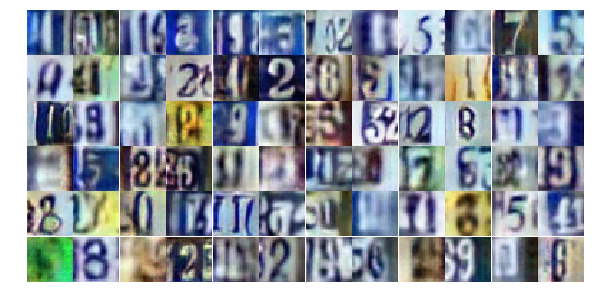

Batch 542    Epoch 17/25    Discriminator Loss: 1.5195... Generator Loss: 0.3927
Batch 552    Epoch 17/25    Discriminator Loss: 1.1868... Generator Loss: 0.6029
Batch 562    Epoch 17/25    Discriminator Loss: 0.7531... Generator Loss: 1.3923
Batch 572    Epoch 17/25    Discriminator Loss: 0.9964... Generator Loss: 0.6981
Batch 9    Epoch 18/25    Discriminator Loss: 1.1118... Generator Loss: 0.5898
Batch 19    Epoch 18/25    Discriminator Loss: 1.1782... Generator Loss: 0.5338
Batch 29    Epoch 18/25    Discriminator Loss: 0.9060... Generator Loss: 0.8107
Batch 39    Epoch 18/25    Discriminator Loss: 0.8443... Generator Loss: 0.8203
Batch 49    Epoch 18/25    Discriminator Loss: 0.8423... Generator Loss: 1.0279
Batch 59    Epoch 18/25    Discriminator Loss: 1.0900... Generator Loss: 1.5620


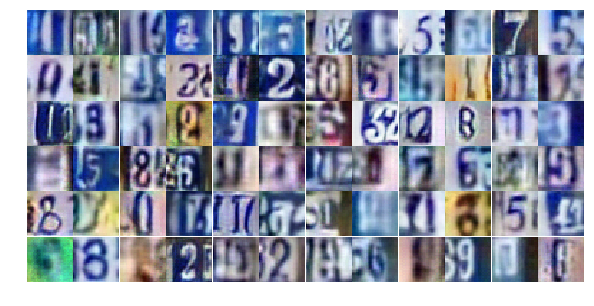

Batch 69    Epoch 18/25    Discriminator Loss: 0.6963... Generator Loss: 1.1409
Batch 79    Epoch 18/25    Discriminator Loss: 1.0011... Generator Loss: 0.7870
Batch 89    Epoch 18/25    Discriminator Loss: 0.8371... Generator Loss: 0.8953
Batch 99    Epoch 18/25    Discriminator Loss: 0.5532... Generator Loss: 1.3009
Batch 109    Epoch 18/25    Discriminator Loss: 0.8950... Generator Loss: 1.1225
Batch 119    Epoch 18/25    Discriminator Loss: 1.2020... Generator Loss: 0.4855
Batch 129    Epoch 18/25    Discriminator Loss: 0.5732... Generator Loss: 1.2858
Batch 139    Epoch 18/25    Discriminator Loss: 1.0331... Generator Loss: 0.6650
Batch 149    Epoch 18/25    Discriminator Loss: 0.7410... Generator Loss: 1.3992
Batch 159    Epoch 18/25    Discriminator Loss: 0.4856... Generator Loss: 1.6510


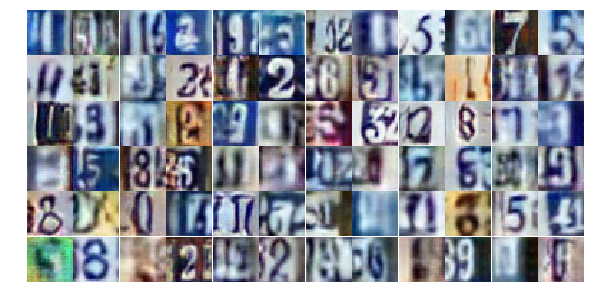

Batch 169    Epoch 18/25    Discriminator Loss: 1.0314... Generator Loss: 0.6772
Batch 179    Epoch 18/25    Discriminator Loss: 0.6253... Generator Loss: 1.5005
Batch 189    Epoch 18/25    Discriminator Loss: 0.9178... Generator Loss: 0.8580
Batch 199    Epoch 18/25    Discriminator Loss: 0.7224... Generator Loss: 1.0740
Batch 209    Epoch 18/25    Discriminator Loss: 0.9928... Generator Loss: 0.7275
Batch 219    Epoch 18/25    Discriminator Loss: 1.0813... Generator Loss: 0.7010
Batch 229    Epoch 18/25    Discriminator Loss: 0.9575... Generator Loss: 0.8294
Batch 239    Epoch 18/25    Discriminator Loss: 0.9190... Generator Loss: 0.7340
Batch 249    Epoch 18/25    Discriminator Loss: 0.7470... Generator Loss: 0.9778
Batch 259    Epoch 18/25    Discriminator Loss: 0.8900... Generator Loss: 0.8842


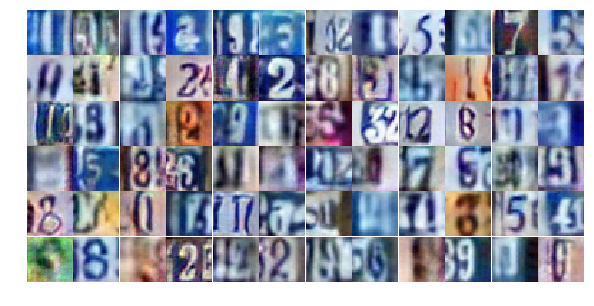

Batch 269    Epoch 18/25    Discriminator Loss: 0.7841... Generator Loss: 0.9290
Batch 279    Epoch 18/25    Discriminator Loss: 0.8974... Generator Loss: 0.8892
Batch 289    Epoch 18/25    Discriminator Loss: 1.1087... Generator Loss: 0.5874
Batch 299    Epoch 18/25    Discriminator Loss: 0.8327... Generator Loss: 0.8112
Batch 309    Epoch 18/25    Discriminator Loss: 1.2124... Generator Loss: 0.5224
Batch 319    Epoch 18/25    Discriminator Loss: 0.8864... Generator Loss: 0.8469
Batch 329    Epoch 18/25    Discriminator Loss: 1.1544... Generator Loss: 0.5478
Batch 339    Epoch 18/25    Discriminator Loss: 0.8348... Generator Loss: 0.7963
Batch 349    Epoch 18/25    Discriminator Loss: 0.7031... Generator Loss: 0.9806
Batch 359    Epoch 18/25    Discriminator Loss: 0.9502... Generator Loss: 0.7545


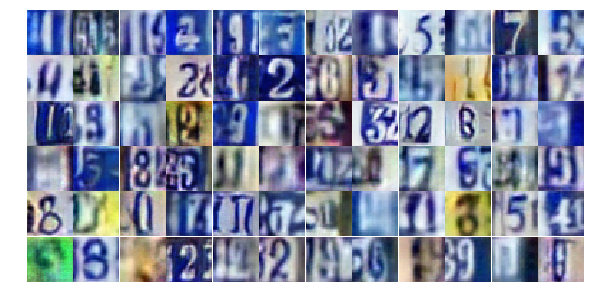

Batch 369    Epoch 18/25    Discriminator Loss: 1.3579... Generator Loss: 0.4208
Batch 379    Epoch 18/25    Discriminator Loss: 0.8350... Generator Loss: 0.9003
Batch 389    Epoch 18/25    Discriminator Loss: 0.6670... Generator Loss: 0.9526
Batch 399    Epoch 18/25    Discriminator Loss: 0.8655... Generator Loss: 0.8169
Batch 409    Epoch 18/25    Discriminator Loss: 1.4268... Generator Loss: 0.4288
Batch 419    Epoch 18/25    Discriminator Loss: 0.6696... Generator Loss: 1.0618
Batch 429    Epoch 18/25    Discriminator Loss: 0.9098... Generator Loss: 0.8355
Batch 439    Epoch 18/25    Discriminator Loss: 1.5808... Generator Loss: 1.9633
Batch 449    Epoch 18/25    Discriminator Loss: 2.1730... Generator Loss: 0.1861
Batch 459    Epoch 18/25    Discriminator Loss: 0.5399... Generator Loss: 1.3375


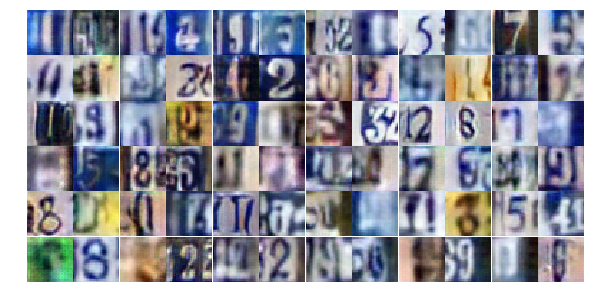

Batch 469    Epoch 18/25    Discriminator Loss: 0.7338... Generator Loss: 0.9635
Batch 479    Epoch 18/25    Discriminator Loss: 0.9771... Generator Loss: 0.6717
Batch 489    Epoch 18/25    Discriminator Loss: 1.1167... Generator Loss: 0.6713
Batch 499    Epoch 18/25    Discriminator Loss: 1.2468... Generator Loss: 0.5132
Batch 509    Epoch 18/25    Discriminator Loss: 1.4716... Generator Loss: 0.4045
Batch 519    Epoch 18/25    Discriminator Loss: 0.6406... Generator Loss: 1.6969
Batch 529    Epoch 18/25    Discriminator Loss: 0.7785... Generator Loss: 0.8909
Batch 539    Epoch 18/25    Discriminator Loss: 0.6070... Generator Loss: 1.1968
Batch 549    Epoch 18/25    Discriminator Loss: 1.0678... Generator Loss: 0.8994
Batch 559    Epoch 18/25    Discriminator Loss: 1.0311... Generator Loss: 0.6105


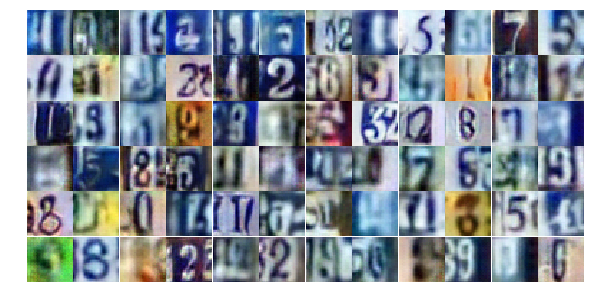

Batch 569    Epoch 18/25    Discriminator Loss: 0.6959... Generator Loss: 1.5997
Batch 6    Epoch 19/25    Discriminator Loss: 1.3203... Generator Loss: 0.4314
Batch 16    Epoch 19/25    Discriminator Loss: 1.2991... Generator Loss: 0.4660
Batch 26    Epoch 19/25    Discriminator Loss: 0.8404... Generator Loss: 0.9338
Batch 36    Epoch 19/25    Discriminator Loss: 0.7858... Generator Loss: 0.8676
Batch 46    Epoch 19/25    Discriminator Loss: 1.2178... Generator Loss: 0.5110
Batch 56    Epoch 19/25    Discriminator Loss: 0.6527... Generator Loss: 1.1419
Batch 66    Epoch 19/25    Discriminator Loss: 0.9798... Generator Loss: 0.7782
Batch 76    Epoch 19/25    Discriminator Loss: 0.9948... Generator Loss: 1.9866
Batch 86    Epoch 19/25    Discriminator Loss: 1.1713... Generator Loss: 0.5214


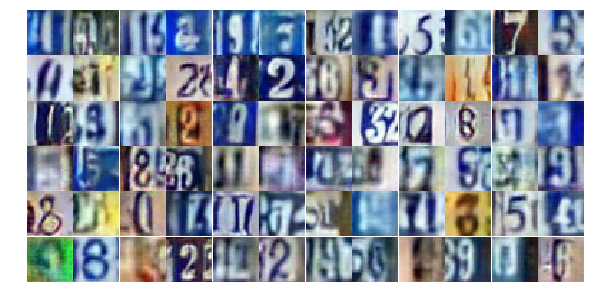

Batch 96    Epoch 19/25    Discriminator Loss: 0.9082... Generator Loss: 0.7230
Batch 106    Epoch 19/25    Discriminator Loss: 1.5069... Generator Loss: 0.3194
Batch 116    Epoch 19/25    Discriminator Loss: 0.8194... Generator Loss: 1.4845
Batch 126    Epoch 19/25    Discriminator Loss: 1.2438... Generator Loss: 0.4697
Batch 136    Epoch 19/25    Discriminator Loss: 1.3186... Generator Loss: 0.4593
Batch 146    Epoch 19/25    Discriminator Loss: 0.9252... Generator Loss: 0.8184
Batch 156    Epoch 19/25    Discriminator Loss: 0.7875... Generator Loss: 0.9848
Batch 166    Epoch 19/25    Discriminator Loss: 1.0277... Generator Loss: 0.6216
Batch 176    Epoch 19/25    Discriminator Loss: 0.8637... Generator Loss: 1.5526
Batch 186    Epoch 19/25    Discriminator Loss: 1.2521... Generator Loss: 0.5086


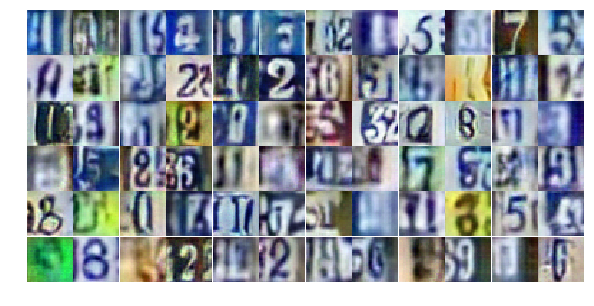

Batch 196    Epoch 19/25    Discriminator Loss: 1.0902... Generator Loss: 0.5434
Batch 206    Epoch 19/25    Discriminator Loss: 1.6845... Generator Loss: 0.3018
Batch 216    Epoch 19/25    Discriminator Loss: 1.6273... Generator Loss: 0.3294
Batch 226    Epoch 19/25    Discriminator Loss: 0.7574... Generator Loss: 1.0331
Batch 236    Epoch 19/25    Discriminator Loss: 1.0234... Generator Loss: 0.7946
Batch 246    Epoch 19/25    Discriminator Loss: 1.0851... Generator Loss: 0.7227
Batch 256    Epoch 19/25    Discriminator Loss: 0.7052... Generator Loss: 1.0717
Batch 266    Epoch 19/25    Discriminator Loss: 0.7148... Generator Loss: 1.0918
Batch 276    Epoch 19/25    Discriminator Loss: 0.8747... Generator Loss: 0.7272
Batch 286    Epoch 19/25    Discriminator Loss: 1.0161... Generator Loss: 0.6797


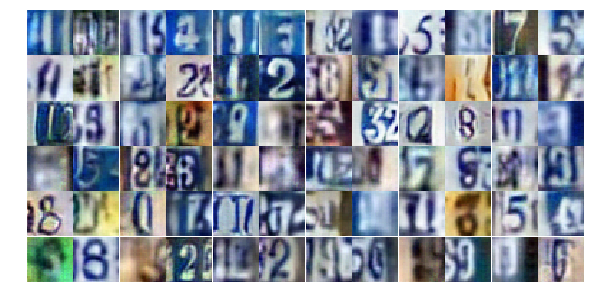

Batch 296    Epoch 19/25    Discriminator Loss: 1.1546... Generator Loss: 0.5962
Batch 306    Epoch 19/25    Discriminator Loss: 0.9658... Generator Loss: 0.6518
Batch 316    Epoch 19/25    Discriminator Loss: 0.8372... Generator Loss: 0.8364
Batch 326    Epoch 19/25    Discriminator Loss: 0.7316... Generator Loss: 0.9495
Batch 336    Epoch 19/25    Discriminator Loss: 0.7831... Generator Loss: 1.0502
Batch 346    Epoch 19/25    Discriminator Loss: 1.5712... Generator Loss: 0.3295
Batch 356    Epoch 19/25    Discriminator Loss: 1.0815... Generator Loss: 0.6184
Batch 366    Epoch 19/25    Discriminator Loss: 0.7179... Generator Loss: 0.9559
Batch 376    Epoch 19/25    Discriminator Loss: 0.9048... Generator Loss: 0.8972
Batch 386    Epoch 19/25    Discriminator Loss: 0.6638... Generator Loss: 1.3214


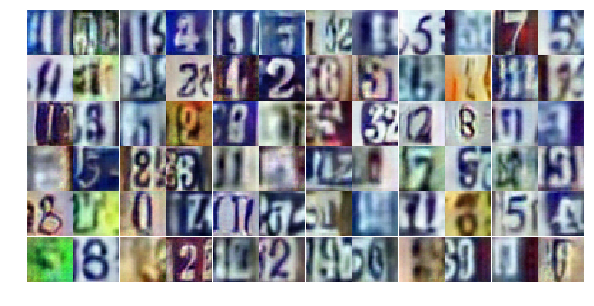

Batch 396    Epoch 19/25    Discriminator Loss: 0.6401... Generator Loss: 1.6617
Batch 406    Epoch 19/25    Discriminator Loss: 0.6625... Generator Loss: 1.1003
Batch 416    Epoch 19/25    Discriminator Loss: 1.2917... Generator Loss: 0.4326
Batch 426    Epoch 19/25    Discriminator Loss: 1.3311... Generator Loss: 0.4212
Batch 436    Epoch 19/25    Discriminator Loss: 1.2013... Generator Loss: 1.7564
Batch 446    Epoch 19/25    Discriminator Loss: 1.4892... Generator Loss: 0.4069
Batch 456    Epoch 19/25    Discriminator Loss: 1.1038... Generator Loss: 2.1633
Batch 466    Epoch 19/25    Discriminator Loss: 0.9467... Generator Loss: 0.8643
Batch 476    Epoch 19/25    Discriminator Loss: 0.7437... Generator Loss: 1.2283
Batch 486    Epoch 19/25    Discriminator Loss: 1.1211... Generator Loss: 0.6469


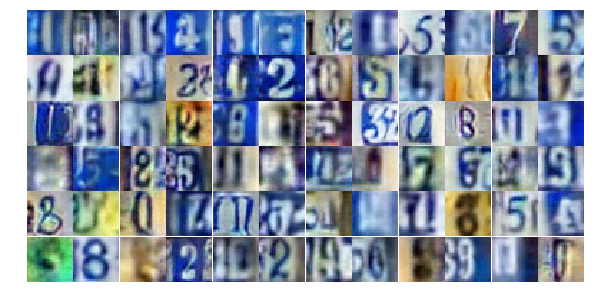

Batch 496    Epoch 19/25    Discriminator Loss: 0.8867... Generator Loss: 0.7130
Batch 506    Epoch 19/25    Discriminator Loss: 0.8885... Generator Loss: 1.0404
Batch 516    Epoch 19/25    Discriminator Loss: 0.9906... Generator Loss: 0.8533
Batch 526    Epoch 19/25    Discriminator Loss: 1.5432... Generator Loss: 0.3553
Batch 536    Epoch 19/25    Discriminator Loss: 1.1631... Generator Loss: 0.5909
Batch 546    Epoch 19/25    Discriminator Loss: 0.8498... Generator Loss: 0.8729
Batch 556    Epoch 19/25    Discriminator Loss: 1.6244... Generator Loss: 0.3103
Batch 566    Epoch 19/25    Discriminator Loss: 0.7260... Generator Loss: 1.2654
Batch 3    Epoch 20/25    Discriminator Loss: 1.2482... Generator Loss: 0.5166
Batch 13    Epoch 20/25    Discriminator Loss: 1.0437... Generator Loss: 0.7937


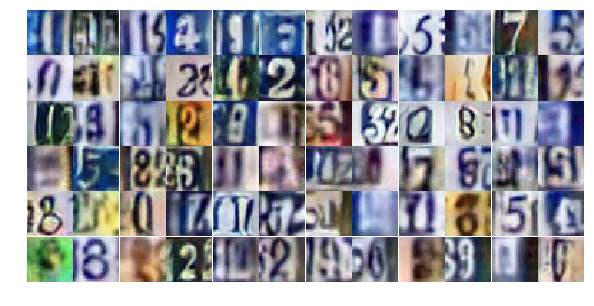

Batch 23    Epoch 20/25    Discriminator Loss: 0.8148... Generator Loss: 0.9068
Batch 33    Epoch 20/25    Discriminator Loss: 1.1197... Generator Loss: 0.5610
Batch 43    Epoch 20/25    Discriminator Loss: 1.3618... Generator Loss: 0.4149
Batch 53    Epoch 20/25    Discriminator Loss: 1.0712... Generator Loss: 0.6274
Batch 63    Epoch 20/25    Discriminator Loss: 0.6544... Generator Loss: 1.1662
Batch 73    Epoch 20/25    Discriminator Loss: 0.7261... Generator Loss: 1.0413
Batch 83    Epoch 20/25    Discriminator Loss: 0.8882... Generator Loss: 1.5346
Batch 93    Epoch 20/25    Discriminator Loss: 0.9023... Generator Loss: 1.1967
Batch 103    Epoch 20/25    Discriminator Loss: 1.2456... Generator Loss: 0.5502
Batch 113    Epoch 20/25    Discriminator Loss: 0.7247... Generator Loss: 0.9077


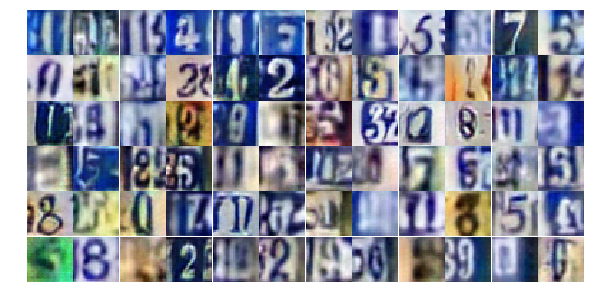

Batch 123    Epoch 20/25    Discriminator Loss: 1.6172... Generator Loss: 0.3211
Batch 133    Epoch 20/25    Discriminator Loss: 0.8993... Generator Loss: 0.8170
Batch 143    Epoch 20/25    Discriminator Loss: 1.1097... Generator Loss: 0.6203
Batch 153    Epoch 20/25    Discriminator Loss: 0.7815... Generator Loss: 1.9208
Batch 163    Epoch 20/25    Discriminator Loss: 0.9561... Generator Loss: 0.6721
Batch 173    Epoch 20/25    Discriminator Loss: 1.0220... Generator Loss: 0.7180
Batch 183    Epoch 20/25    Discriminator Loss: 1.6720... Generator Loss: 0.3209
Batch 193    Epoch 20/25    Discriminator Loss: 1.0459... Generator Loss: 0.6594
Batch 203    Epoch 20/25    Discriminator Loss: 0.8526... Generator Loss: 0.8476
Batch 213    Epoch 20/25    Discriminator Loss: 1.4341... Generator Loss: 0.4649


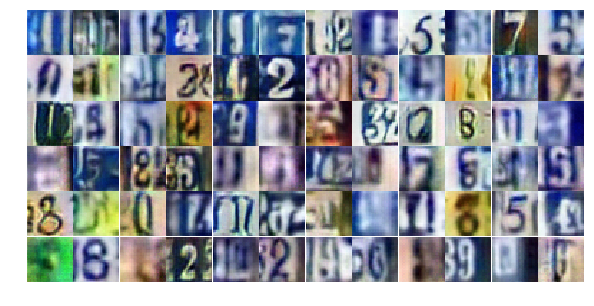

Batch 223    Epoch 20/25    Discriminator Loss: 0.7928... Generator Loss: 0.9515
Batch 233    Epoch 20/25    Discriminator Loss: 0.9908... Generator Loss: 0.6750
Batch 243    Epoch 20/25    Discriminator Loss: 0.4319... Generator Loss: 1.8113
Batch 253    Epoch 20/25    Discriminator Loss: 1.1355... Generator Loss: 0.5857
Batch 263    Epoch 20/25    Discriminator Loss: 1.2307... Generator Loss: 0.5519
Batch 273    Epoch 20/25    Discriminator Loss: 0.6511... Generator Loss: 1.7260
Batch 283    Epoch 20/25    Discriminator Loss: 0.8427... Generator Loss: 1.0006
Batch 293    Epoch 20/25    Discriminator Loss: 1.8263... Generator Loss: 0.2460
Batch 303    Epoch 20/25    Discriminator Loss: 1.4633... Generator Loss: 0.4064
Batch 313    Epoch 20/25    Discriminator Loss: 0.6739... Generator Loss: 0.9891


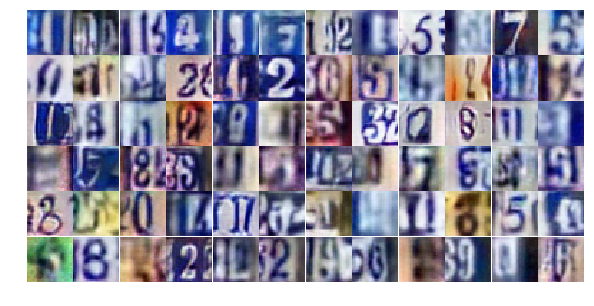

Batch 323    Epoch 20/25    Discriminator Loss: 0.7257... Generator Loss: 1.0969
Batch 333    Epoch 20/25    Discriminator Loss: 0.7783... Generator Loss: 0.8774
Batch 343    Epoch 20/25    Discriminator Loss: 1.5841... Generator Loss: 0.3431
Batch 353    Epoch 20/25    Discriminator Loss: 1.0655... Generator Loss: 0.8074
Batch 363    Epoch 20/25    Discriminator Loss: 0.9129... Generator Loss: 0.7875
Batch 373    Epoch 20/25    Discriminator Loss: 0.9751... Generator Loss: 0.7993
Batch 383    Epoch 20/25    Discriminator Loss: 0.9467... Generator Loss: 0.8484
Batch 393    Epoch 20/25    Discriminator Loss: 0.9146... Generator Loss: 1.4987
Batch 403    Epoch 20/25    Discriminator Loss: 0.8314... Generator Loss: 0.8922
Batch 413    Epoch 20/25    Discriminator Loss: 1.5611... Generator Loss: 0.3056


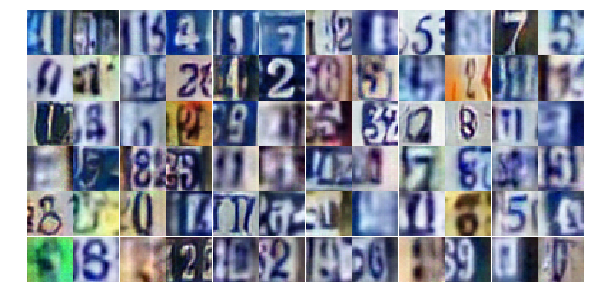

Batch 423    Epoch 20/25    Discriminator Loss: 1.2808... Generator Loss: 0.5205
Batch 433    Epoch 20/25    Discriminator Loss: 0.7967... Generator Loss: 0.9551
Batch 443    Epoch 20/25    Discriminator Loss: 0.7457... Generator Loss: 1.0448
Batch 453    Epoch 20/25    Discriminator Loss: 0.7913... Generator Loss: 1.0410
Batch 463    Epoch 20/25    Discriminator Loss: 1.0369... Generator Loss: 0.8323
Batch 473    Epoch 20/25    Discriminator Loss: 1.1952... Generator Loss: 0.5834
Batch 483    Epoch 20/25    Discriminator Loss: 1.2163... Generator Loss: 0.5301
Batch 493    Epoch 20/25    Discriminator Loss: 0.6608... Generator Loss: 1.4514
Batch 503    Epoch 20/25    Discriminator Loss: 0.9793... Generator Loss: 0.7320
Batch 513    Epoch 20/25    Discriminator Loss: 0.8331... Generator Loss: 0.7900


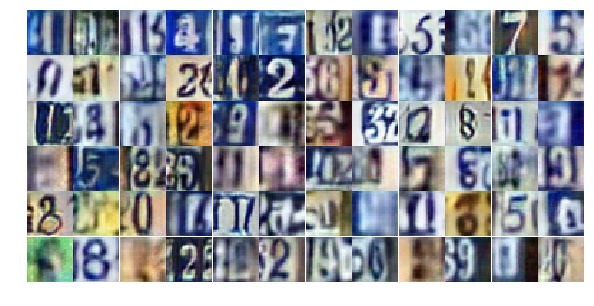

Batch 523    Epoch 20/25    Discriminator Loss: 0.9409... Generator Loss: 0.8050
Batch 533    Epoch 20/25    Discriminator Loss: 0.9111... Generator Loss: 0.9943
Batch 543    Epoch 20/25    Discriminator Loss: 0.5957... Generator Loss: 1.4877
Batch 553    Epoch 20/25    Discriminator Loss: 1.2142... Generator Loss: 0.5626
Batch 563    Epoch 20/25    Discriminator Loss: 0.8175... Generator Loss: 1.0088
Batch 573    Epoch 20/25    Discriminator Loss: 0.9411... Generator Loss: 0.7407
Batch 10    Epoch 21/25    Discriminator Loss: 1.2894... Generator Loss: 0.4889
Batch 20    Epoch 21/25    Discriminator Loss: 0.9733... Generator Loss: 0.7503
Batch 30    Epoch 21/25    Discriminator Loss: 1.6225... Generator Loss: 0.3363
Batch 40    Epoch 21/25    Discriminator Loss: 1.5736... Generator Loss: 0.3281


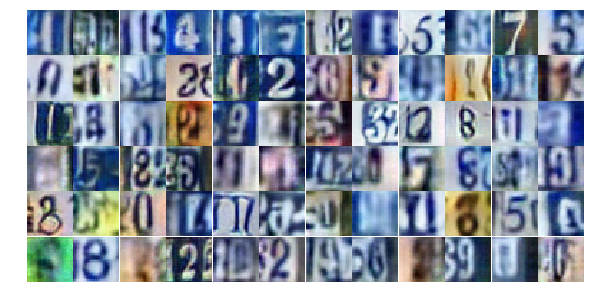

Batch 50    Epoch 21/25    Discriminator Loss: 0.5843... Generator Loss: 1.4792
Batch 60    Epoch 21/25    Discriminator Loss: 1.4686... Generator Loss: 0.3855
Batch 70    Epoch 21/25    Discriminator Loss: 0.6536... Generator Loss: 1.1529
Batch 80    Epoch 21/25    Discriminator Loss: 0.9905... Generator Loss: 2.5476
Batch 90    Epoch 21/25    Discriminator Loss: 0.8733... Generator Loss: 0.9378
Batch 100    Epoch 21/25    Discriminator Loss: 0.8081... Generator Loss: 0.8719
Batch 110    Epoch 21/25    Discriminator Loss: 0.8821... Generator Loss: 1.4771
Batch 120    Epoch 21/25    Discriminator Loss: 0.9895... Generator Loss: 0.8112
Batch 130    Epoch 21/25    Discriminator Loss: 0.7527... Generator Loss: 0.9302
Batch 140    Epoch 21/25    Discriminator Loss: 1.1008... Generator Loss: 0.5791


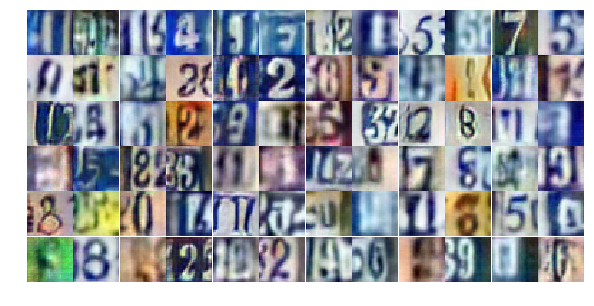

Batch 150    Epoch 21/25    Discriminator Loss: 0.4699... Generator Loss: 1.6893
Batch 160    Epoch 21/25    Discriminator Loss: 0.9955... Generator Loss: 0.7209
Batch 170    Epoch 21/25    Discriminator Loss: 2.1774... Generator Loss: 0.1769
Batch 180    Epoch 21/25    Discriminator Loss: 0.9643... Generator Loss: 0.7332
Batch 190    Epoch 21/25    Discriminator Loss: 0.6212... Generator Loss: 1.5006
Batch 200    Epoch 21/25    Discriminator Loss: 1.4994... Generator Loss: 0.3543
Batch 210    Epoch 21/25    Discriminator Loss: 1.1099... Generator Loss: 0.6822
Batch 220    Epoch 21/25    Discriminator Loss: 0.6919... Generator Loss: 1.1329
Batch 230    Epoch 21/25    Discriminator Loss: 0.6187... Generator Loss: 1.1287
Batch 240    Epoch 21/25    Discriminator Loss: 0.8598... Generator Loss: 0.8207


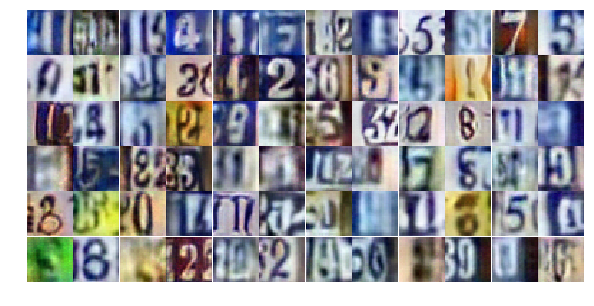

Batch 250    Epoch 21/25    Discriminator Loss: 1.0044... Generator Loss: 0.7208
Batch 260    Epoch 21/25    Discriminator Loss: 0.5132... Generator Loss: 1.4195
Batch 270    Epoch 21/25    Discriminator Loss: 1.0372... Generator Loss: 0.6115
Batch 280    Epoch 21/25    Discriminator Loss: 1.2610... Generator Loss: 0.4941
Batch 290    Epoch 21/25    Discriminator Loss: 0.9290... Generator Loss: 0.7230
Batch 300    Epoch 21/25    Discriminator Loss: 1.1389... Generator Loss: 0.6052
Batch 310    Epoch 21/25    Discriminator Loss: 0.7319... Generator Loss: 0.8979
Batch 320    Epoch 21/25    Discriminator Loss: 1.0758... Generator Loss: 0.6134
Batch 330    Epoch 21/25    Discriminator Loss: 0.9643... Generator Loss: 0.7204
Batch 340    Epoch 21/25    Discriminator Loss: 1.6914... Generator Loss: 0.3054


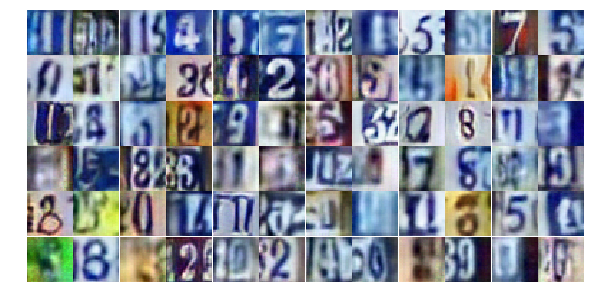

Batch 350    Epoch 21/25    Discriminator Loss: 1.2464... Generator Loss: 0.5291
Batch 360    Epoch 21/25    Discriminator Loss: 0.9909... Generator Loss: 0.7610
Batch 370    Epoch 21/25    Discriminator Loss: 1.2885... Generator Loss: 0.4439
Batch 380    Epoch 21/25    Discriminator Loss: 0.6094... Generator Loss: 1.1999
Batch 390    Epoch 21/25    Discriminator Loss: 0.7489... Generator Loss: 1.0355
Batch 400    Epoch 21/25    Discriminator Loss: 0.9520... Generator Loss: 1.0908
Batch 410    Epoch 21/25    Discriminator Loss: 1.5056... Generator Loss: 0.3364
Batch 420    Epoch 21/25    Discriminator Loss: 1.6782... Generator Loss: 0.2883
Batch 430    Epoch 21/25    Discriminator Loss: 1.0332... Generator Loss: 0.6623
Batch 440    Epoch 21/25    Discriminator Loss: 0.5763... Generator Loss: 1.8715


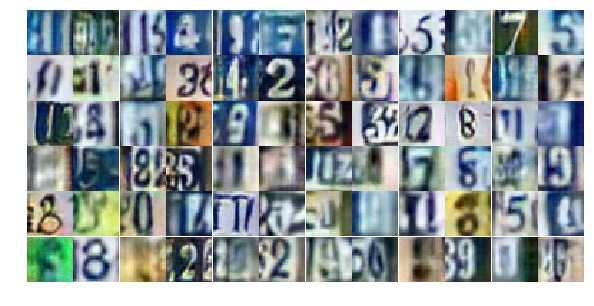

Batch 450    Epoch 21/25    Discriminator Loss: 1.0460... Generator Loss: 0.6132
Batch 460    Epoch 21/25    Discriminator Loss: 1.7735... Generator Loss: 0.2834
Batch 470    Epoch 21/25    Discriminator Loss: 1.4222... Generator Loss: 0.4961
Batch 480    Epoch 21/25    Discriminator Loss: 1.0876... Generator Loss: 0.6235
Batch 490    Epoch 21/25    Discriminator Loss: 0.5487... Generator Loss: 1.3752
Batch 500    Epoch 21/25    Discriminator Loss: 1.1712... Generator Loss: 0.6895
Batch 510    Epoch 21/25    Discriminator Loss: 1.2838... Generator Loss: 0.4681
Batch 520    Epoch 21/25    Discriminator Loss: 1.2643... Generator Loss: 0.5300
Batch 530    Epoch 21/25    Discriminator Loss: 1.3280... Generator Loss: 0.4984
Batch 540    Epoch 21/25    Discriminator Loss: 0.8447... Generator Loss: 0.8379


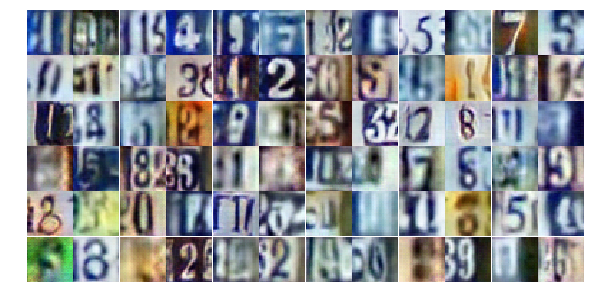

Batch 550    Epoch 21/25    Discriminator Loss: 0.8264... Generator Loss: 2.3169
Batch 560    Epoch 21/25    Discriminator Loss: 0.8494... Generator Loss: 1.0630
Batch 570    Epoch 21/25    Discriminator Loss: 0.7375... Generator Loss: 1.0552
Batch 7    Epoch 22/25    Discriminator Loss: 1.3835... Generator Loss: 1.7989
Batch 17    Epoch 22/25    Discriminator Loss: 1.1704... Generator Loss: 1.2013
Batch 27    Epoch 22/25    Discriminator Loss: 1.0231... Generator Loss: 0.6652
Batch 37    Epoch 22/25    Discriminator Loss: 0.7089... Generator Loss: 1.0634
Batch 47    Epoch 22/25    Discriminator Loss: 0.5005... Generator Loss: 1.6646
Batch 57    Epoch 22/25    Discriminator Loss: 1.4074... Generator Loss: 0.4096
Batch 67    Epoch 22/25    Discriminator Loss: 0.9862... Generator Loss: 0.6395


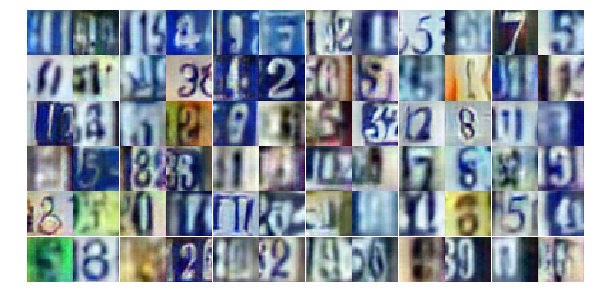

Batch 77    Epoch 22/25    Discriminator Loss: 0.7397... Generator Loss: 0.9948
Batch 87    Epoch 22/25    Discriminator Loss: 0.8635... Generator Loss: 1.1861
Batch 97    Epoch 22/25    Discriminator Loss: 1.1505... Generator Loss: 0.6278
Batch 107    Epoch 22/25    Discriminator Loss: 0.9125... Generator Loss: 0.9292
Batch 117    Epoch 22/25    Discriminator Loss: 1.7234... Generator Loss: 0.3179
Batch 127    Epoch 22/25    Discriminator Loss: 0.7778... Generator Loss: 1.0471
Batch 137    Epoch 22/25    Discriminator Loss: 0.8918... Generator Loss: 1.1285
Batch 147    Epoch 22/25    Discriminator Loss: 0.6447... Generator Loss: 1.1734
Batch 157    Epoch 22/25    Discriminator Loss: 1.1270... Generator Loss: 0.7906
Batch 167    Epoch 22/25    Discriminator Loss: 1.8482... Generator Loss: 0.2646


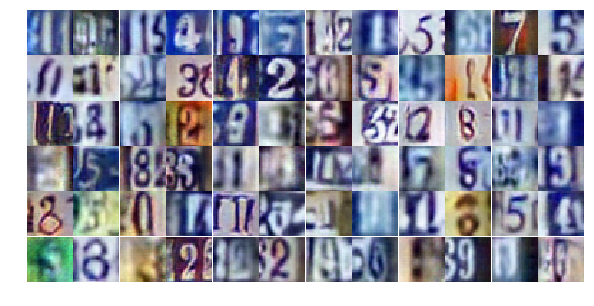

Batch 177    Epoch 22/25    Discriminator Loss: 0.5878... Generator Loss: 1.5040
Batch 187    Epoch 22/25    Discriminator Loss: 0.6461... Generator Loss: 1.0271
Batch 197    Epoch 22/25    Discriminator Loss: 1.4777... Generator Loss: 0.3577
Batch 207    Epoch 22/25    Discriminator Loss: 0.6678... Generator Loss: 0.9952
Batch 217    Epoch 22/25    Discriminator Loss: 0.6975... Generator Loss: 1.1308
Batch 227    Epoch 22/25    Discriminator Loss: 1.3154... Generator Loss: 0.4203
Batch 237    Epoch 22/25    Discriminator Loss: 0.7475... Generator Loss: 1.1141
Batch 247    Epoch 22/25    Discriminator Loss: 0.5543... Generator Loss: 1.4750
Batch 257    Epoch 22/25    Discriminator Loss: 0.8336... Generator Loss: 0.7702
Batch 267    Epoch 22/25    Discriminator Loss: 1.0782... Generator Loss: 0.6208


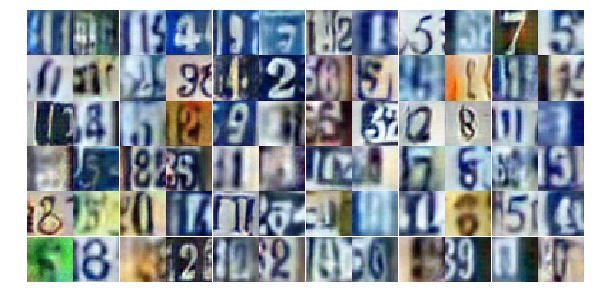

Batch 277    Epoch 22/25    Discriminator Loss: 0.4912... Generator Loss: 1.5942
Batch 287    Epoch 22/25    Discriminator Loss: 0.5269... Generator Loss: 1.6311
Batch 297    Epoch 22/25    Discriminator Loss: 1.0652... Generator Loss: 1.9565
Batch 307    Epoch 22/25    Discriminator Loss: 0.9622... Generator Loss: 0.7125
Batch 317    Epoch 22/25    Discriminator Loss: 0.9877... Generator Loss: 0.7848
Batch 327    Epoch 22/25    Discriminator Loss: 1.5546... Generator Loss: 0.3671
Batch 337    Epoch 22/25    Discriminator Loss: 1.9582... Generator Loss: 0.2187
Batch 347    Epoch 22/25    Discriminator Loss: 0.9565... Generator Loss: 0.8669
Batch 357    Epoch 22/25    Discriminator Loss: 1.4033... Generator Loss: 0.4152
Batch 367    Epoch 22/25    Discriminator Loss: 1.2698... Generator Loss: 0.4626


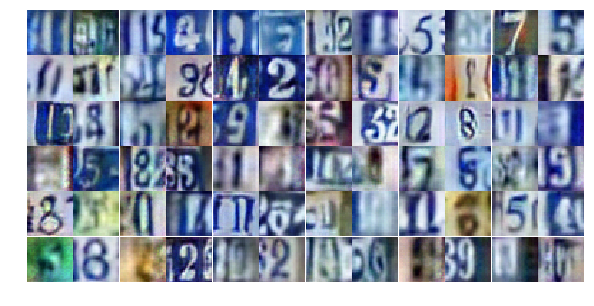

Batch 377    Epoch 22/25    Discriminator Loss: 0.9310... Generator Loss: 0.8682
Batch 387    Epoch 22/25    Discriminator Loss: 0.6816... Generator Loss: 1.1784
Batch 397    Epoch 22/25    Discriminator Loss: 0.4240... Generator Loss: 1.6052
Batch 407    Epoch 22/25    Discriminator Loss: 1.1057... Generator Loss: 0.6095
Batch 417    Epoch 22/25    Discriminator Loss: 0.6115... Generator Loss: 1.6041
Batch 427    Epoch 22/25    Discriminator Loss: 0.6545... Generator Loss: 1.1693
Batch 437    Epoch 22/25    Discriminator Loss: 1.2393... Generator Loss: 0.5414
Batch 447    Epoch 22/25    Discriminator Loss: 1.0297... Generator Loss: 0.6744
Batch 457    Epoch 22/25    Discriminator Loss: 1.0200... Generator Loss: 0.8153
Batch 467    Epoch 22/25    Discriminator Loss: 1.0886... Generator Loss: 0.6223


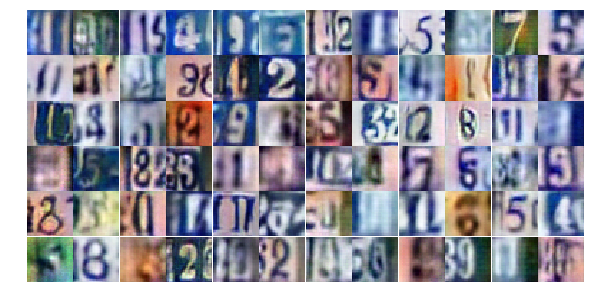

Batch 477    Epoch 22/25    Discriminator Loss: 1.4607... Generator Loss: 0.3853
Batch 487    Epoch 22/25    Discriminator Loss: 0.7471... Generator Loss: 1.4938
Batch 497    Epoch 22/25    Discriminator Loss: 0.8529... Generator Loss: 0.8589
Batch 507    Epoch 22/25    Discriminator Loss: 0.7774... Generator Loss: 1.1496
Batch 517    Epoch 22/25    Discriminator Loss: 0.9419... Generator Loss: 0.7673
Batch 527    Epoch 22/25    Discriminator Loss: 0.9941... Generator Loss: 1.6195
Batch 537    Epoch 22/25    Discriminator Loss: 1.0778... Generator Loss: 0.8518
Batch 547    Epoch 22/25    Discriminator Loss: 0.7875... Generator Loss: 0.9401
Batch 557    Epoch 22/25    Discriminator Loss: 0.9517... Generator Loss: 1.3486
Batch 567    Epoch 22/25    Discriminator Loss: 0.7458... Generator Loss: 0.9124


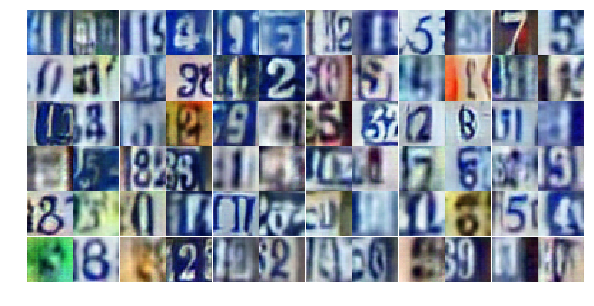

Batch 4    Epoch 23/25    Discriminator Loss: 0.6508... Generator Loss: 1.2128
Batch 14    Epoch 23/25    Discriminator Loss: 0.5280... Generator Loss: 1.2462
Batch 24    Epoch 23/25    Discriminator Loss: 1.2061... Generator Loss: 0.4978
Batch 34    Epoch 23/25    Discriminator Loss: 0.6536... Generator Loss: 1.2124
Batch 44    Epoch 23/25    Discriminator Loss: 1.2073... Generator Loss: 1.9537
Batch 54    Epoch 23/25    Discriminator Loss: 1.3793... Generator Loss: 0.4255
Batch 64    Epoch 23/25    Discriminator Loss: 1.3306... Generator Loss: 0.4387
Batch 74    Epoch 23/25    Discriminator Loss: 0.9303... Generator Loss: 0.7071
Batch 84    Epoch 23/25    Discriminator Loss: 1.0836... Generator Loss: 0.6382
Batch 94    Epoch 23/25    Discriminator Loss: 0.5653... Generator Loss: 1.3337


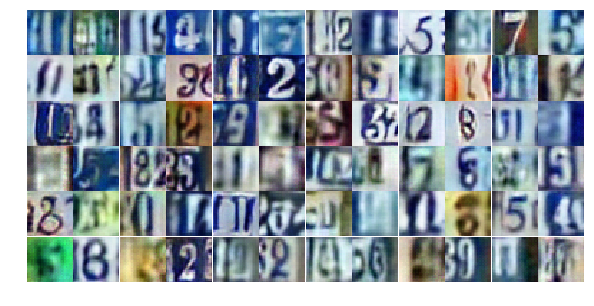

Batch 104    Epoch 23/25    Discriminator Loss: 0.8758... Generator Loss: 0.7518
Batch 114    Epoch 23/25    Discriminator Loss: 0.6834... Generator Loss: 1.1929
Batch 124    Epoch 23/25    Discriminator Loss: 0.9528... Generator Loss: 0.9571
Batch 134    Epoch 23/25    Discriminator Loss: 0.8150... Generator Loss: 0.8520
Batch 144    Epoch 23/25    Discriminator Loss: 0.6826... Generator Loss: 1.3389
Batch 154    Epoch 23/25    Discriminator Loss: 1.3203... Generator Loss: 0.4669
Batch 164    Epoch 23/25    Discriminator Loss: 0.9956... Generator Loss: 0.9074
Batch 174    Epoch 23/25    Discriminator Loss: 0.8288... Generator Loss: 1.1068
Batch 184    Epoch 23/25    Discriminator Loss: 0.8701... Generator Loss: 1.5754
Batch 194    Epoch 23/25    Discriminator Loss: 0.9690... Generator Loss: 0.8268


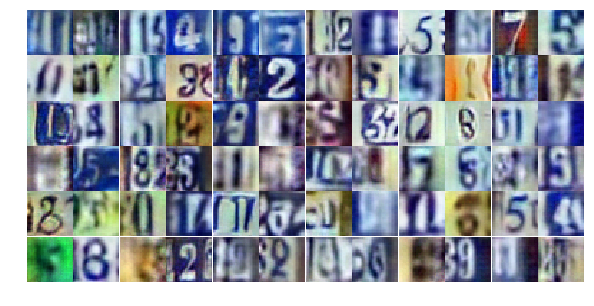

Batch 204    Epoch 23/25    Discriminator Loss: 0.9094... Generator Loss: 0.8075
Batch 214    Epoch 23/25    Discriminator Loss: 0.8365... Generator Loss: 1.0332
Batch 224    Epoch 23/25    Discriminator Loss: 1.7917... Generator Loss: 0.2729
Batch 234    Epoch 23/25    Discriminator Loss: 0.8248... Generator Loss: 0.8373
Batch 244    Epoch 23/25    Discriminator Loss: 0.6576... Generator Loss: 1.2566
Batch 254    Epoch 23/25    Discriminator Loss: 0.9466... Generator Loss: 0.8010
Batch 264    Epoch 23/25    Discriminator Loss: 1.0062... Generator Loss: 0.7089
Batch 274    Epoch 23/25    Discriminator Loss: 0.7364... Generator Loss: 1.3066
Batch 284    Epoch 23/25    Discriminator Loss: 0.8153... Generator Loss: 0.9370
Batch 294    Epoch 23/25    Discriminator Loss: 1.1322... Generator Loss: 2.0644


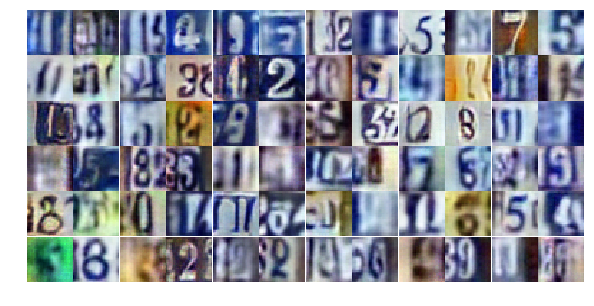

Batch 304    Epoch 23/25    Discriminator Loss: 0.8628... Generator Loss: 0.9087
Batch 314    Epoch 23/25    Discriminator Loss: 0.9942... Generator Loss: 0.7874
Batch 324    Epoch 23/25    Discriminator Loss: 0.6720... Generator Loss: 1.1845
Batch 334    Epoch 23/25    Discriminator Loss: 1.3761... Generator Loss: 0.4052
Batch 344    Epoch 23/25    Discriminator Loss: 1.4061... Generator Loss: 0.4040
Batch 354    Epoch 23/25    Discriminator Loss: 1.0214... Generator Loss: 0.7918
Batch 364    Epoch 23/25    Discriminator Loss: 1.4970... Generator Loss: 0.3932
Batch 374    Epoch 23/25    Discriminator Loss: 0.9388... Generator Loss: 0.7363
Batch 384    Epoch 23/25    Discriminator Loss: 0.6768... Generator Loss: 1.4110
Batch 394    Epoch 23/25    Discriminator Loss: 0.6709... Generator Loss: 1.0810


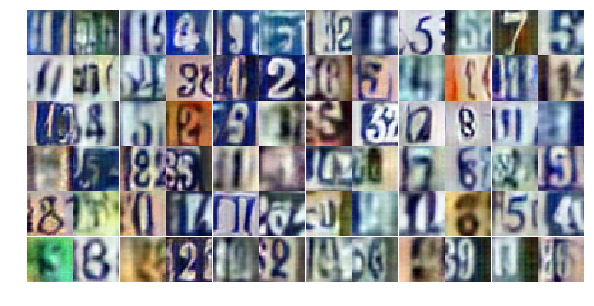

Batch 404    Epoch 23/25    Discriminator Loss: 1.0483... Generator Loss: 0.7408
Batch 414    Epoch 23/25    Discriminator Loss: 0.7539... Generator Loss: 1.6742
Batch 424    Epoch 23/25    Discriminator Loss: 1.1244... Generator Loss: 0.5796
Batch 434    Epoch 23/25    Discriminator Loss: 0.8947... Generator Loss: 1.0543
Batch 444    Epoch 23/25    Discriminator Loss: 1.1566... Generator Loss: 0.5741
Batch 454    Epoch 23/25    Discriminator Loss: 1.0098... Generator Loss: 0.6453
Batch 464    Epoch 23/25    Discriminator Loss: 0.7915... Generator Loss: 0.9523
Batch 474    Epoch 23/25    Discriminator Loss: 1.4019... Generator Loss: 0.3979
Batch 484    Epoch 23/25    Discriminator Loss: 0.9114... Generator Loss: 0.8117
Batch 494    Epoch 23/25    Discriminator Loss: 1.0204... Generator Loss: 0.7705


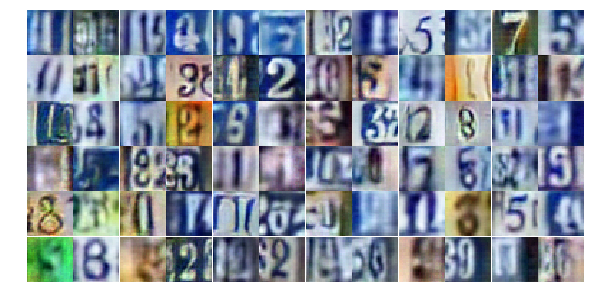

Batch 504    Epoch 23/25    Discriminator Loss: 0.8167... Generator Loss: 0.8823
Batch 514    Epoch 23/25    Discriminator Loss: 1.3681... Generator Loss: 0.4724
Batch 524    Epoch 23/25    Discriminator Loss: 1.8959... Generator Loss: 0.2194
Batch 534    Epoch 23/25    Discriminator Loss: 0.5263... Generator Loss: 1.3375
Batch 544    Epoch 23/25    Discriminator Loss: 1.5514... Generator Loss: 0.3516
Batch 554    Epoch 23/25    Discriminator Loss: 0.7841... Generator Loss: 0.9411
Batch 564    Epoch 23/25    Discriminator Loss: 0.9710... Generator Loss: 0.6574
Batch 1    Epoch 24/25    Discriminator Loss: 0.8522... Generator Loss: 0.8286
Batch 11    Epoch 24/25    Discriminator Loss: 1.0263... Generator Loss: 1.3473
Batch 21    Epoch 24/25    Discriminator Loss: 1.0477... Generator Loss: 0.7691


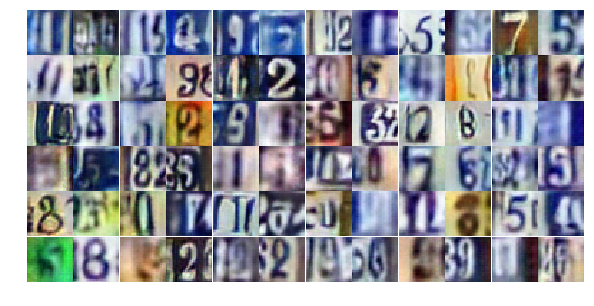

Batch 31    Epoch 24/25    Discriminator Loss: 0.7509... Generator Loss: 1.0165
Batch 41    Epoch 24/25    Discriminator Loss: 0.8496... Generator Loss: 1.0577
Batch 51    Epoch 24/25    Discriminator Loss: 1.0346... Generator Loss: 0.6281
Batch 61    Epoch 24/25    Discriminator Loss: 1.0172... Generator Loss: 0.9264
Batch 71    Epoch 24/25    Discriminator Loss: 0.8586... Generator Loss: 0.7868
Batch 81    Epoch 24/25    Discriminator Loss: 0.7241... Generator Loss: 1.0467
Batch 91    Epoch 24/25    Discriminator Loss: 0.7147... Generator Loss: 1.1477
Batch 101    Epoch 24/25    Discriminator Loss: 1.2162... Generator Loss: 0.4779
Batch 111    Epoch 24/25    Discriminator Loss: 0.7746... Generator Loss: 0.8197
Batch 121    Epoch 24/25    Discriminator Loss: 0.9521... Generator Loss: 0.7277


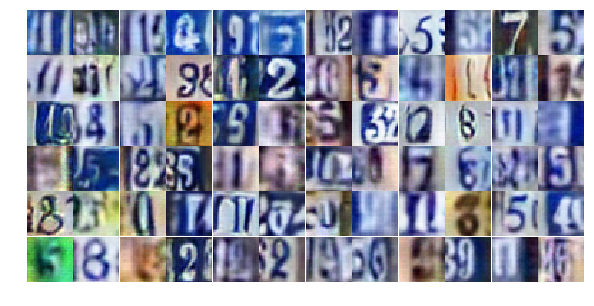

Batch 131    Epoch 24/25    Discriminator Loss: 1.5037... Generator Loss: 0.3892
Batch 141    Epoch 24/25    Discriminator Loss: 1.0133... Generator Loss: 0.6838
Batch 151    Epoch 24/25    Discriminator Loss: 1.1431... Generator Loss: 0.5982
Batch 161    Epoch 24/25    Discriminator Loss: 0.6479... Generator Loss: 1.0407
Batch 171    Epoch 24/25    Discriminator Loss: 1.0476... Generator Loss: 2.2614
Batch 181    Epoch 24/25    Discriminator Loss: 0.9578... Generator Loss: 0.8246
Batch 191    Epoch 24/25    Discriminator Loss: 0.6266... Generator Loss: 1.1362
Batch 201    Epoch 24/25    Discriminator Loss: 1.4022... Generator Loss: 0.4126
Batch 211    Epoch 24/25    Discriminator Loss: 0.8913... Generator Loss: 0.8708
Batch 221    Epoch 24/25    Discriminator Loss: 1.1797... Generator Loss: 0.5975


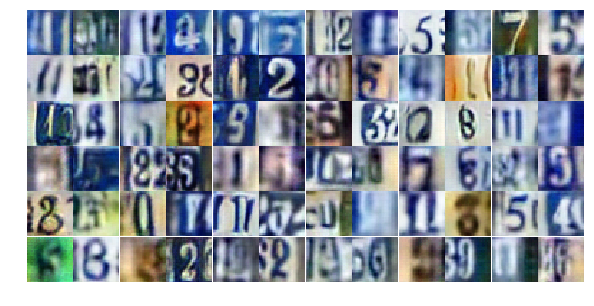

Batch 231    Epoch 24/25    Discriminator Loss: 1.1081... Generator Loss: 0.5937
Batch 241    Epoch 24/25    Discriminator Loss: 0.8578... Generator Loss: 0.8773
Batch 251    Epoch 24/25    Discriminator Loss: 0.7704... Generator Loss: 0.9571
Batch 261    Epoch 24/25    Discriminator Loss: 1.4770... Generator Loss: 0.4233
Batch 271    Epoch 24/25    Discriminator Loss: 0.6583... Generator Loss: 1.6408
Batch 281    Epoch 24/25    Discriminator Loss: 0.8492... Generator Loss: 0.7736
Batch 291    Epoch 24/25    Discriminator Loss: 0.7259... Generator Loss: 0.9108
Batch 301    Epoch 24/25    Discriminator Loss: 1.0149... Generator Loss: 0.7593
Batch 311    Epoch 24/25    Discriminator Loss: 0.6701... Generator Loss: 1.1110
Batch 321    Epoch 24/25    Discriminator Loss: 1.2993... Generator Loss: 0.6773


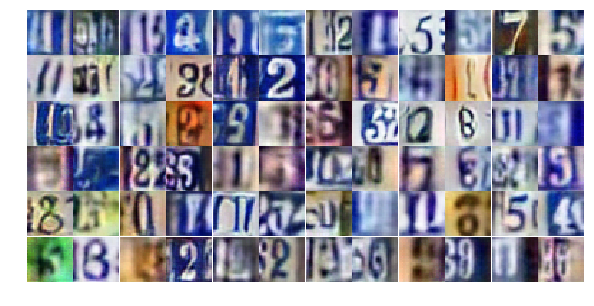

Batch 331    Epoch 24/25    Discriminator Loss: 0.6961... Generator Loss: 1.0832
Batch 341    Epoch 24/25    Discriminator Loss: 0.8200... Generator Loss: 0.8214
Batch 351    Epoch 24/25    Discriminator Loss: 0.9132... Generator Loss: 0.8185
Batch 361    Epoch 24/25    Discriminator Loss: 1.1383... Generator Loss: 0.8433
Batch 371    Epoch 24/25    Discriminator Loss: 1.4371... Generator Loss: 1.2187
Batch 381    Epoch 24/25    Discriminator Loss: 0.9452... Generator Loss: 0.7536
Batch 391    Epoch 24/25    Discriminator Loss: 1.2827... Generator Loss: 0.4973
Batch 401    Epoch 24/25    Discriminator Loss: 0.7549... Generator Loss: 0.9032
Batch 411    Epoch 24/25    Discriminator Loss: 0.9740... Generator Loss: 0.8679
Batch 421    Epoch 24/25    Discriminator Loss: 0.8052... Generator Loss: 0.9823


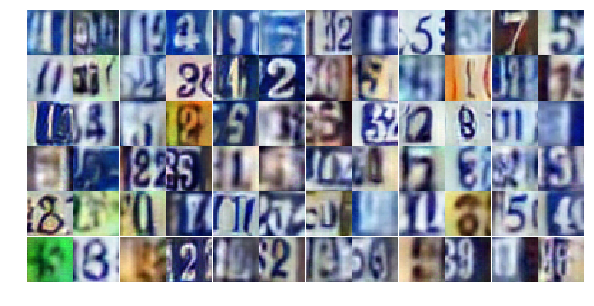

Batch 431    Epoch 24/25    Discriminator Loss: 0.9977... Generator Loss: 0.6891
Batch 441    Epoch 24/25    Discriminator Loss: 1.6205... Generator Loss: 0.3164
Batch 451    Epoch 24/25    Discriminator Loss: 1.4214... Generator Loss: 0.4418
Batch 461    Epoch 24/25    Discriminator Loss: 1.8346... Generator Loss: 0.2704
Batch 471    Epoch 24/25    Discriminator Loss: 1.6362... Generator Loss: 0.3577
Batch 481    Epoch 24/25    Discriminator Loss: 0.7320... Generator Loss: 1.0605
Batch 491    Epoch 24/25    Discriminator Loss: 1.1625... Generator Loss: 0.5568
Batch 501    Epoch 24/25    Discriminator Loss: 0.7162... Generator Loss: 1.2504
Batch 511    Epoch 24/25    Discriminator Loss: 0.9418... Generator Loss: 1.6824
Batch 521    Epoch 24/25    Discriminator Loss: 1.4747... Generator Loss: 0.9885


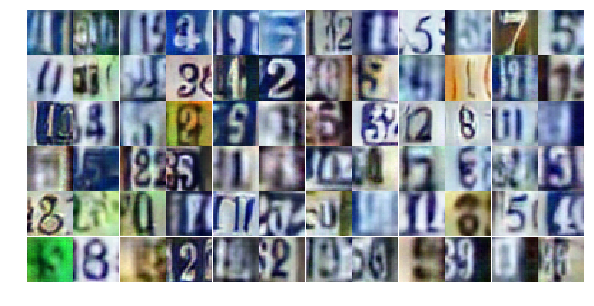

Batch 531    Epoch 24/25    Discriminator Loss: 1.0025... Generator Loss: 1.0035
Batch 541    Epoch 24/25    Discriminator Loss: 1.4395... Generator Loss: 0.3950
Batch 551    Epoch 24/25    Discriminator Loss: 1.1503... Generator Loss: 0.5914
Batch 561    Epoch 24/25    Discriminator Loss: 0.9185... Generator Loss: 1.2962
Batch 571    Epoch 24/25    Discriminator Loss: 1.5932... Generator Loss: 0.3700
Batch 8    Epoch 25/25    Discriminator Loss: 1.1185... Generator Loss: 0.5978
Batch 18    Epoch 25/25    Discriminator Loss: 0.7859... Generator Loss: 1.1703
Batch 28    Epoch 25/25    Discriminator Loss: 0.9431... Generator Loss: 0.7515
Batch 38    Epoch 25/25    Discriminator Loss: 0.9510... Generator Loss: 0.7033
Batch 48    Epoch 25/25    Discriminator Loss: 1.4291... Generator Loss: 0.4250


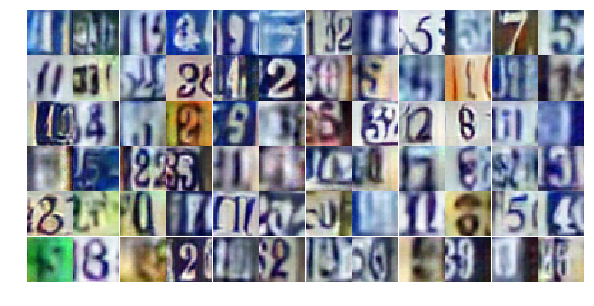

Batch 58    Epoch 25/25    Discriminator Loss: 1.2491... Generator Loss: 0.5246
Batch 68    Epoch 25/25    Discriminator Loss: 1.7660... Generator Loss: 0.2757
Batch 78    Epoch 25/25    Discriminator Loss: 1.1047... Generator Loss: 0.6116
Batch 88    Epoch 25/25    Discriminator Loss: 0.9094... Generator Loss: 0.8607
Batch 98    Epoch 25/25    Discriminator Loss: 0.9724... Generator Loss: 0.7971
Batch 108    Epoch 25/25    Discriminator Loss: 0.8970... Generator Loss: 0.8859
Batch 118    Epoch 25/25    Discriminator Loss: 1.4949... Generator Loss: 0.4321
Batch 128    Epoch 25/25    Discriminator Loss: 0.8499... Generator Loss: 1.6155
Batch 138    Epoch 25/25    Discriminator Loss: 0.7255... Generator Loss: 1.1821
Batch 148    Epoch 25/25    Discriminator Loss: 0.9346... Generator Loss: 0.7257


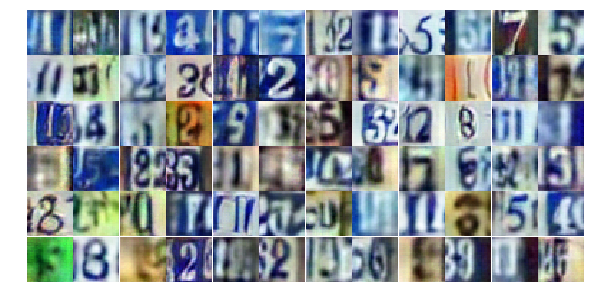

Batch 158    Epoch 25/25    Discriminator Loss: 0.7551... Generator Loss: 1.6719
Batch 168    Epoch 25/25    Discriminator Loss: 0.7556... Generator Loss: 1.1583
Batch 178    Epoch 25/25    Discriminator Loss: 1.4106... Generator Loss: 0.4064
Batch 188    Epoch 25/25    Discriminator Loss: 0.9678... Generator Loss: 0.7907
Batch 198    Epoch 25/25    Discriminator Loss: 0.7994... Generator Loss: 0.9929
Batch 208    Epoch 25/25    Discriminator Loss: 0.9779... Generator Loss: 0.8656
Batch 218    Epoch 25/25    Discriminator Loss: 0.9844... Generator Loss: 0.7653
Batch 228    Epoch 25/25    Discriminator Loss: 0.7872... Generator Loss: 1.2768
Batch 238    Epoch 25/25    Discriminator Loss: 0.6722... Generator Loss: 1.1383
Batch 248    Epoch 25/25    Discriminator Loss: 1.0499... Generator Loss: 0.6650


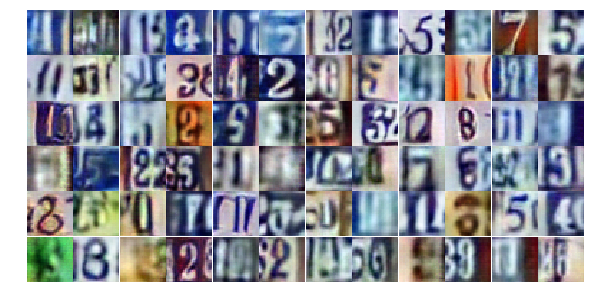

Batch 258    Epoch 25/25    Discriminator Loss: 1.0006... Generator Loss: 0.7384
Batch 268    Epoch 25/25    Discriminator Loss: 1.0791... Generator Loss: 0.6202
Batch 278    Epoch 25/25    Discriminator Loss: 1.9733... Generator Loss: 0.2183
Batch 288    Epoch 25/25    Discriminator Loss: 0.9896... Generator Loss: 0.6489
Batch 298    Epoch 25/25    Discriminator Loss: 1.0955... Generator Loss: 0.6286
Batch 308    Epoch 25/25    Discriminator Loss: 0.9980... Generator Loss: 0.7351
Batch 318    Epoch 25/25    Discriminator Loss: 1.3743... Generator Loss: 0.4835
Batch 328    Epoch 25/25    Discriminator Loss: 0.7774... Generator Loss: 1.0175
Batch 338    Epoch 25/25    Discriminator Loss: 1.0692... Generator Loss: 1.5587
Batch 348    Epoch 25/25    Discriminator Loss: 2.4854... Generator Loss: 0.3361


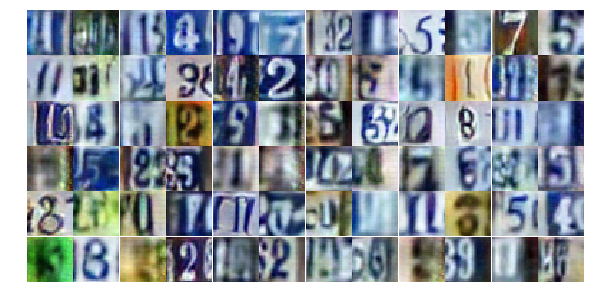

Batch 358    Epoch 25/25    Discriminator Loss: 0.8546... Generator Loss: 1.1068
Batch 368    Epoch 25/25    Discriminator Loss: 0.9644... Generator Loss: 0.7590
Batch 378    Epoch 25/25    Discriminator Loss: 0.8914... Generator Loss: 1.2389
Batch 388    Epoch 25/25    Discriminator Loss: 0.8658... Generator Loss: 0.8039
Batch 398    Epoch 25/25    Discriminator Loss: 1.3002... Generator Loss: 0.4591
Batch 408    Epoch 25/25    Discriminator Loss: 0.9457... Generator Loss: 0.7558
Batch 418    Epoch 25/25    Discriminator Loss: 0.6288... Generator Loss: 1.2621
Batch 428    Epoch 25/25    Discriminator Loss: 0.9579... Generator Loss: 0.6814
Batch 438    Epoch 25/25    Discriminator Loss: 1.7047... Generator Loss: 0.3164
Batch 448    Epoch 25/25    Discriminator Loss: 0.8107... Generator Loss: 0.8541


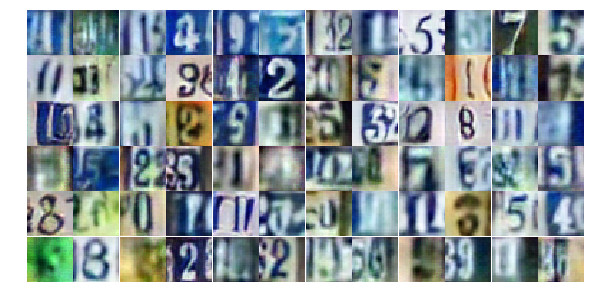

Batch 458    Epoch 25/25    Discriminator Loss: 0.9338... Generator Loss: 0.9414
Batch 468    Epoch 25/25    Discriminator Loss: 1.0012... Generator Loss: 0.6733
Batch 478    Epoch 25/25    Discriminator Loss: 0.9487... Generator Loss: 0.8281
Batch 488    Epoch 25/25    Discriminator Loss: 0.8957... Generator Loss: 0.7513
Batch 498    Epoch 25/25    Discriminator Loss: 1.2333... Generator Loss: 0.5495
Batch 508    Epoch 25/25    Discriminator Loss: 0.8221... Generator Loss: 0.8936
Batch 518    Epoch 25/25    Discriminator Loss: 0.9156... Generator Loss: 1.2489
Batch 528    Epoch 25/25    Discriminator Loss: 0.8707... Generator Loss: 0.8487
Batch 538    Epoch 25/25    Discriminator Loss: 0.9908... Generator Loss: 0.7337
Batch 548    Epoch 25/25    Discriminator Loss: 0.9914... Generator Loss: 0.7643


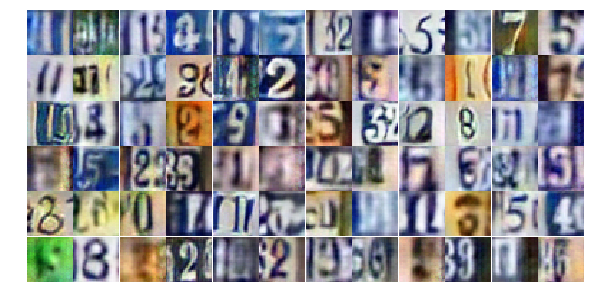

Batch 558    Epoch 25/25    Discriminator Loss: 0.8746... Generator Loss: 0.8522
Batch 568    Epoch 25/25    Discriminator Loss: 1.7655... Generator Loss: 0.2960


In [27]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

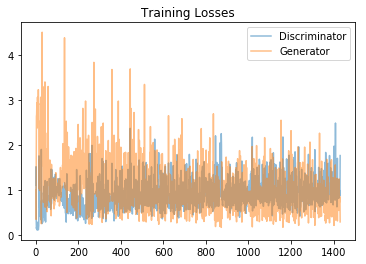

In [28]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

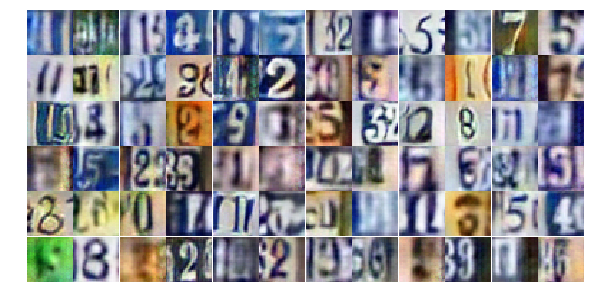

In [29]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))